In [2]:
import sys
# Hay que ejecutar esta línea antes de importar el módulo.
sys.path.append("C:/Users/poker/PycharmProjects/tgpy")
# Ahora se puede importar el módulo.
%reload_ext tgpy
import tgpy as tg
import numpy as np 
import torch


In [3]:
npriors = 3 # 1, 2, 3, 4
ngroups = 10 # any positive int
nparams = 300 # number of chains
niters = 300
nreview = 10

### Create Priors

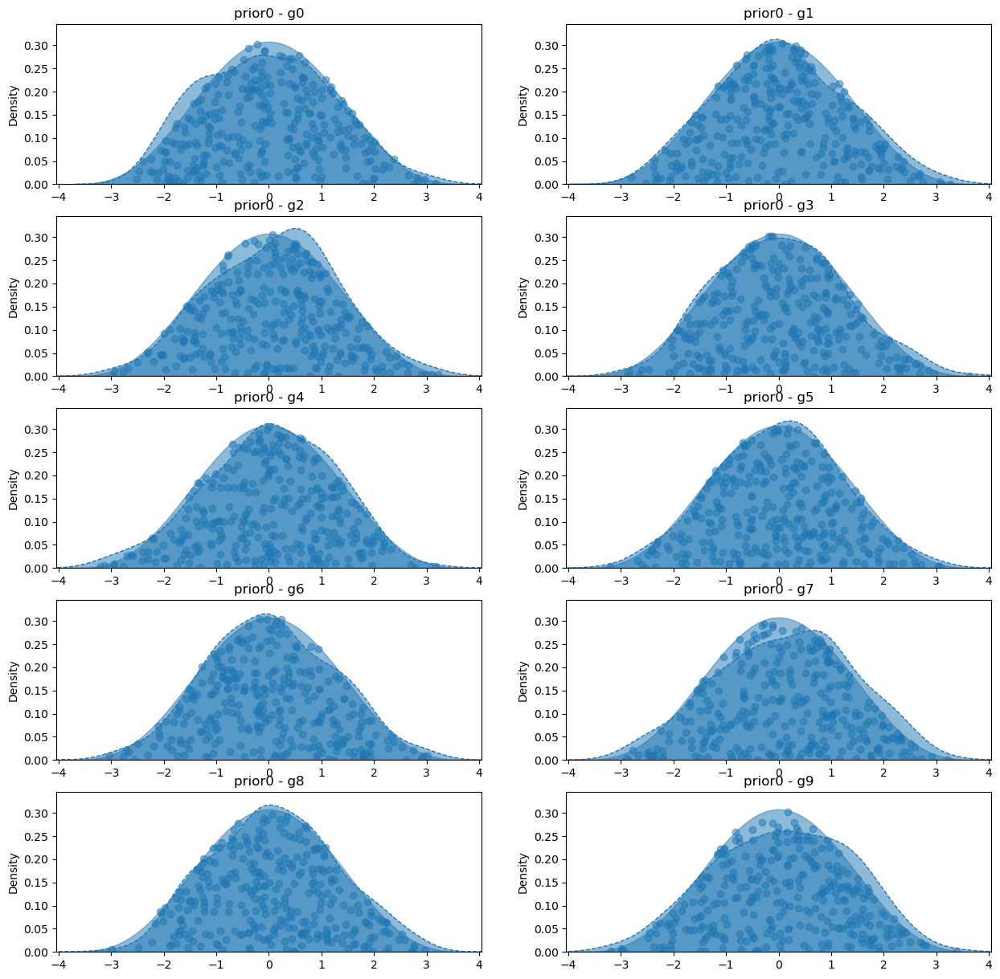

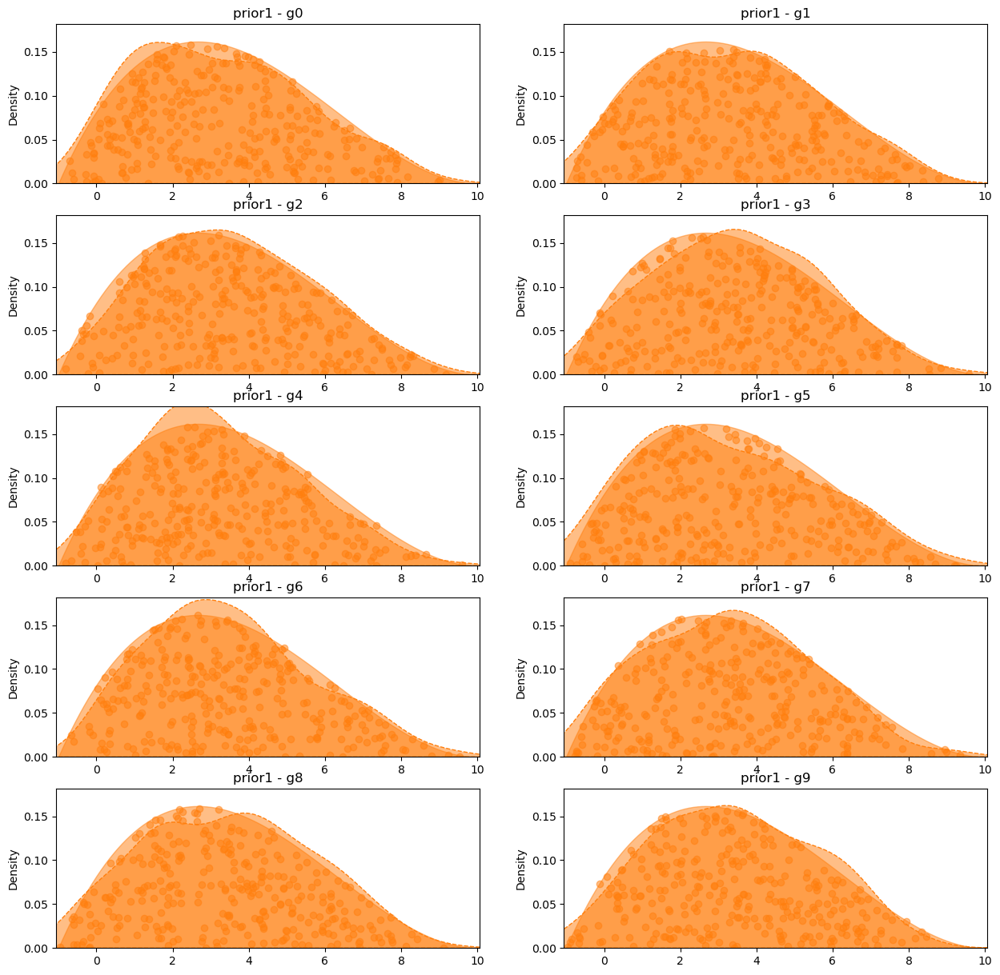

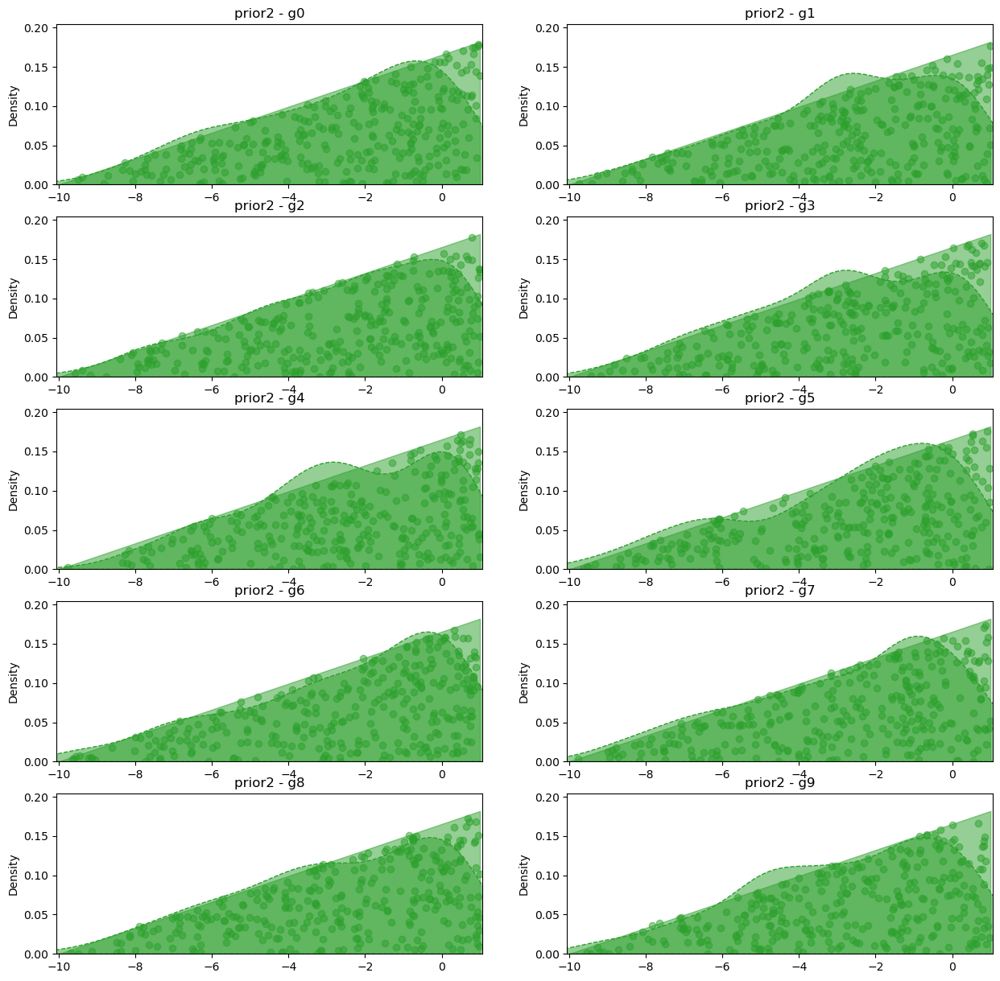

In [4]:
prior0 = tg.TgPrior('prior0', ['g{}'.format(i) for i in range(ngroups)], dim=nparams, 
               low=-4, high=4, alpha=5, beta=5) # simetrico
prior1 = tg.TgPrior('prior1', ['g{}'.format(i) for i in range(ngroups)], dim=nparams, 
                   low=-1, high=10, alpha=2, beta=3) # masa a la izquierda
prior2 = tg.TgPrior('prior2', ['g{}'.format(i) for i in range(ngroups)], dim=nparams, 
                   low=-10, high=1, alpha=2, beta=1) # masa a la derecha
prior3 = tg.TgPrior('prior3', ['g{}'.format(i) for i in range(ngroups)], dim=nparams, 
                   low=-4, high=4, alpha=0.5, beta=0.5) # doble masa


if npriors == 1: 
    k = tg.DummyKernel(prior0)
elif npriors == 2:
    k = tg.DummyKernel(prior0, prior1)
elif npriors == 3:
    k = tg.DummyKernel(prior0, prior1, prior2) 
else:
    k = tg.DummyKernel(prior0, prior1, prior2, prior3) 


cov = tg.CovarianceTransport(k, noise=None)
tgp = tg.TGP([cov], dt=None, annealing=0)

tgp.sample_priors()
tgp.plot_priors()

In [5]:
sample_theo = tgp.get_priors(npriors=npriors, ngroups=ngroups)

In [144]:
# rprior = 2
# rgroup = 0

### MCMC

  0%|                                                                                                         …

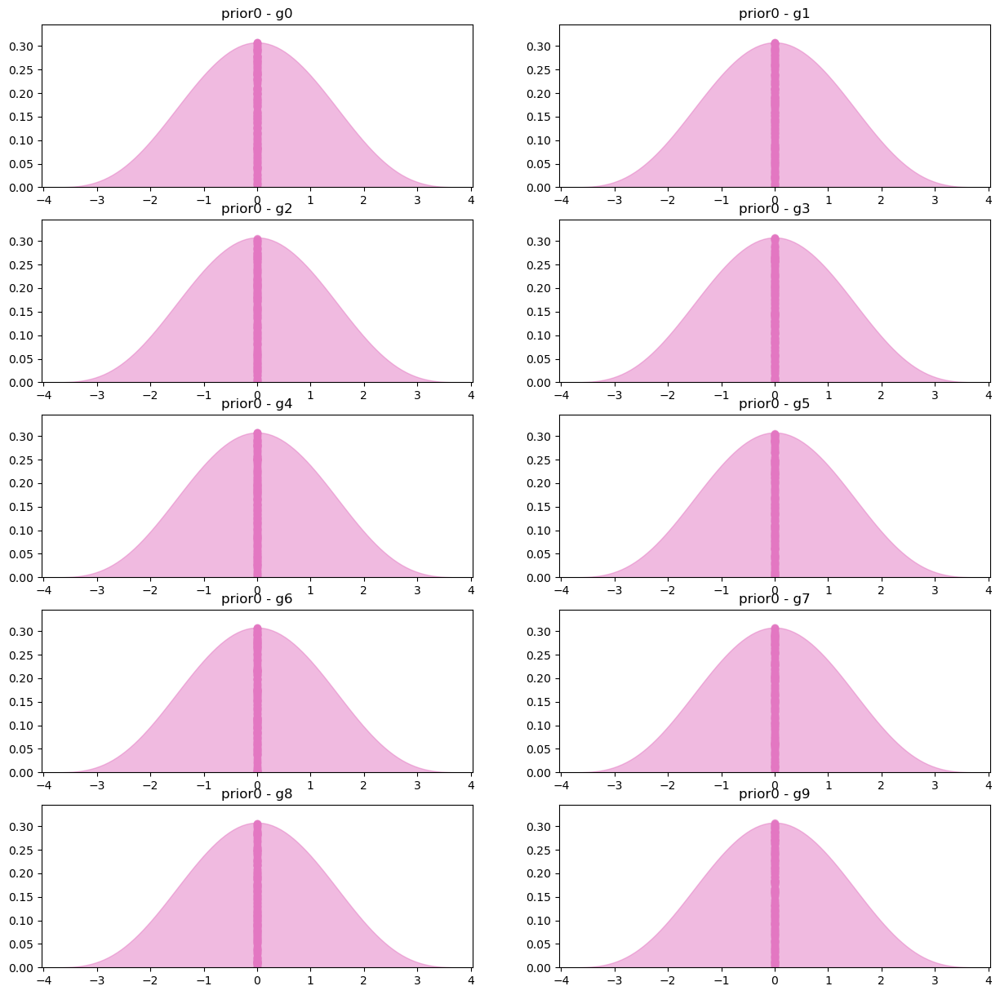

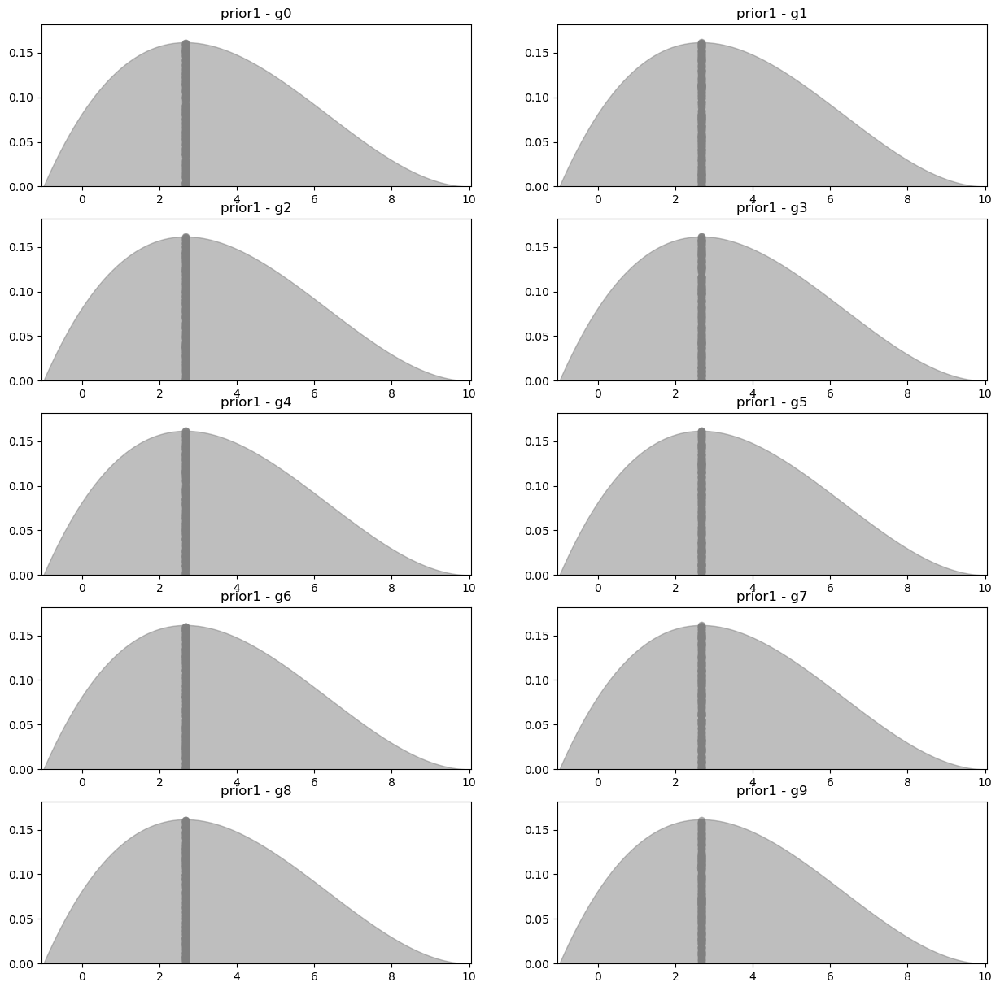

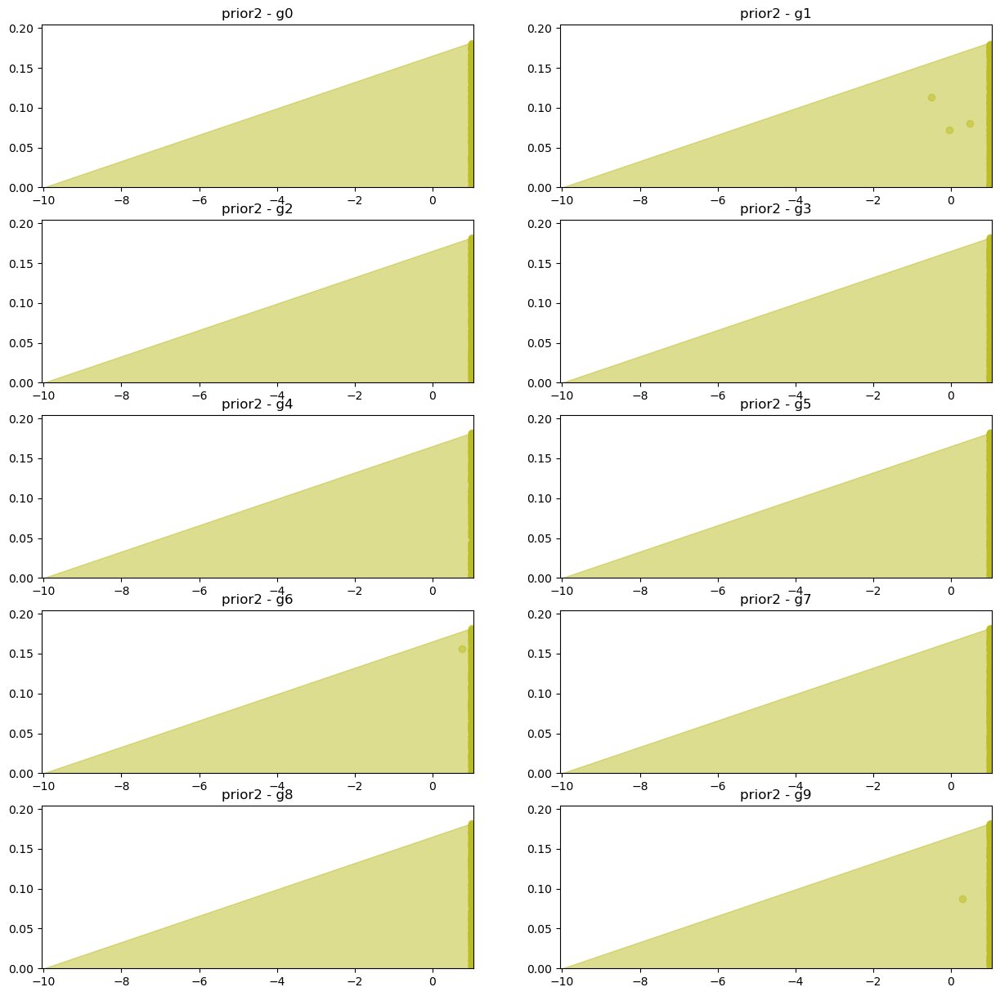

In [145]:
#SGD
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_sgd(300)
tgp.plot_priors(kde=False)

  0%|                                                                                                         …

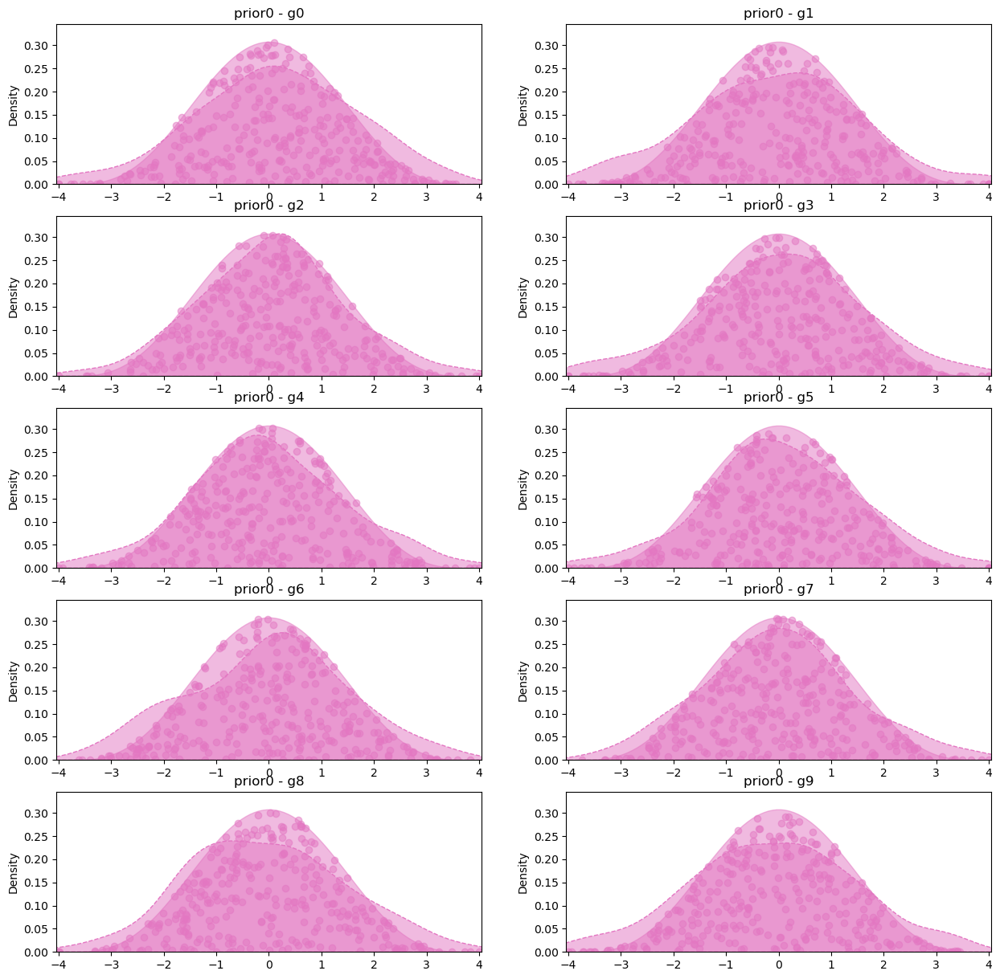

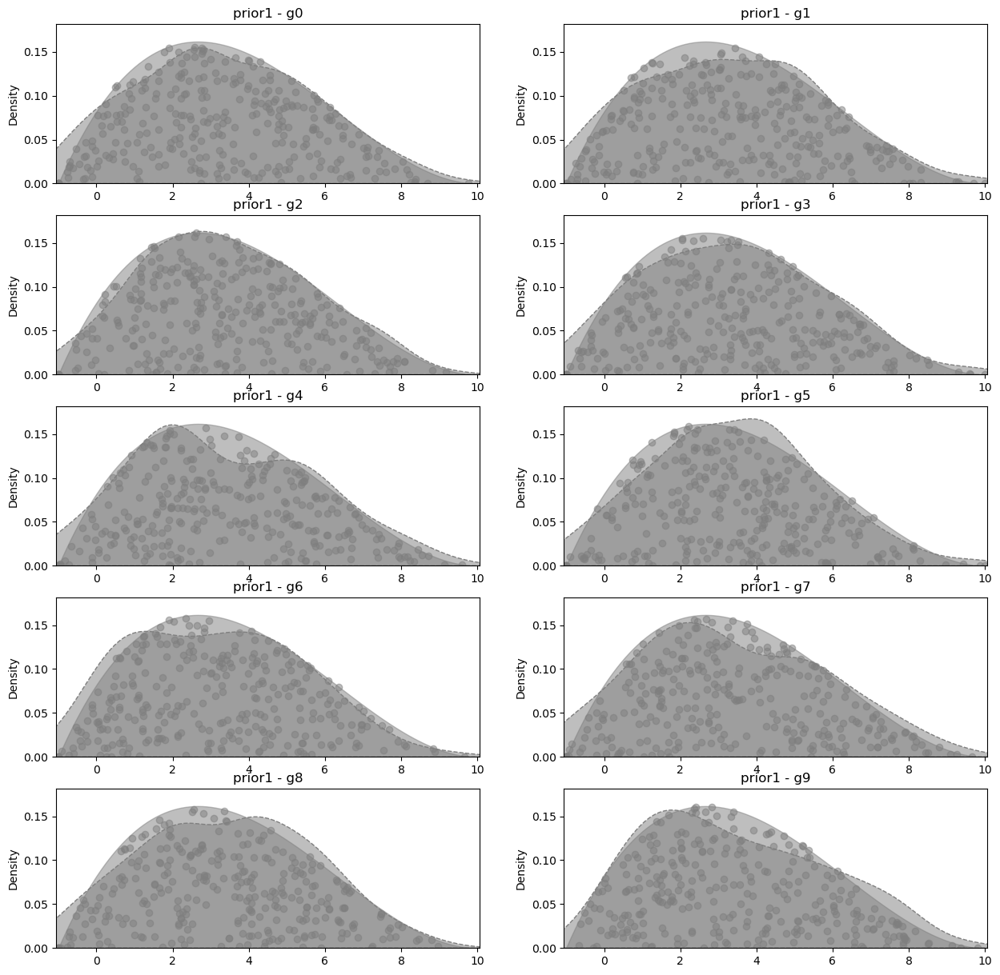

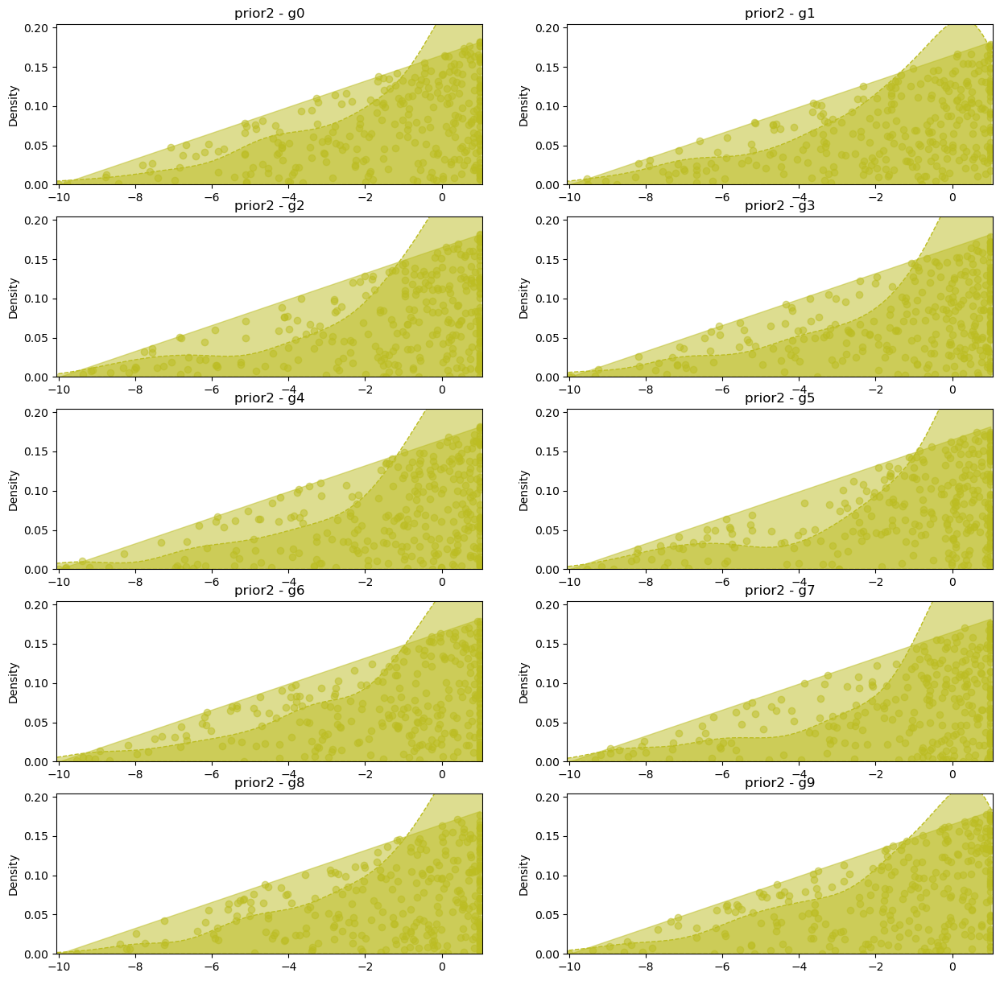

In [146]:
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_Megasvgd(niters=niters, gsvgd=False, mcmc=True)
tgp.plot_priors()

  0%|                                                                                                         …

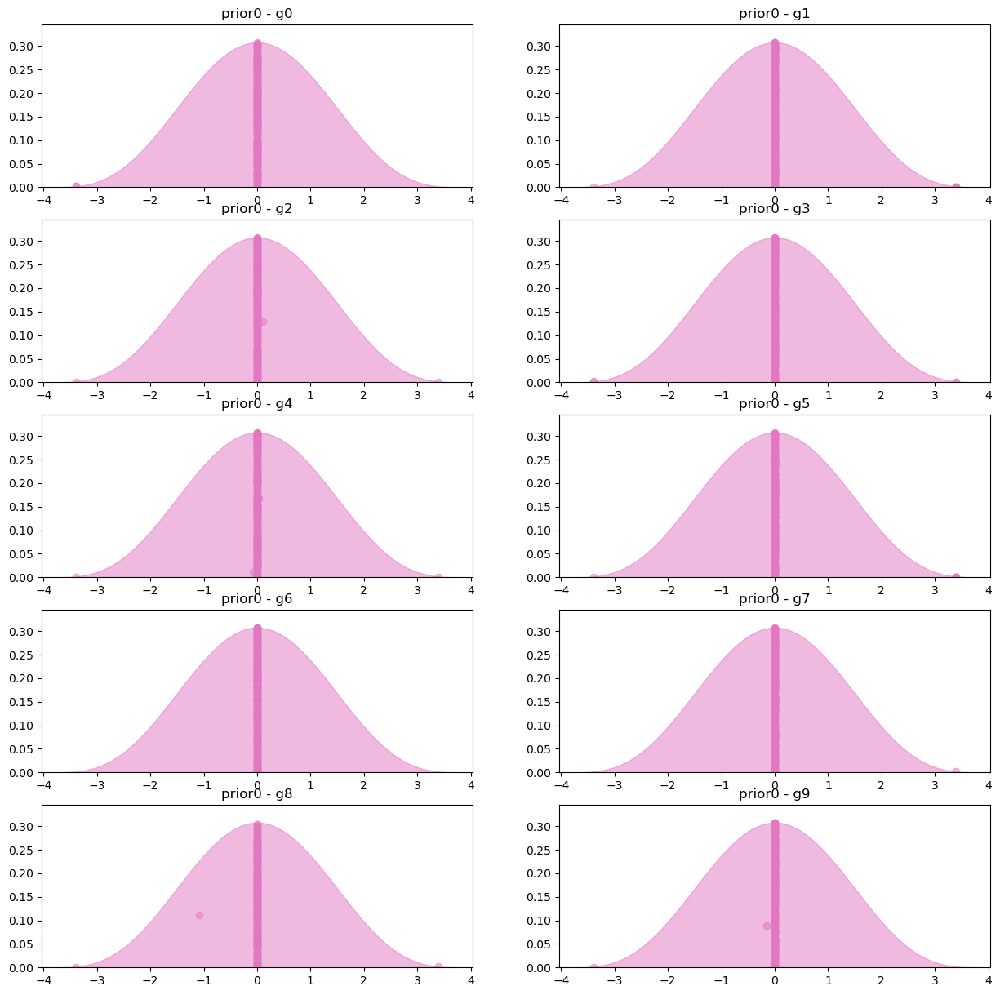

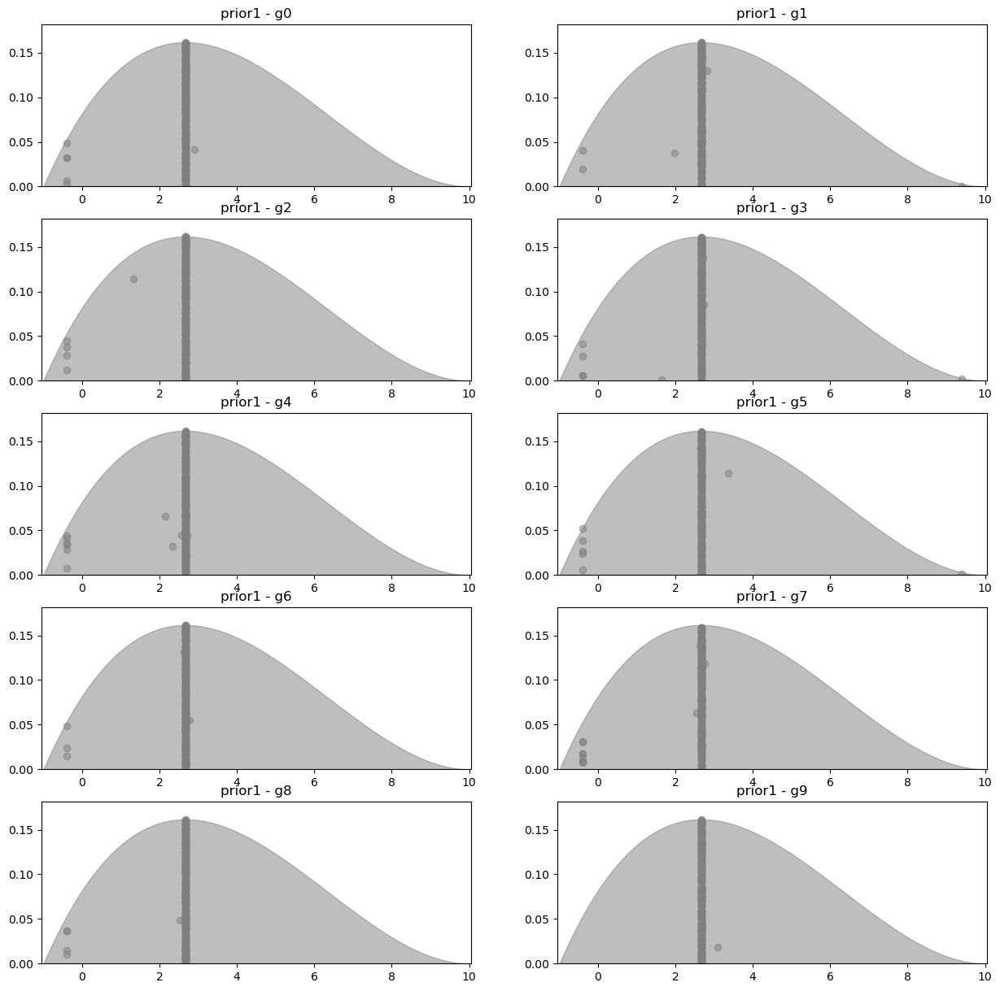

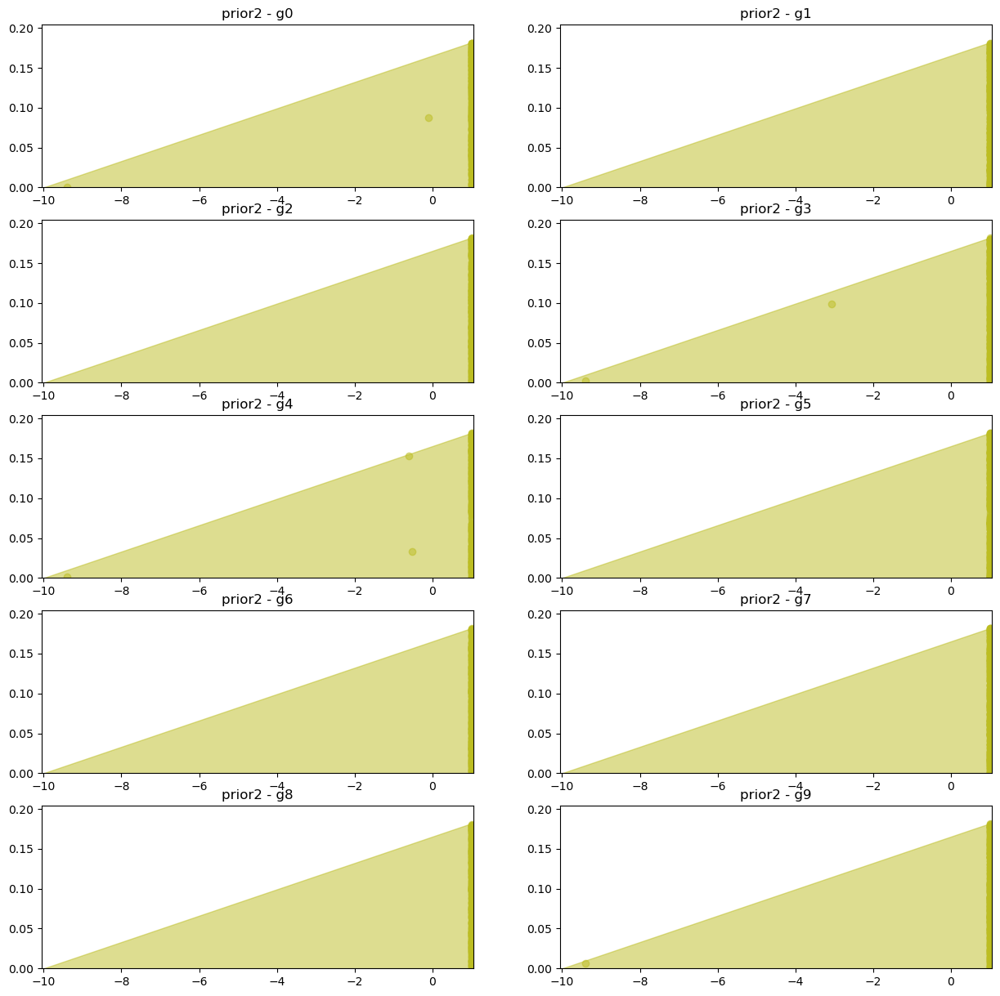

In [147]:
#SGD
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_sgd(300)
tgp.plot_priors(kde=False)

  0%|                                                                                                         …

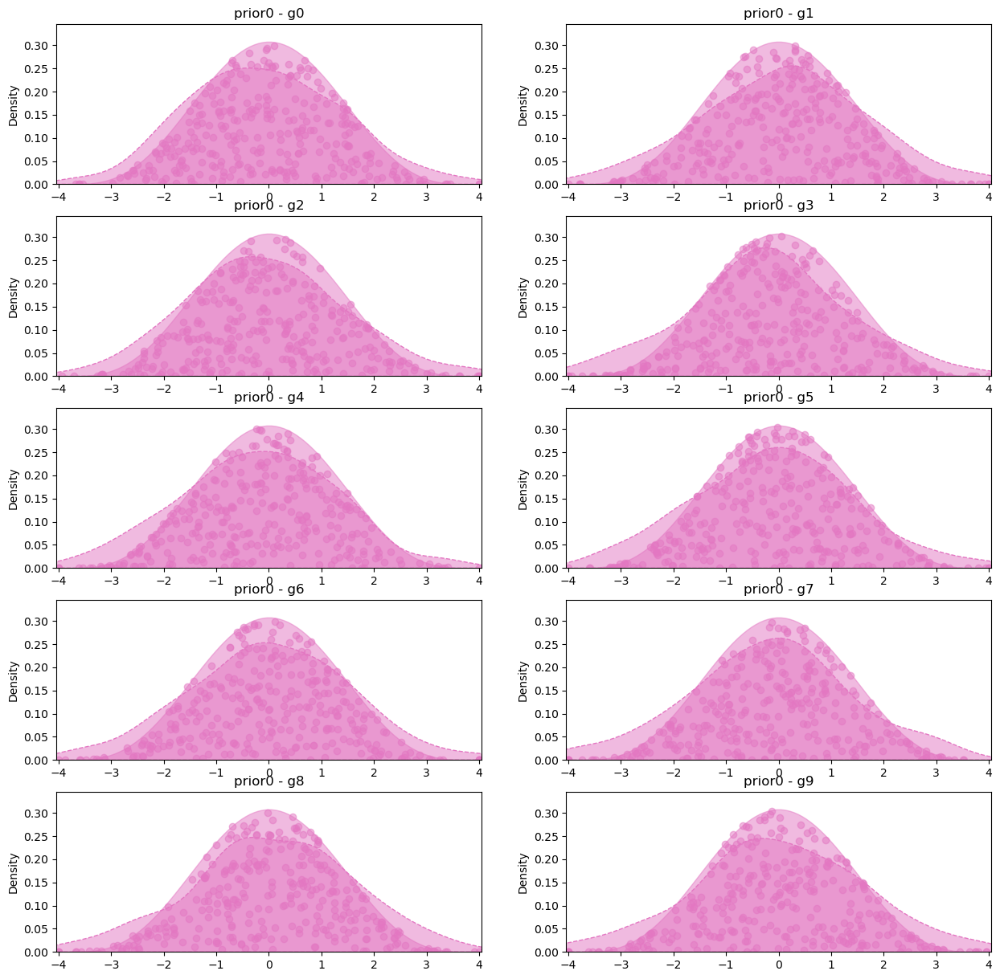

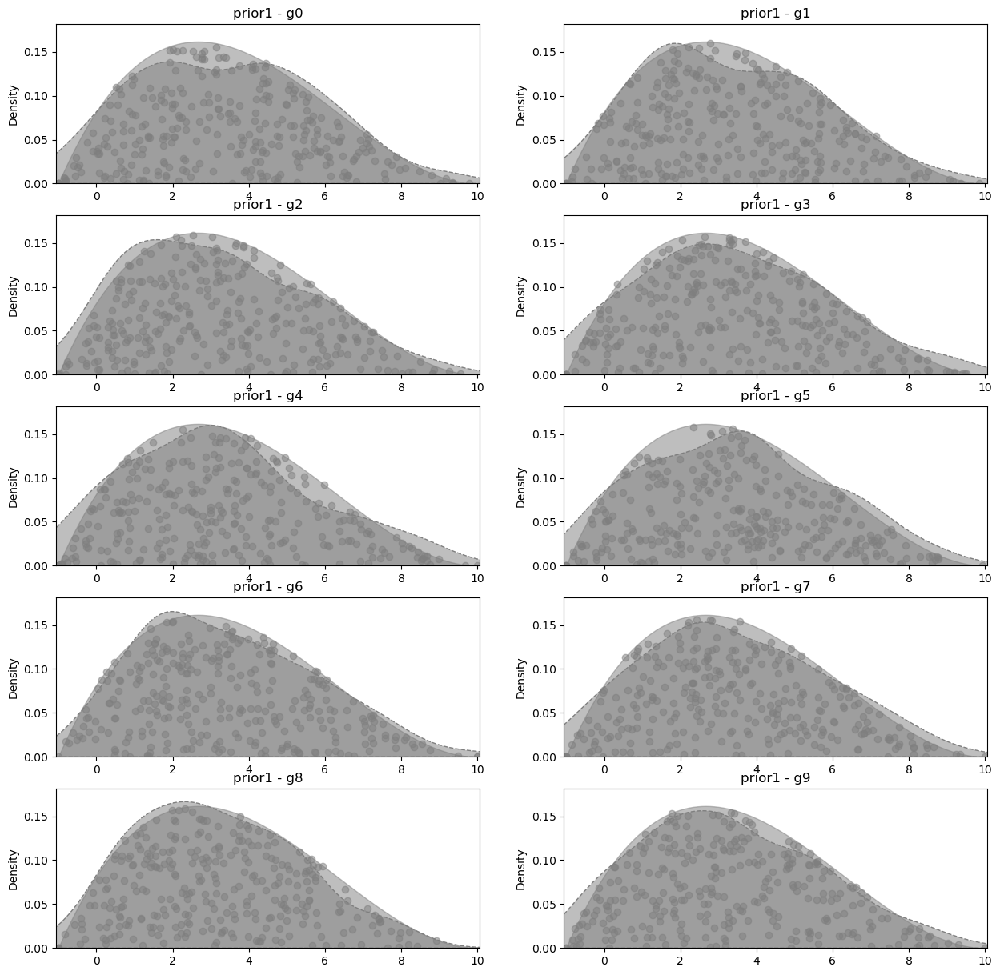

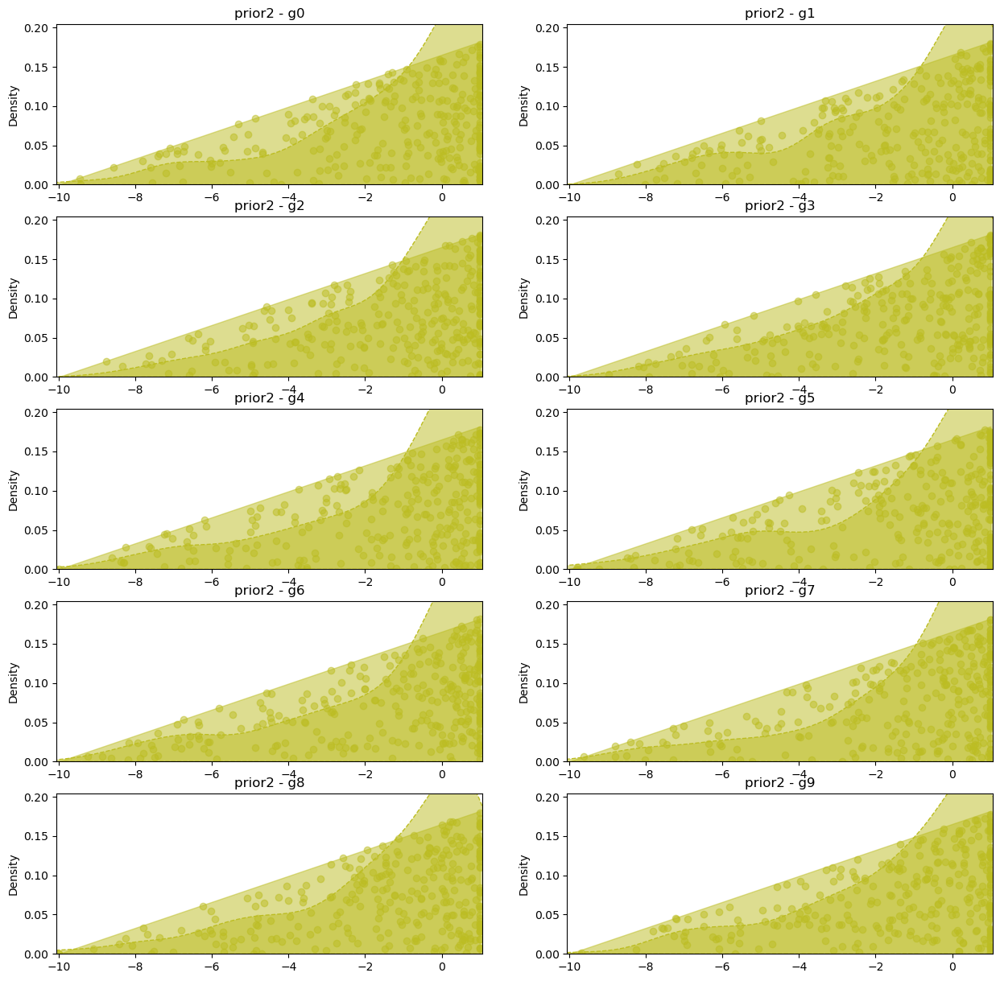

In [148]:
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_svgd(niters=niters, mcmc=True)
tgp.plot_priors()

### GSVGD

In [149]:
# #SGD
# learning = tg.TgLearning(tgp, lr=0.1)
# learning.execute_sgd(300)
# tgp.plot_priors(kde=False)

In [150]:
# learning = tg.TgLearning(tgp, lr=0.1)
# learning.execute_Megasvgd(niters=niters, grad_method='stochastic', gsvgd=True, mcmc=False)
# tgp.plot_priors()

### GSVGD+MCMC 

  0%|                                                                                                         …

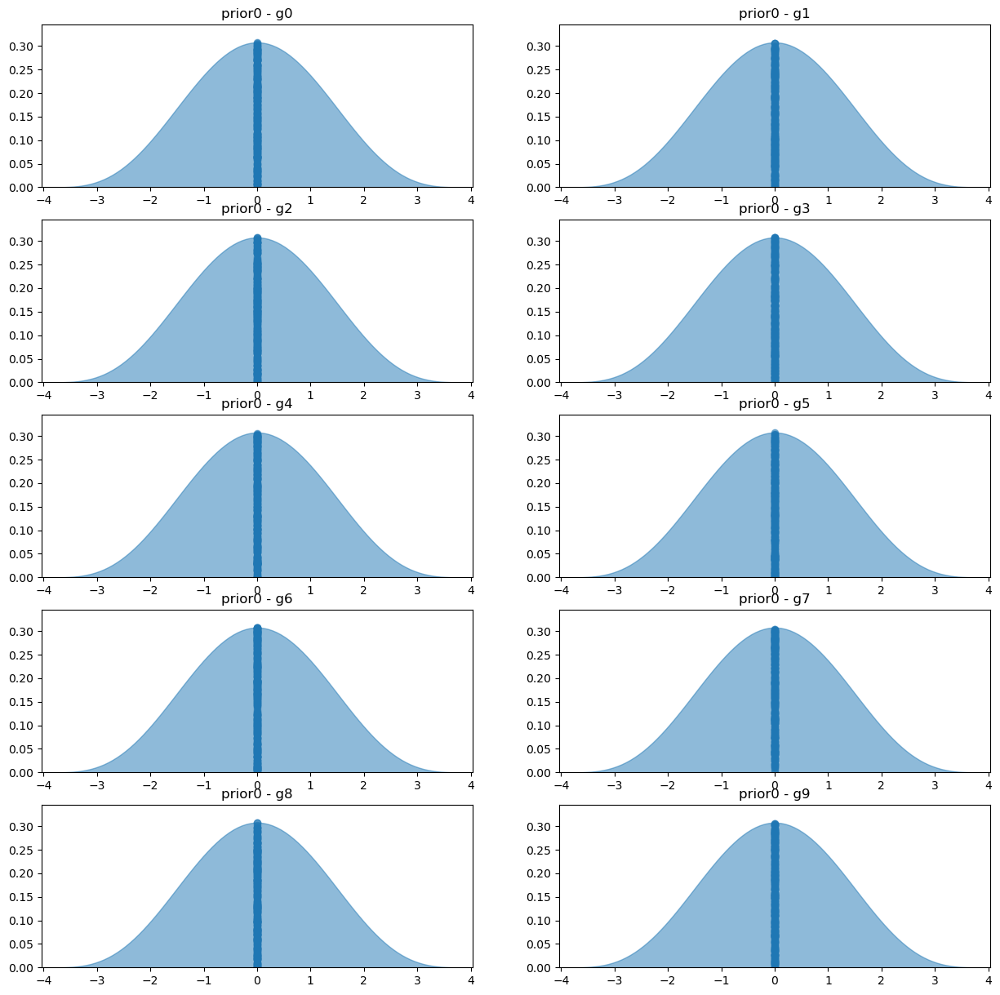

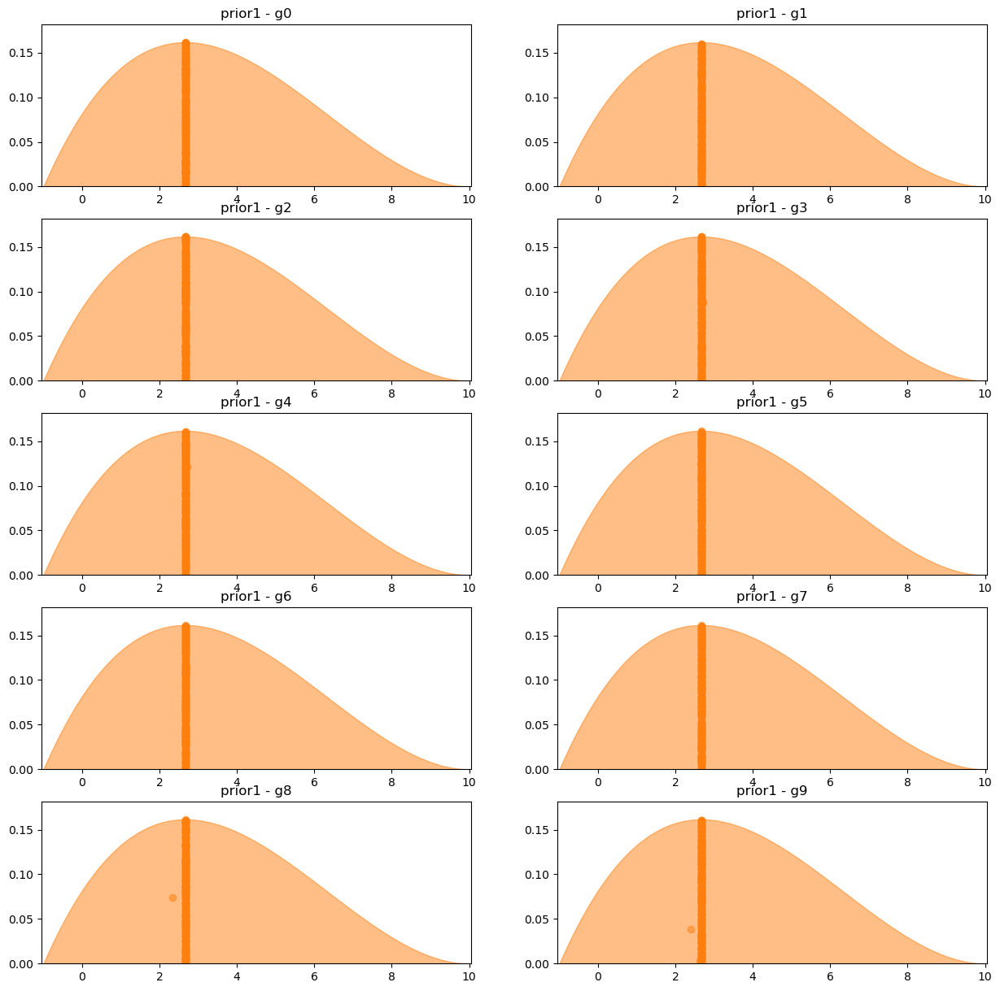

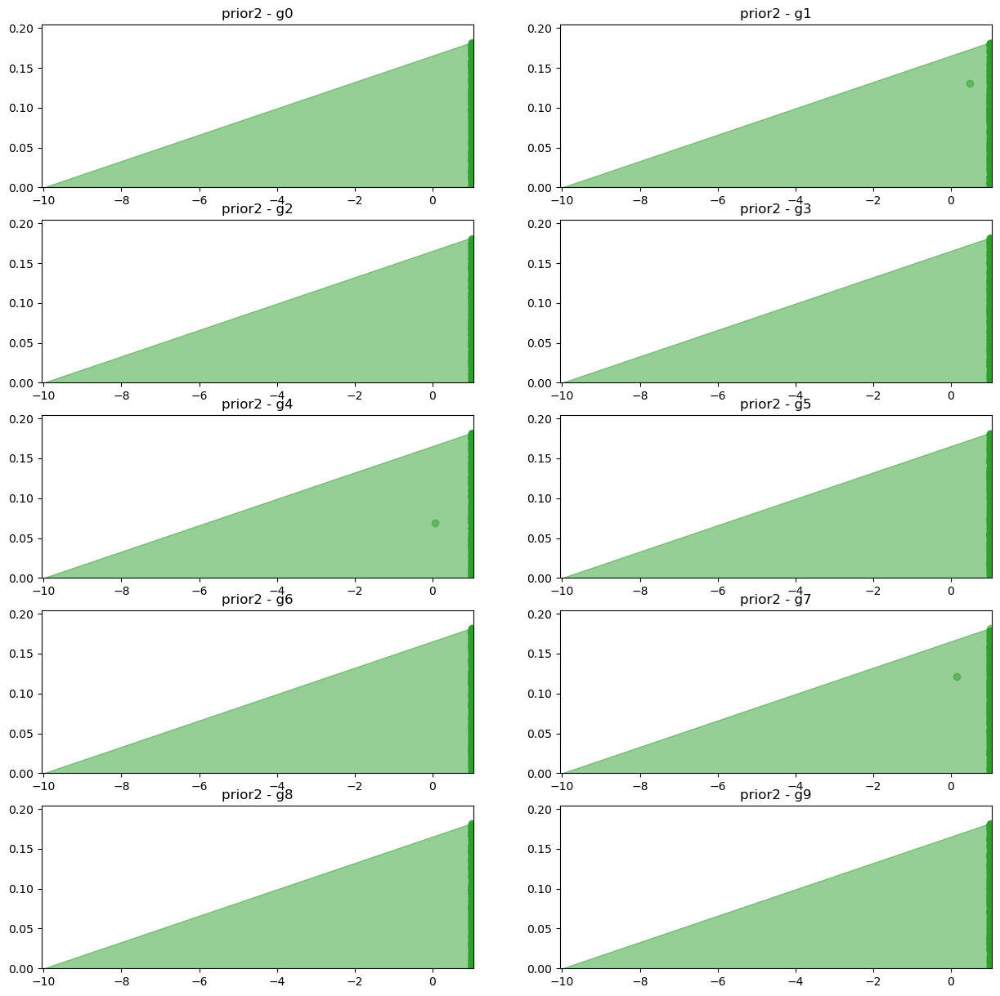

In [6]:
# #SGD
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_sgd(300)
tgp.plot_priors(kde=False)

  0%|                                                                                                         …

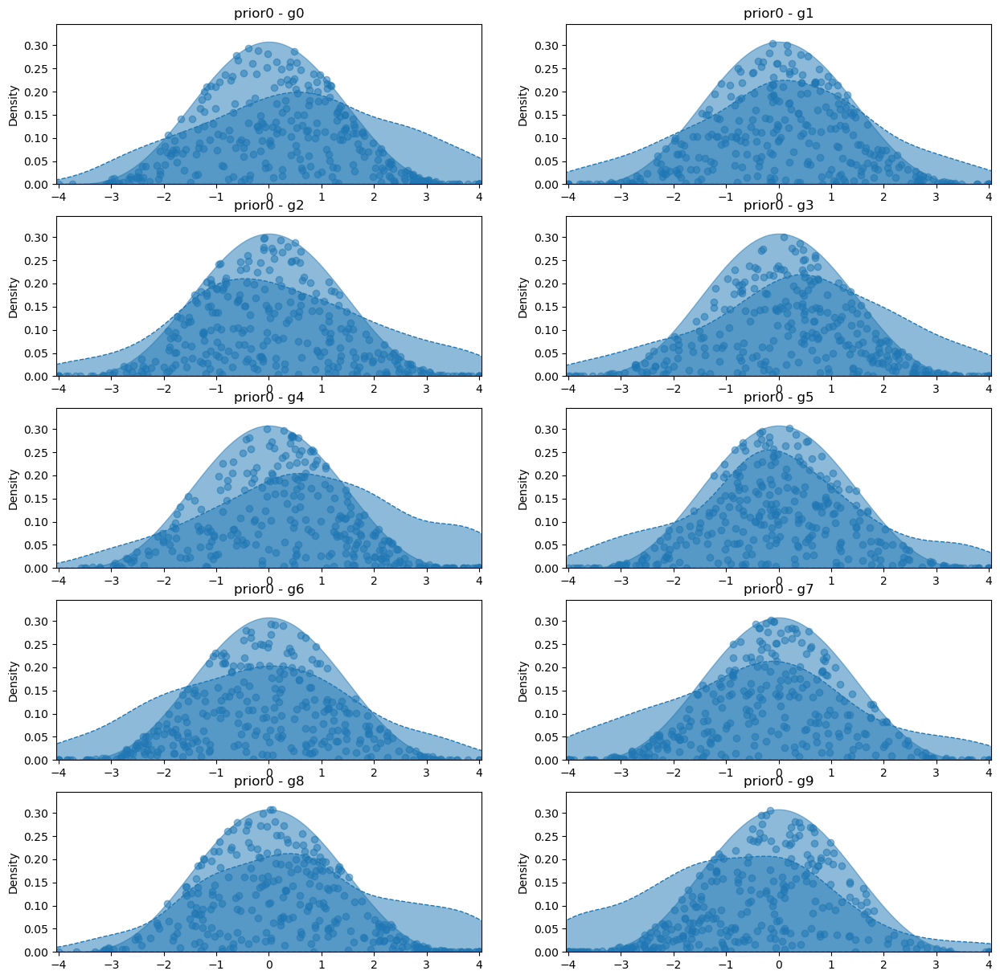

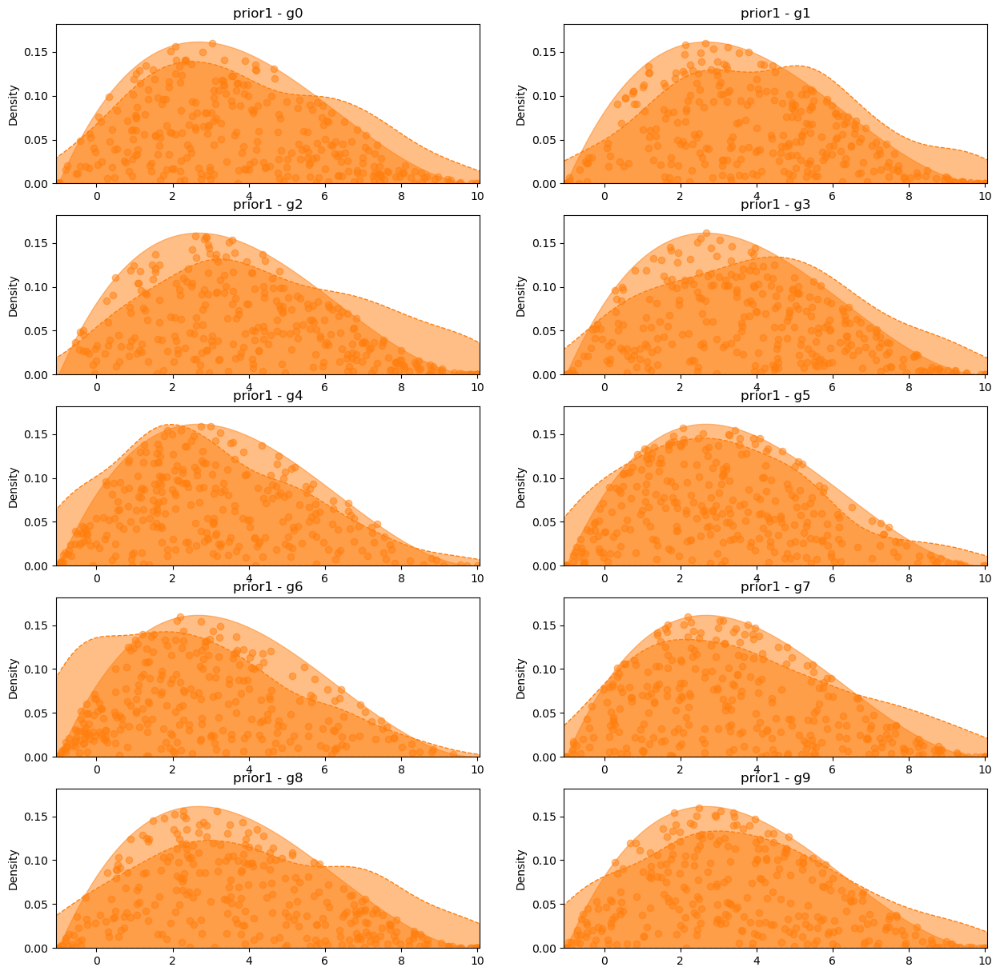

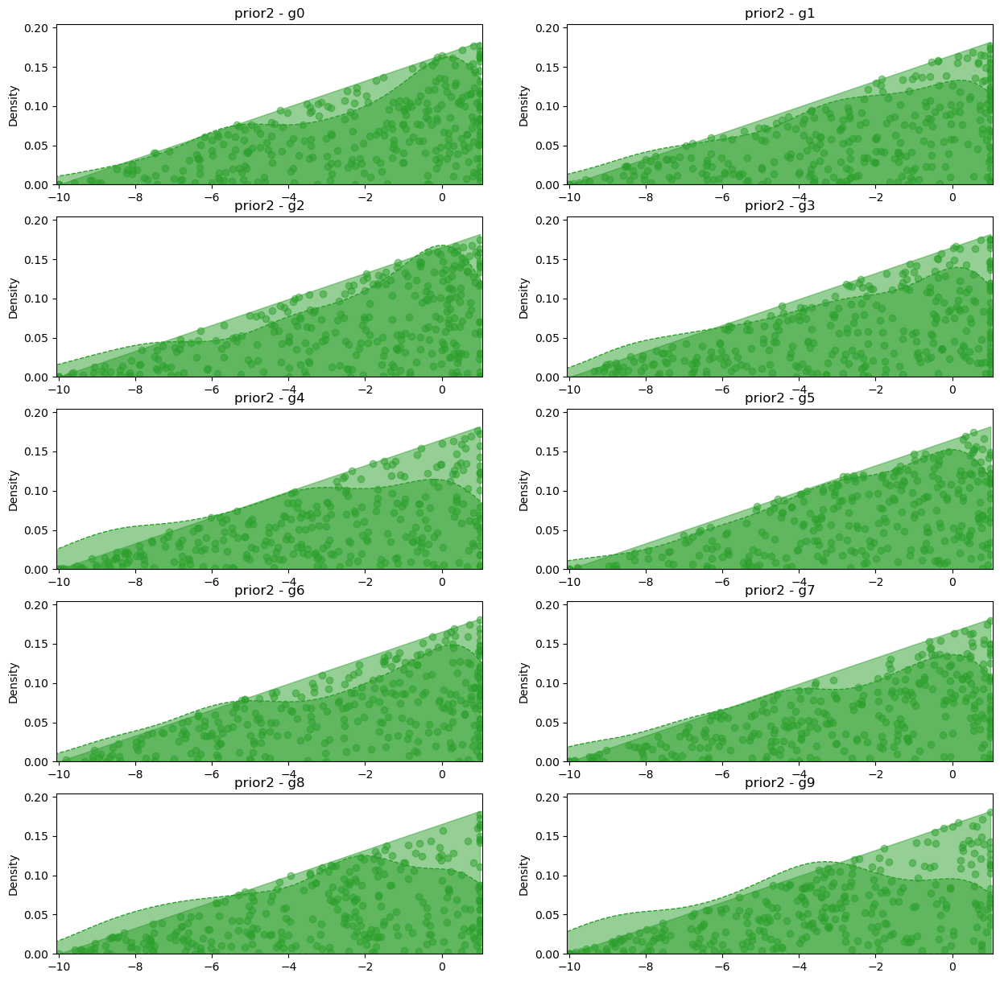

In [7]:
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_Megasvgd(niters, grad_method='stochastic', gsvgd=True, mcmc=True)
tgp.plot_priors()

#### Rango 3


  0%|                                                                                                         …

  0%|                                                                                                         …

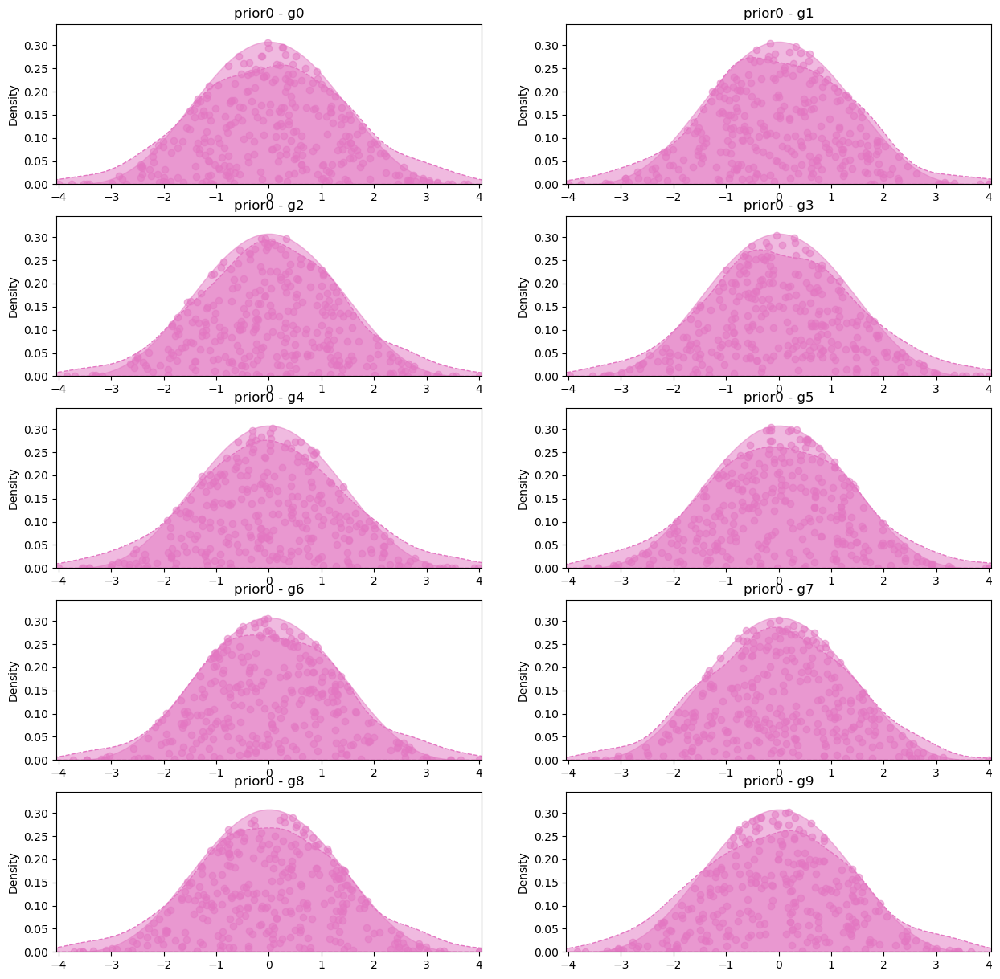

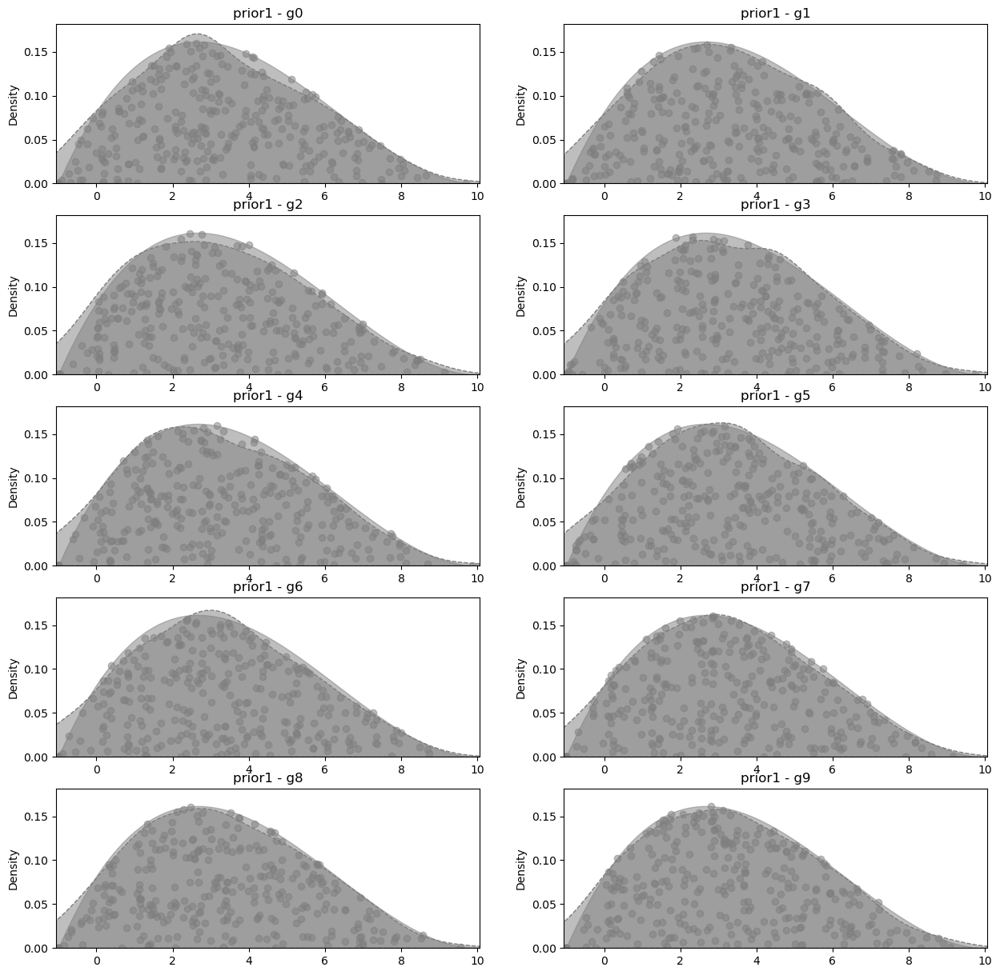

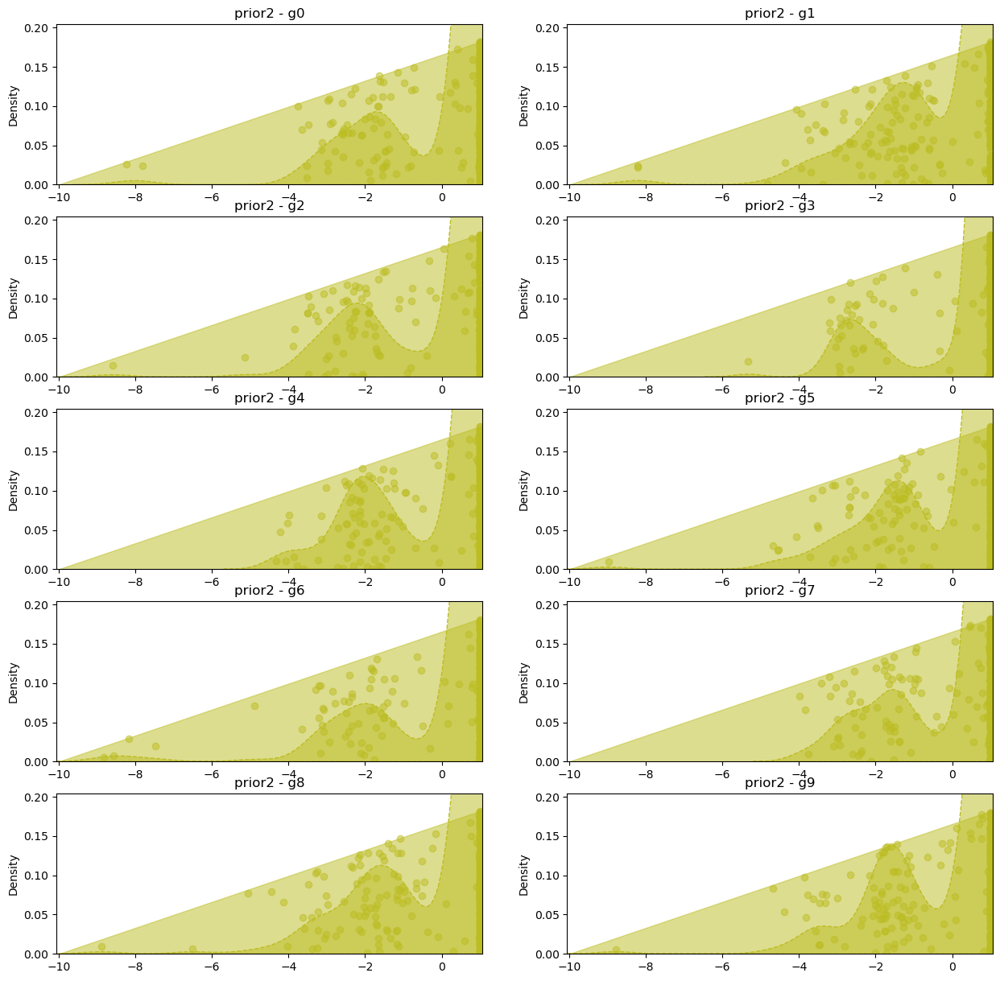

In [153]:
#Proyecciones de rango 3
d = ngroups * npriors
A = torch.eye(d).reshape(10, d, -1)
#SGD
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_sgd(300)

learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_Megasvgd(niters, grad_method='stochastic', mcmc=False, gsvgd=True, A=A)
tgp.plot_priors()

  0%|                                                                                                         …

  0%|                                                                                                         …

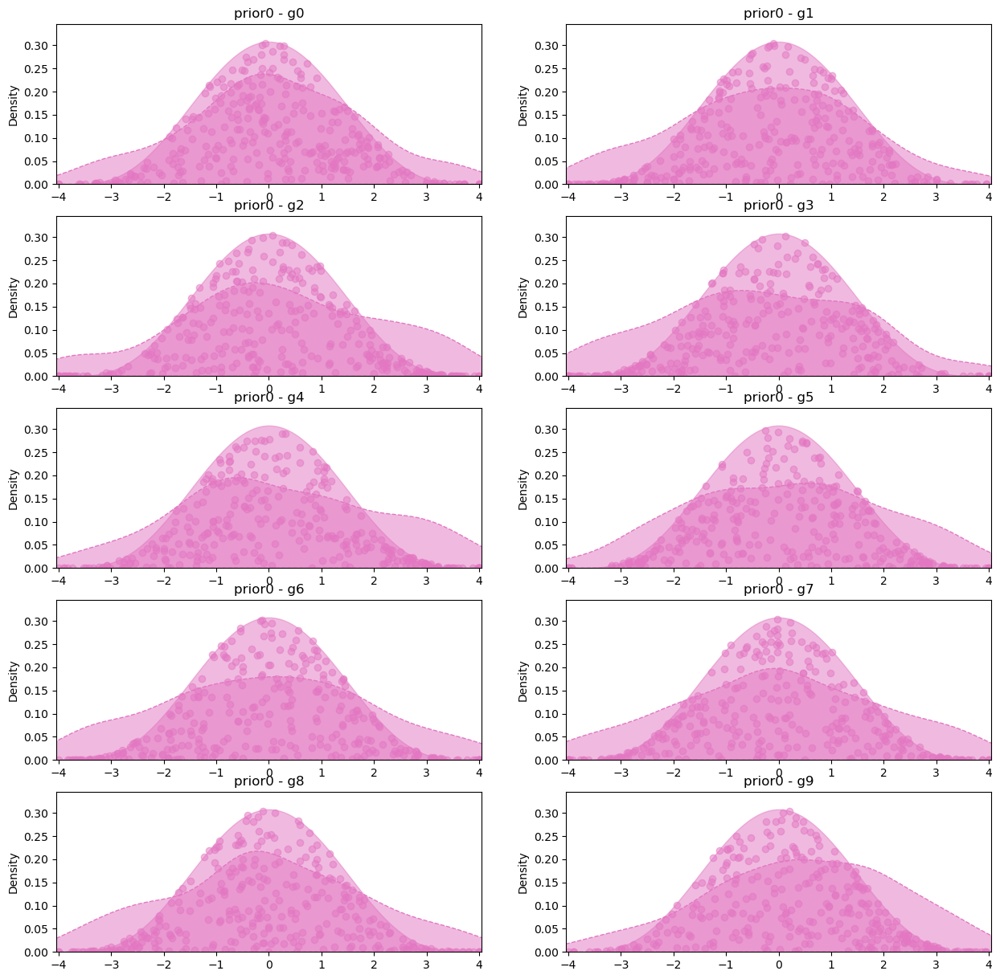

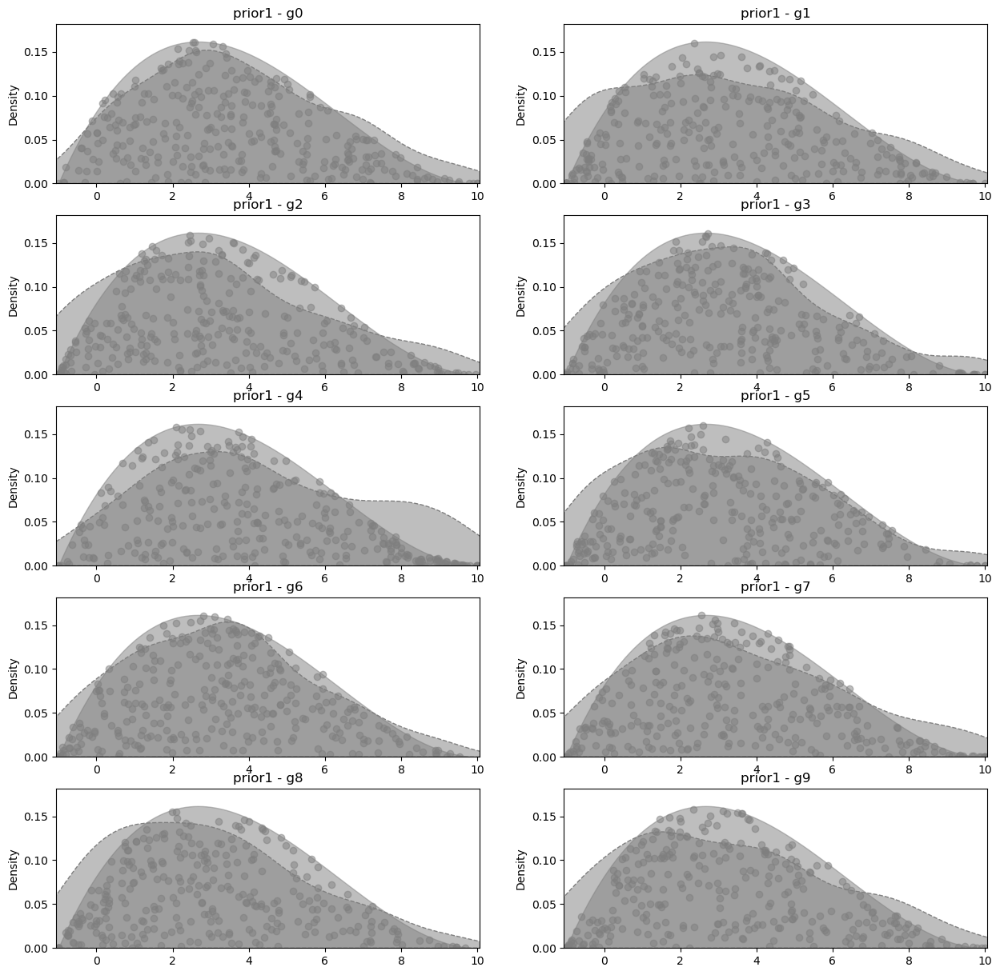

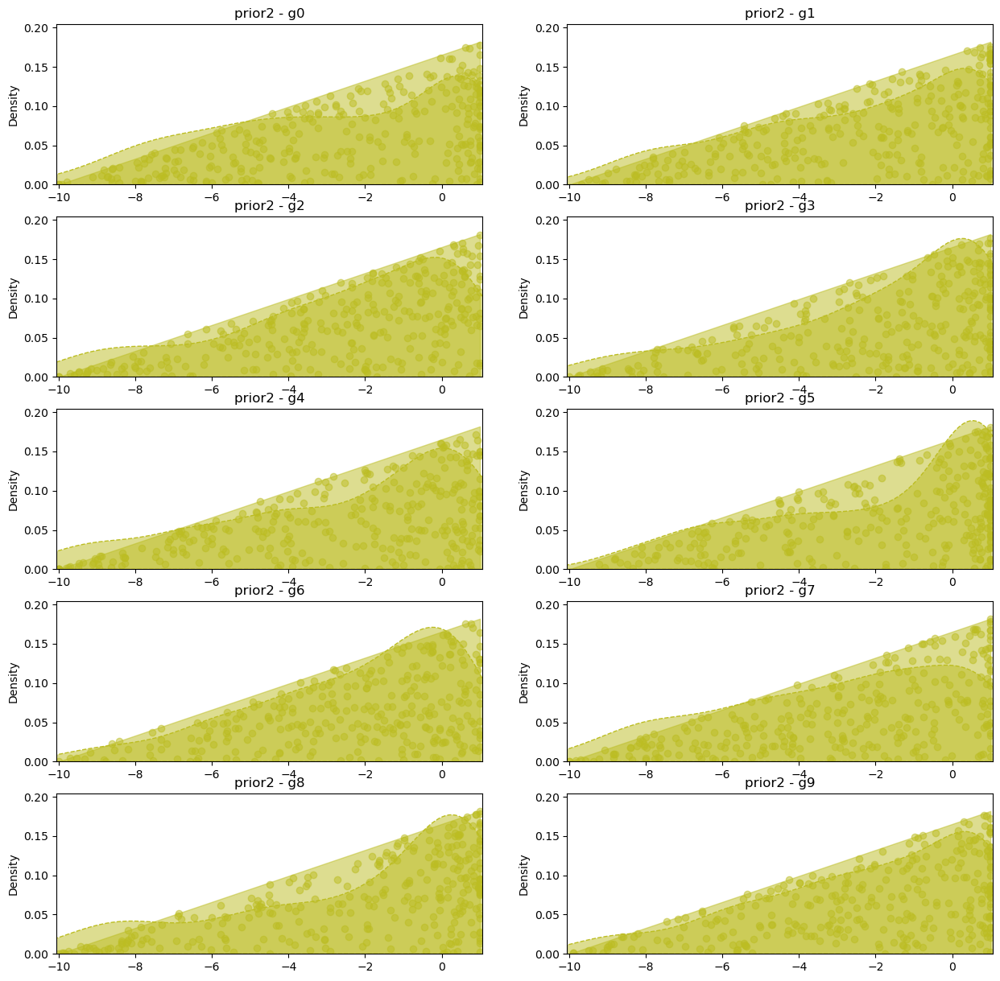

In [154]:
#Proyecciones de rango 3
d = ngroups * npriors
A = torch.eye(d).reshape(10, d, -1)
#SGD
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_sgd(300)

learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_Megasvgd(niters, grad_method='stochastic', mcmc=True, gsvgd=True, A=A)
tgp.plot_priors()

#### Rango completo

  0%|                                                                                                         …

  0%|                                                                                                         …

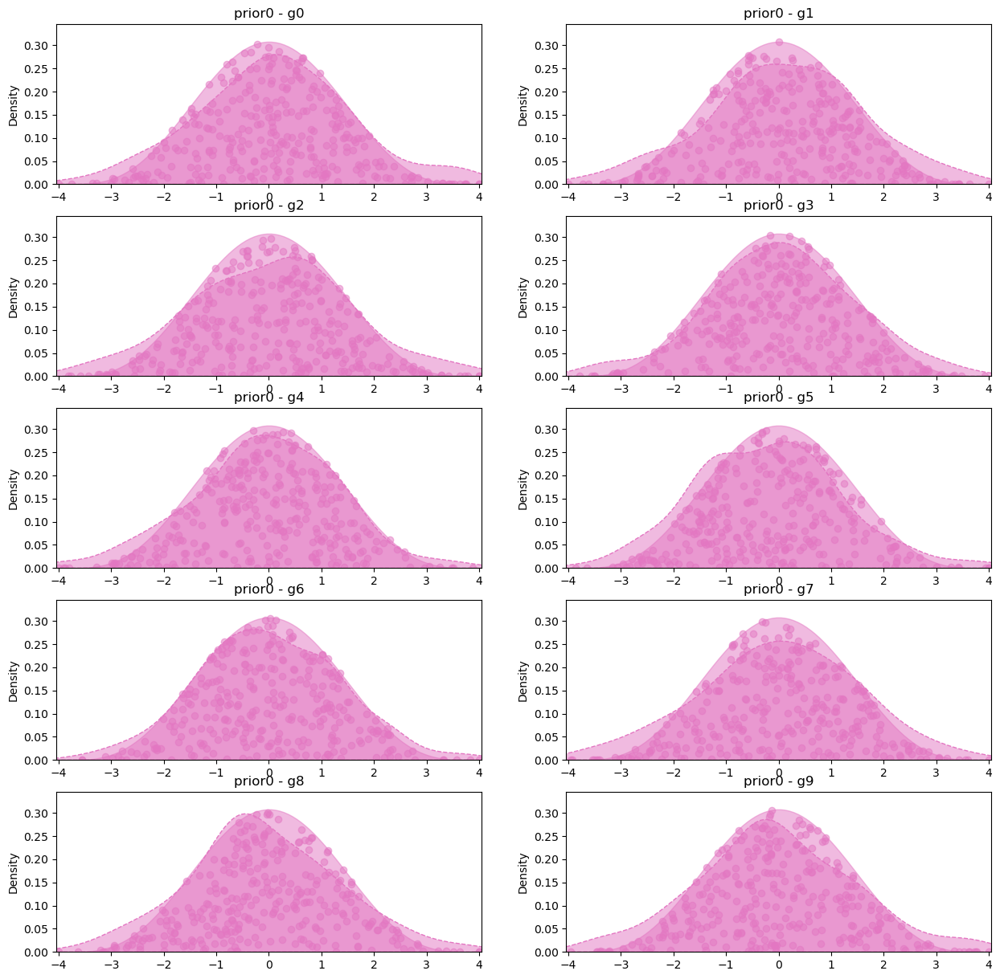

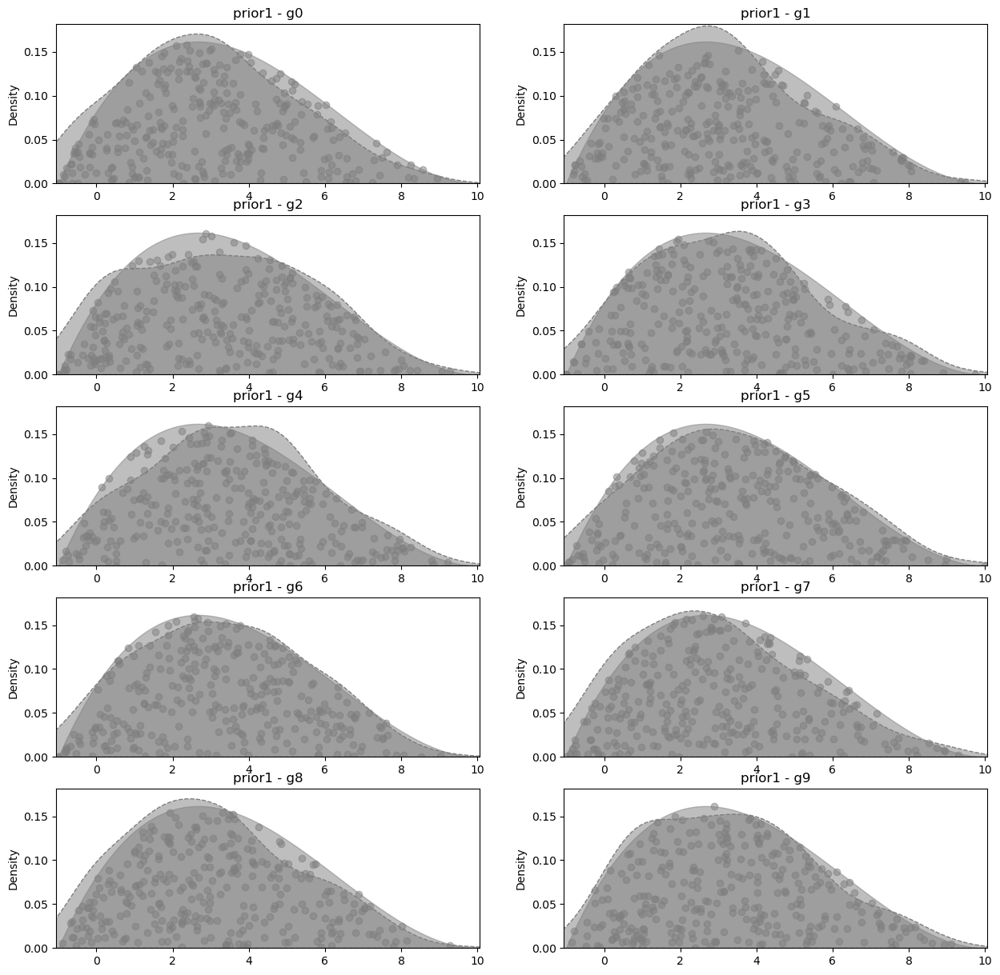

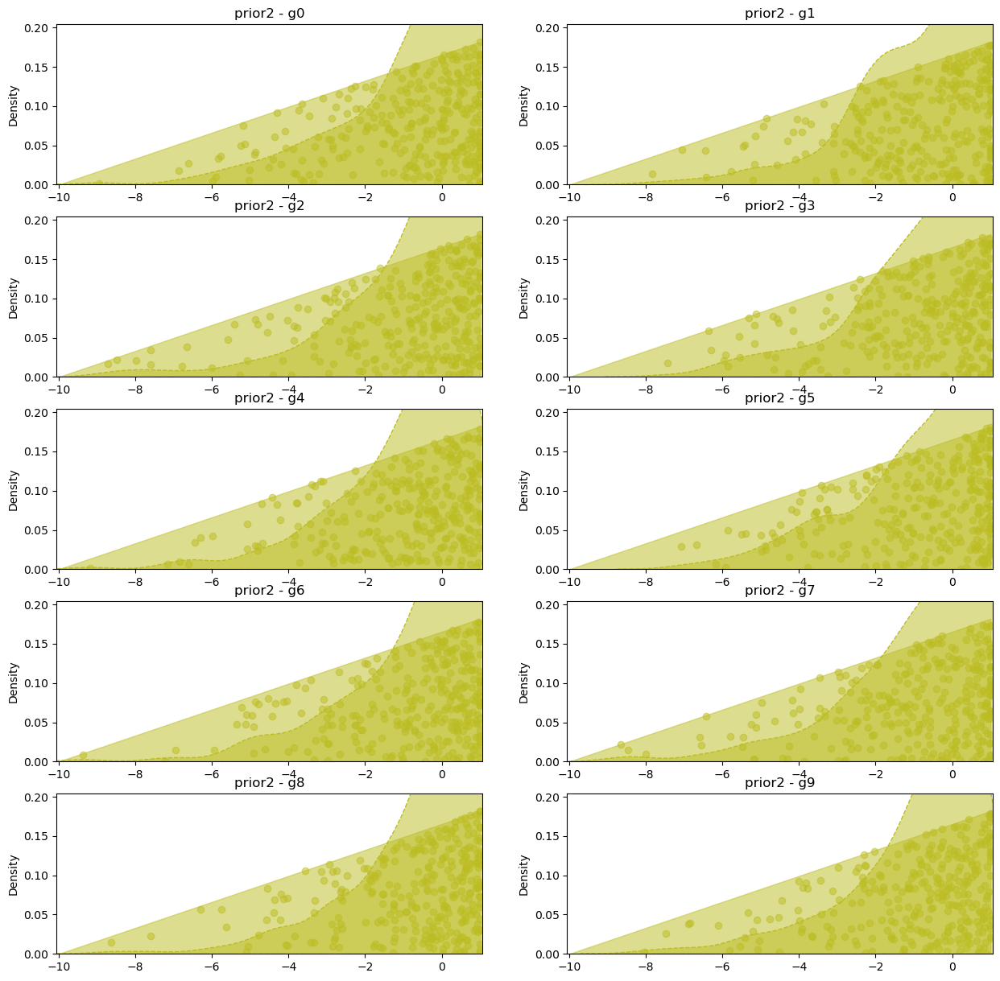

In [155]:
d = ngroups * npriors
A = torch.eye(d)
#SGD
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_sgd(300)

learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_Megasvgd(niters, grad_method='stochastic', gsvgd=True, mcmc=True, A=A)
tgp.plot_priors()

### SVGD

  0%|                                                                                                         …

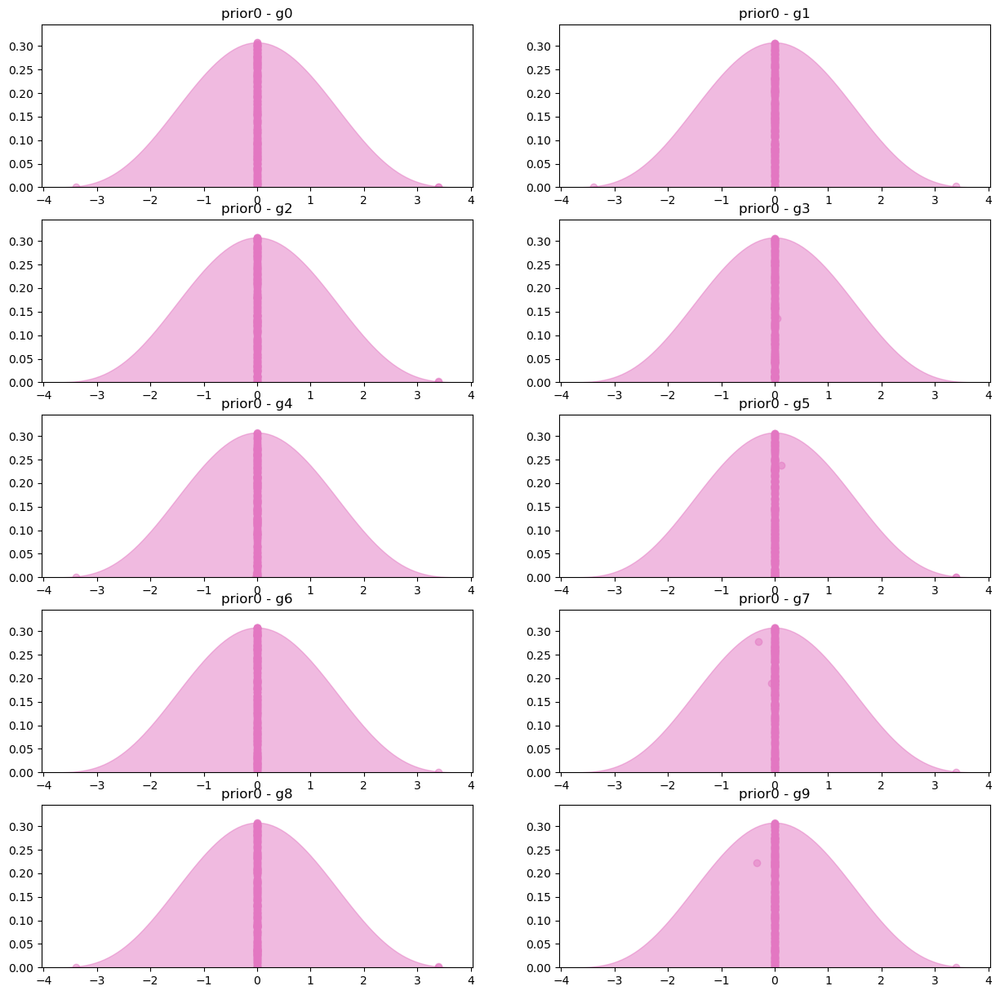

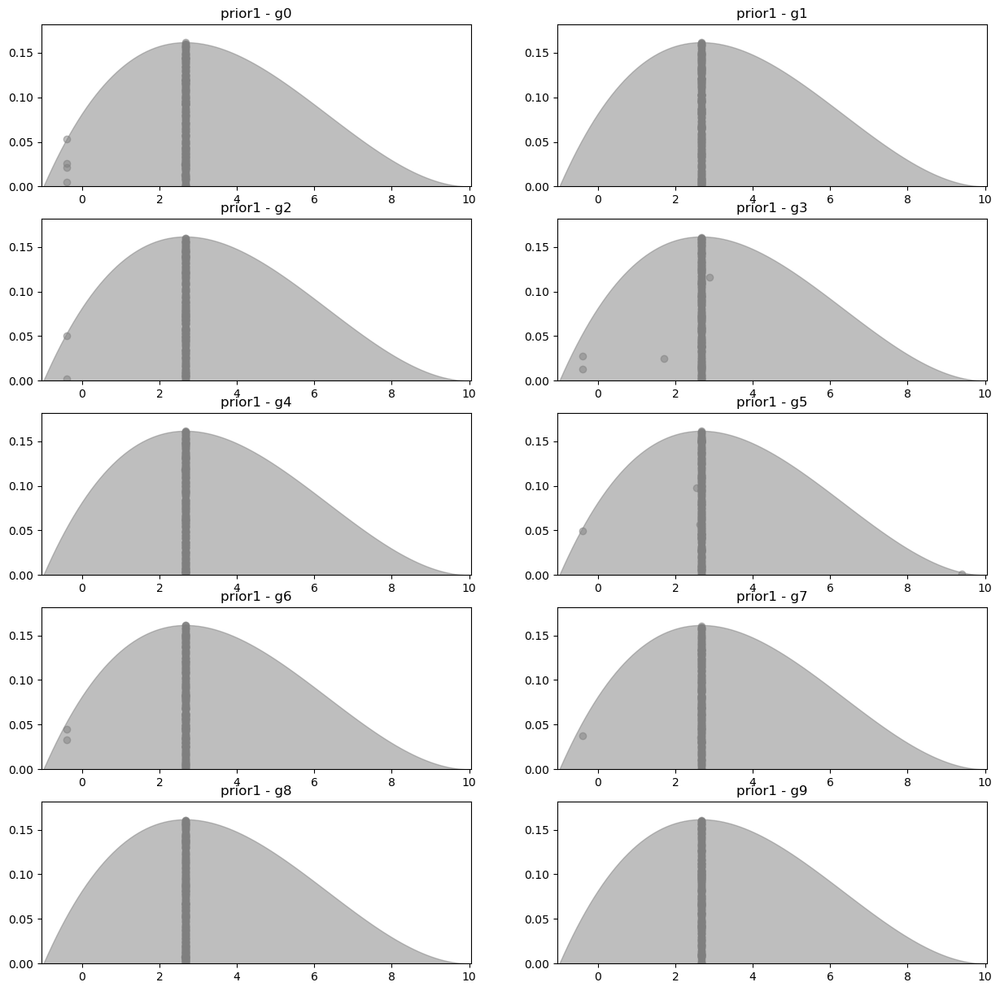

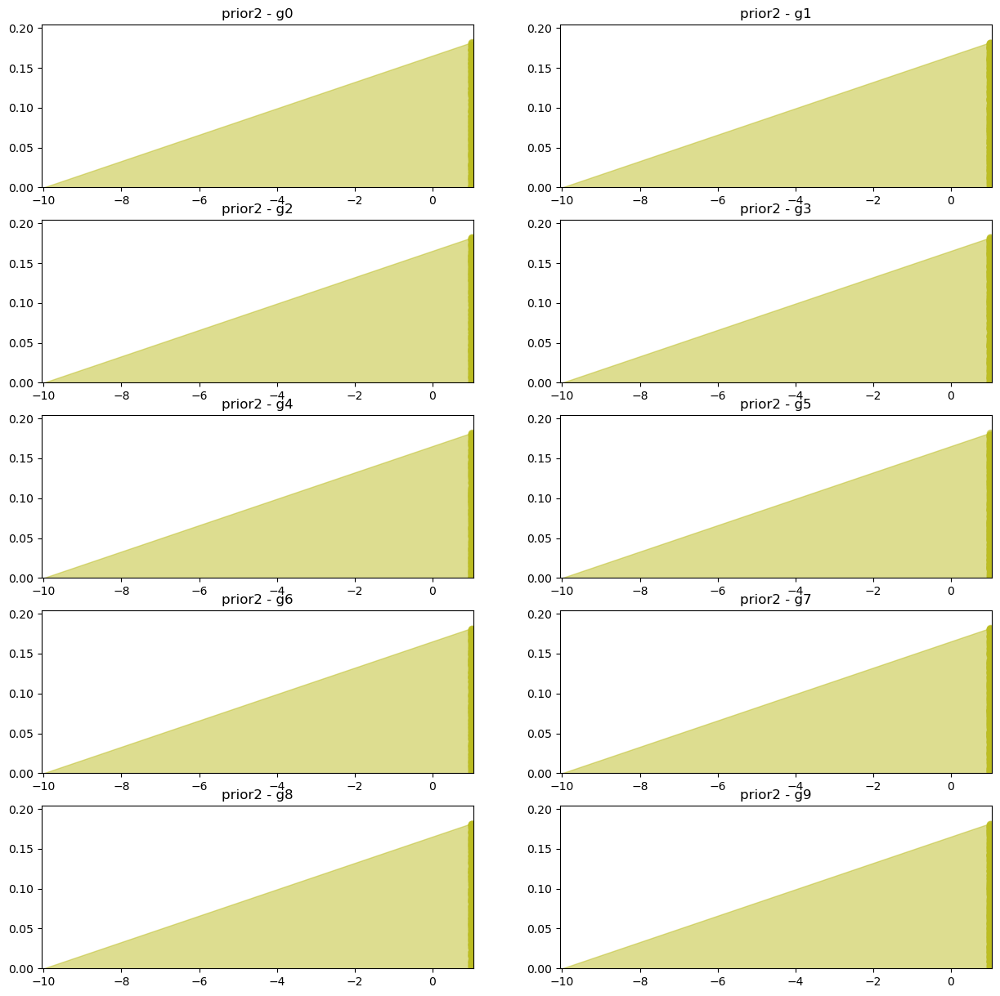

In [156]:
#SGD
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_sgd(300)
tgp.plot_priors(kde=False)

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

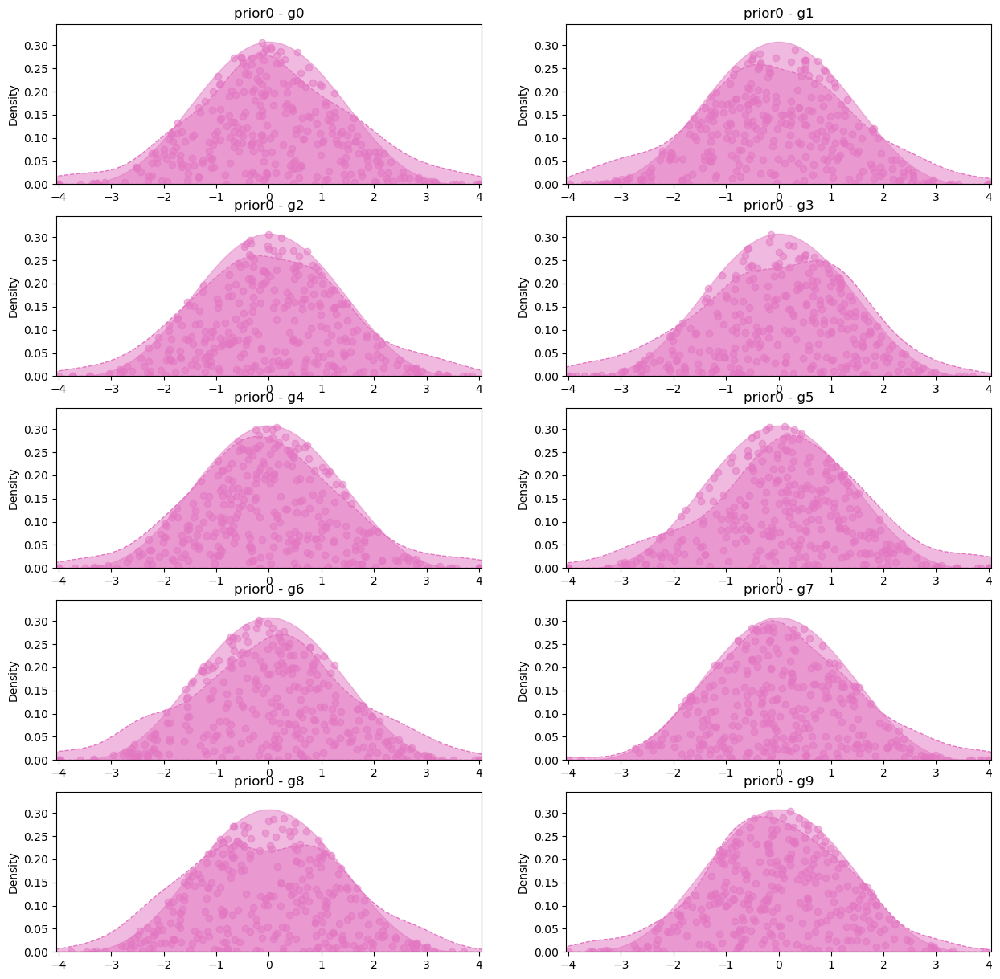

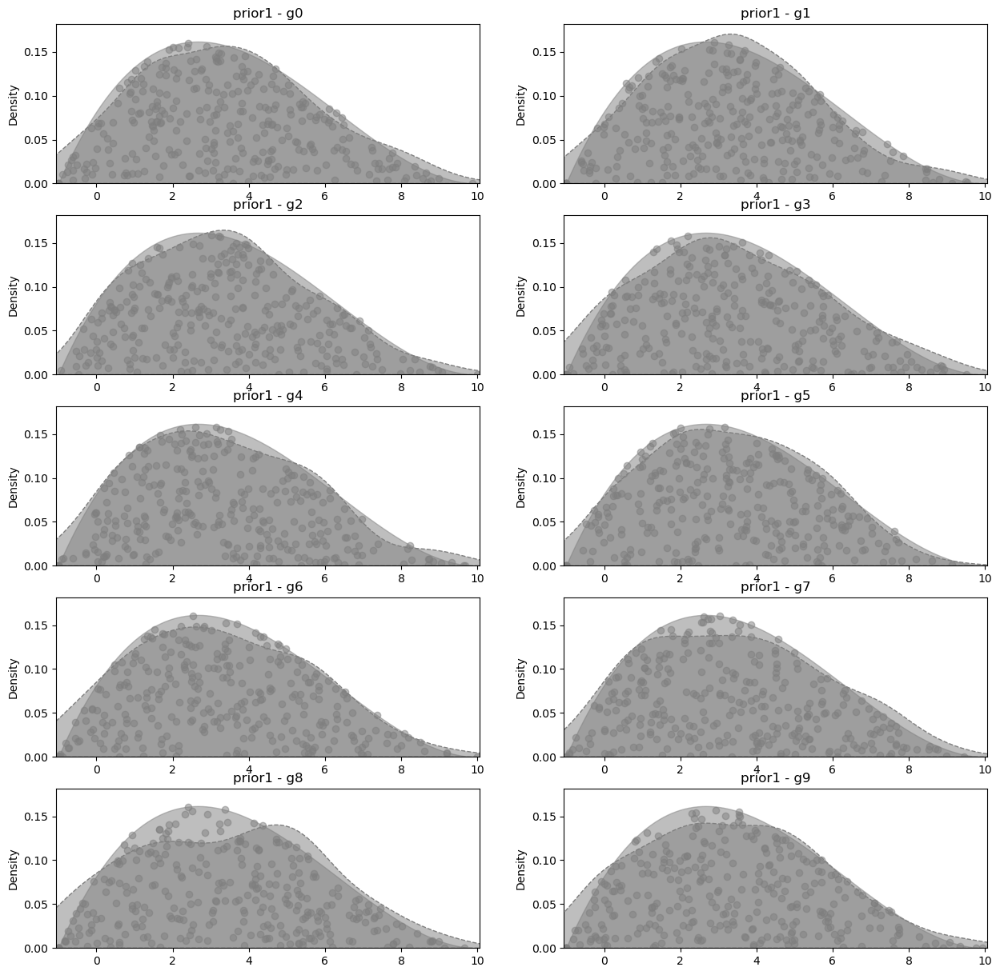

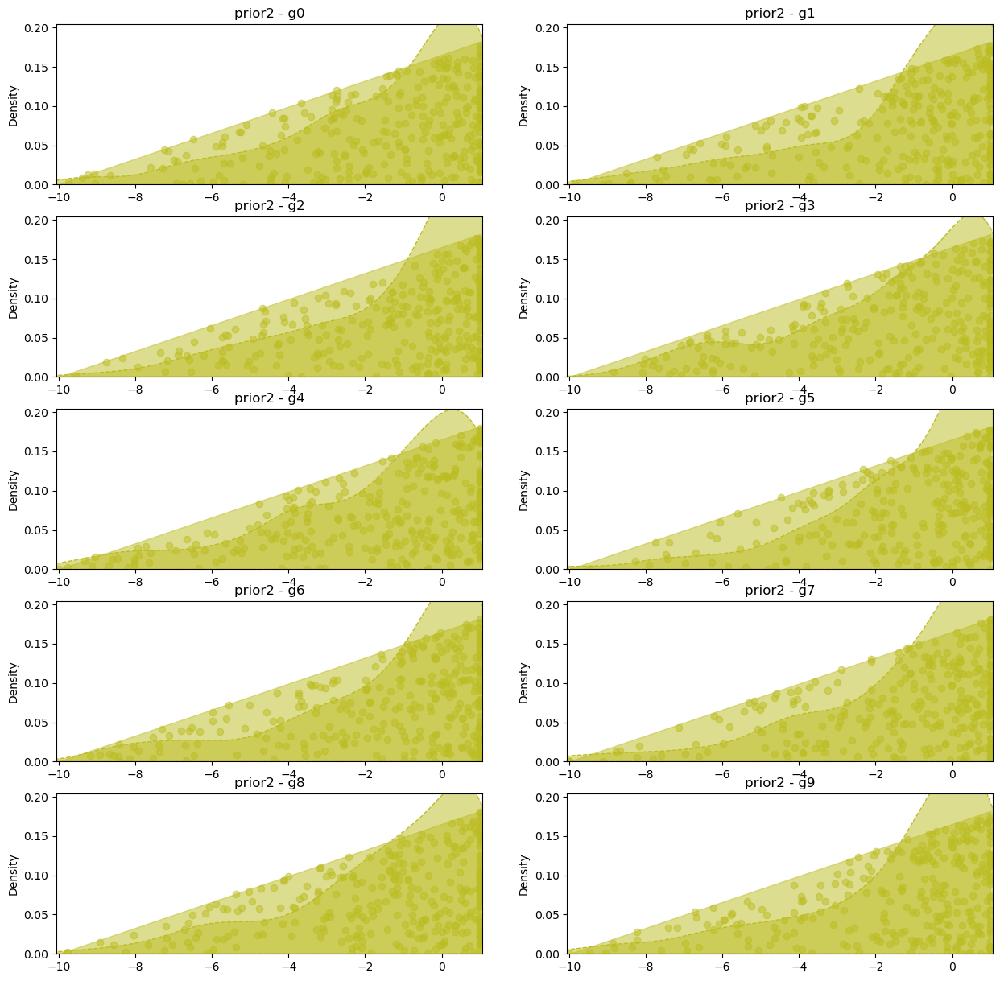

In [157]:
review_dict_SVGD = learning.review(niters=niters, nreview=nreview, nprior=npriors, ngroup=ngroups, grassman=False) 
# hay alguna forma que salga las iteraciones totales en vez de 10 en 10 ?
tgp.plot_priors(kde=True)

### GSVGD

  0%|                                                                                                         …

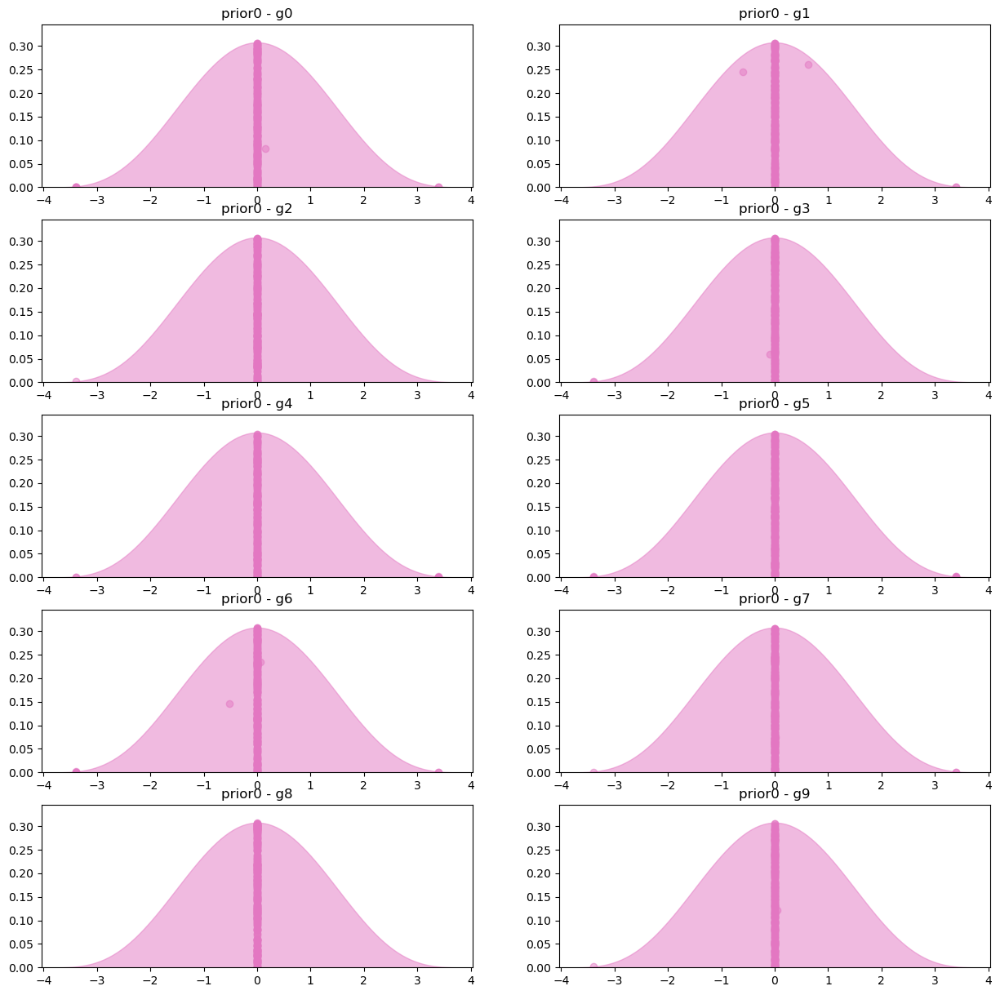

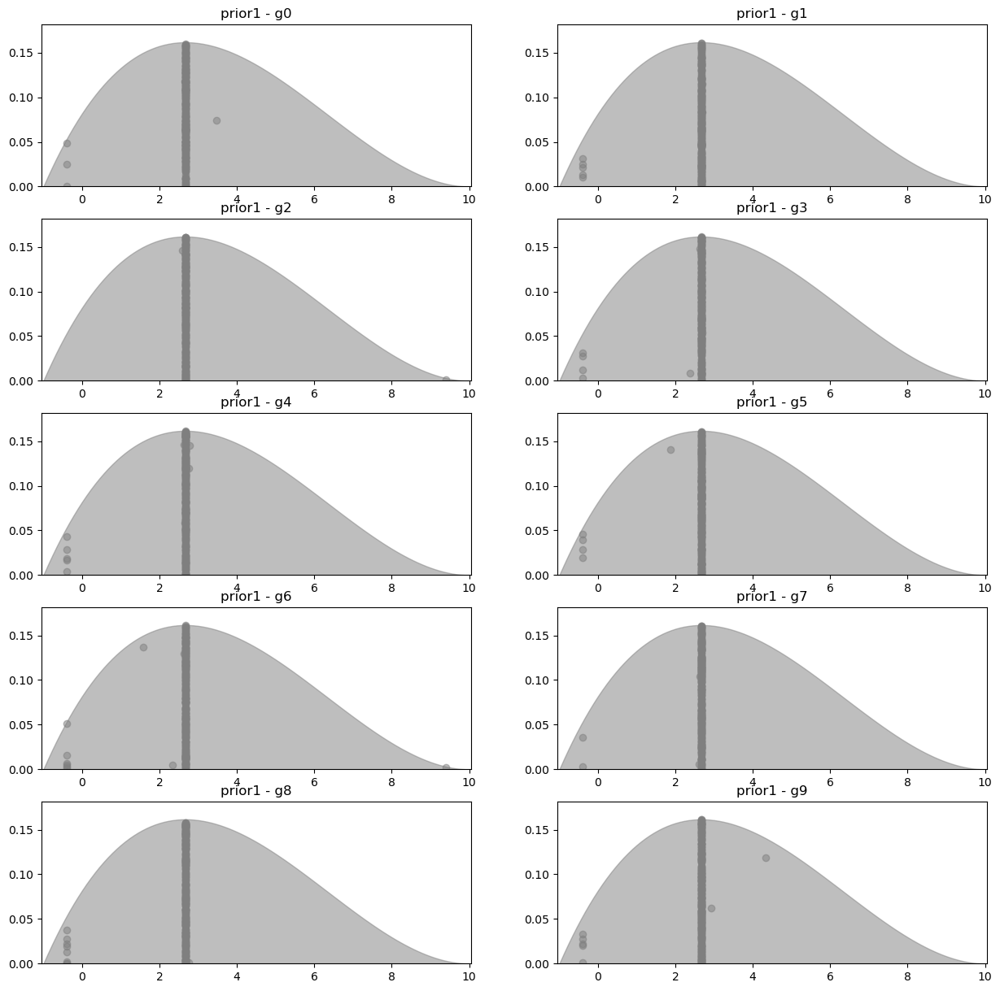

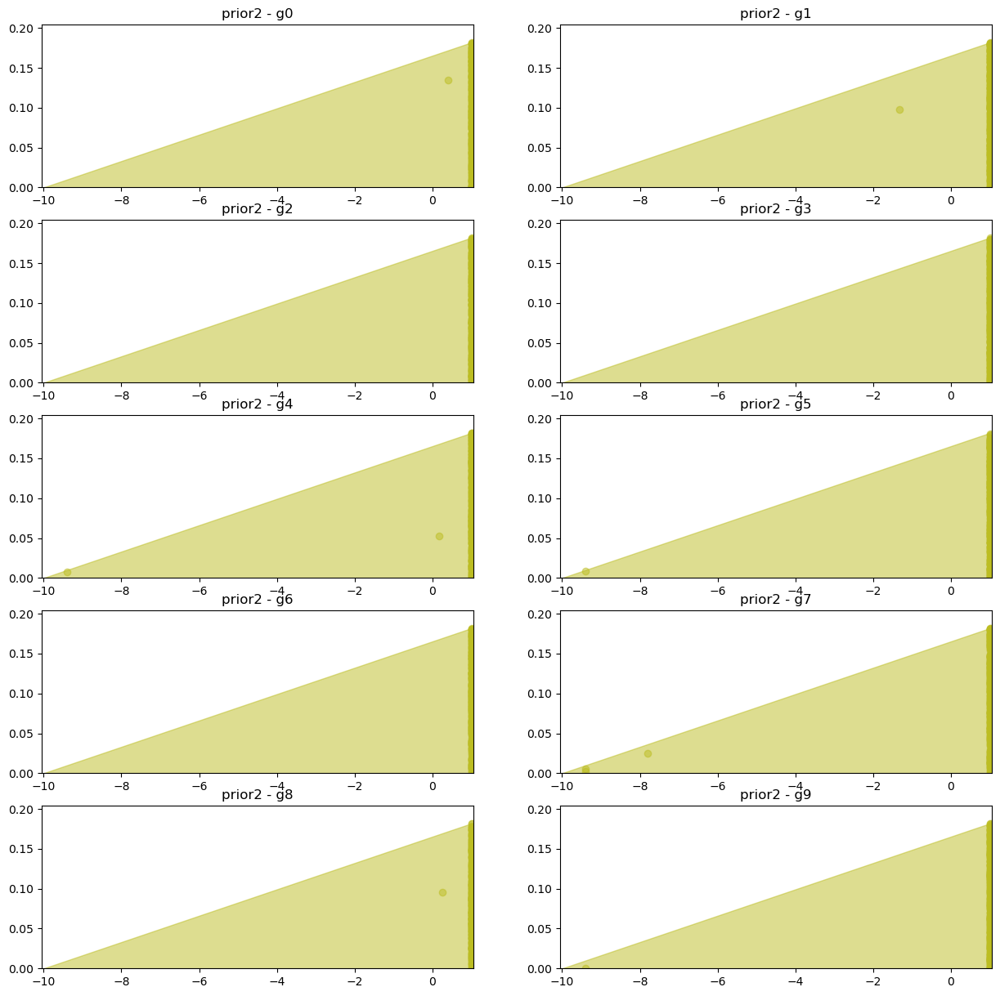

In [158]:
#SGD
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_sgd(300)
tgp.plot_priors(kde=False)

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

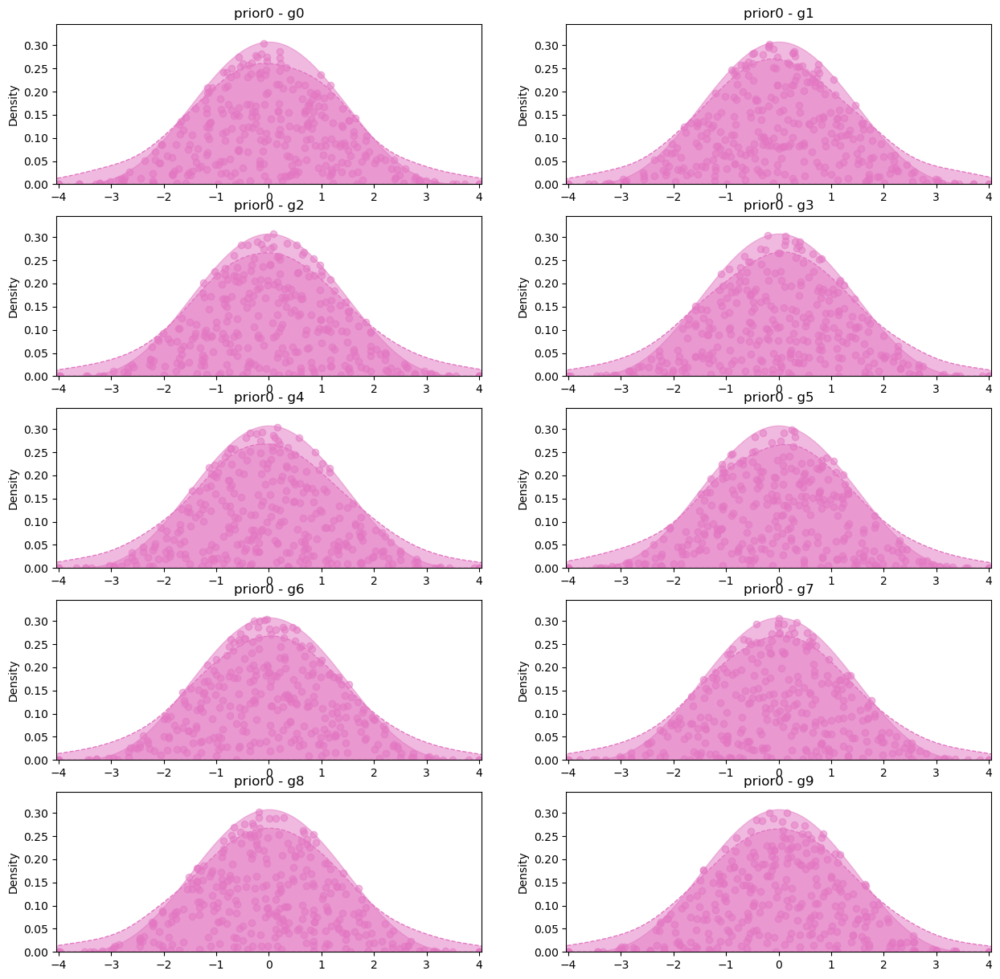

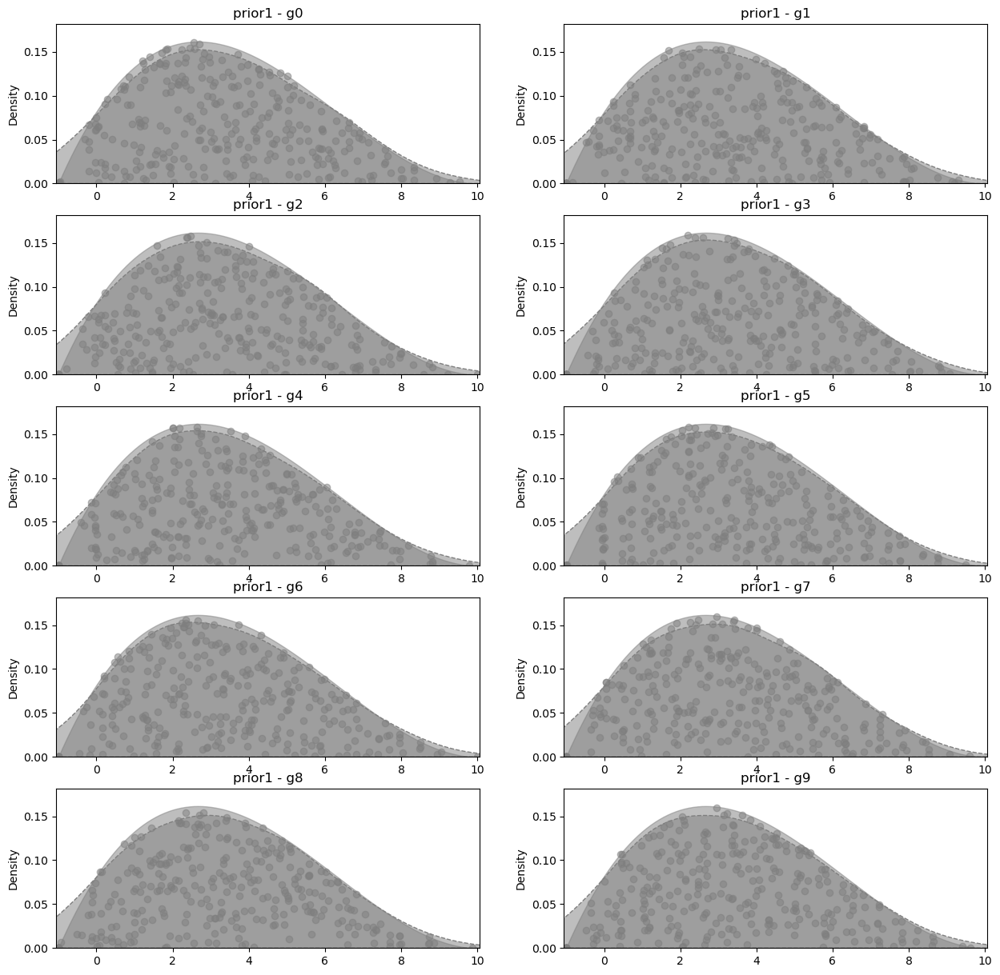

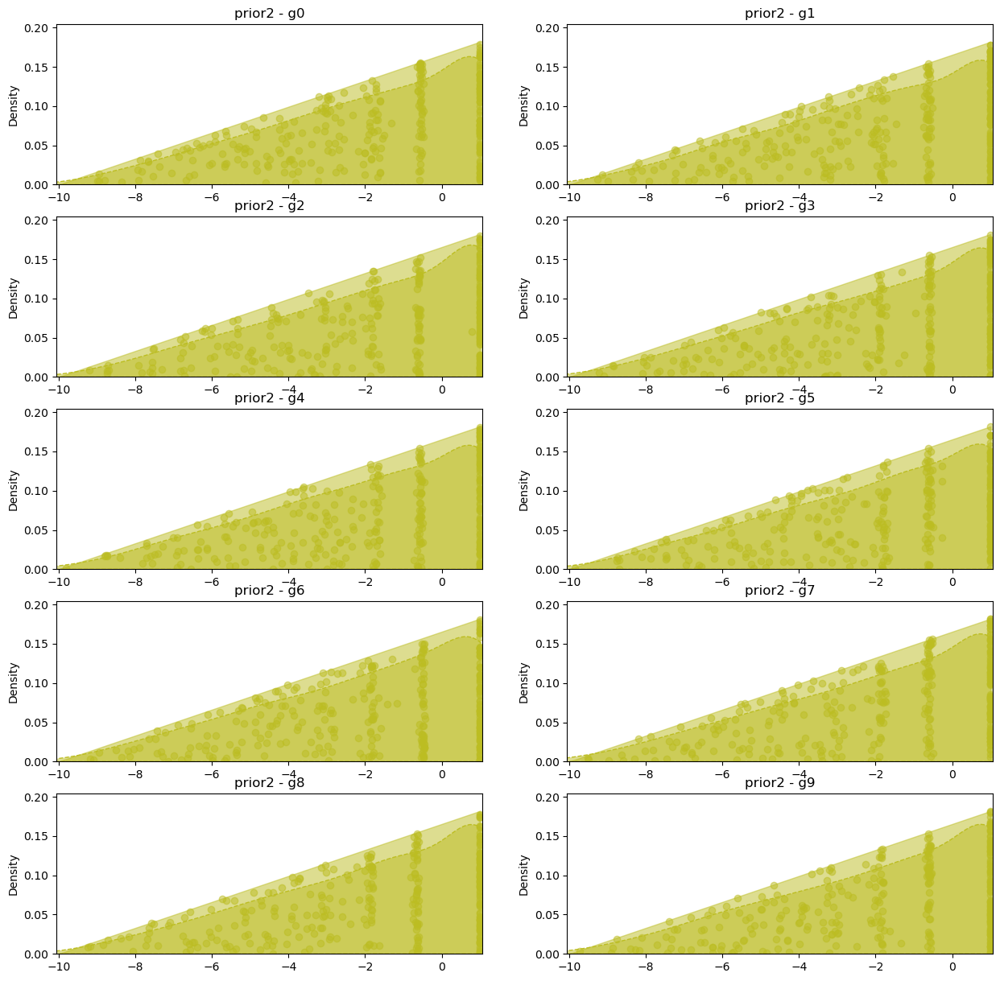

In [159]:
review_dict_GSVGD = learning.review(niters=niters, nreview=nreview, nprior=npriors, ngroup=ngroups, mcmc=False) 
# hay alguna forma que salga las iteraciones totales en vez de 10 en 10 ?
tgp.plot_priors(kde=True)

### GSVGD+MCMC

In [32]:
#SGD
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_sgd(300)
#tgp.plot_priors(kde=False)

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

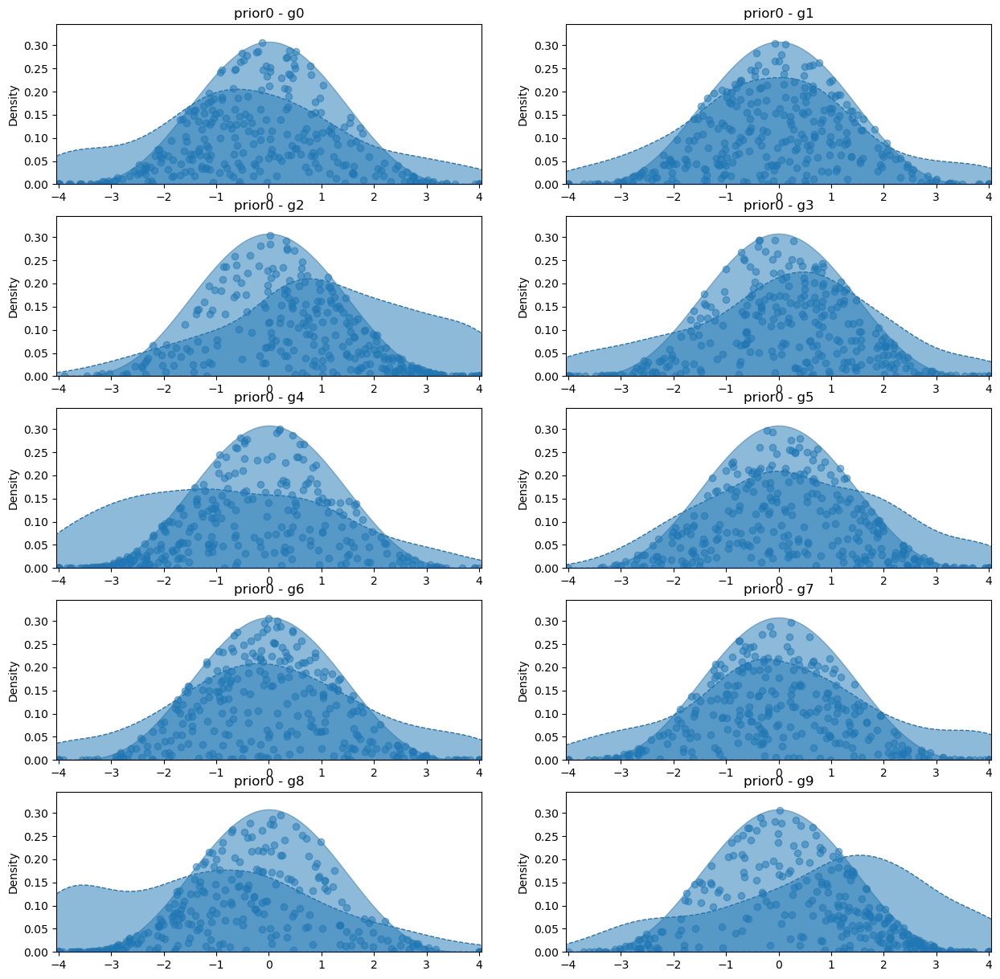

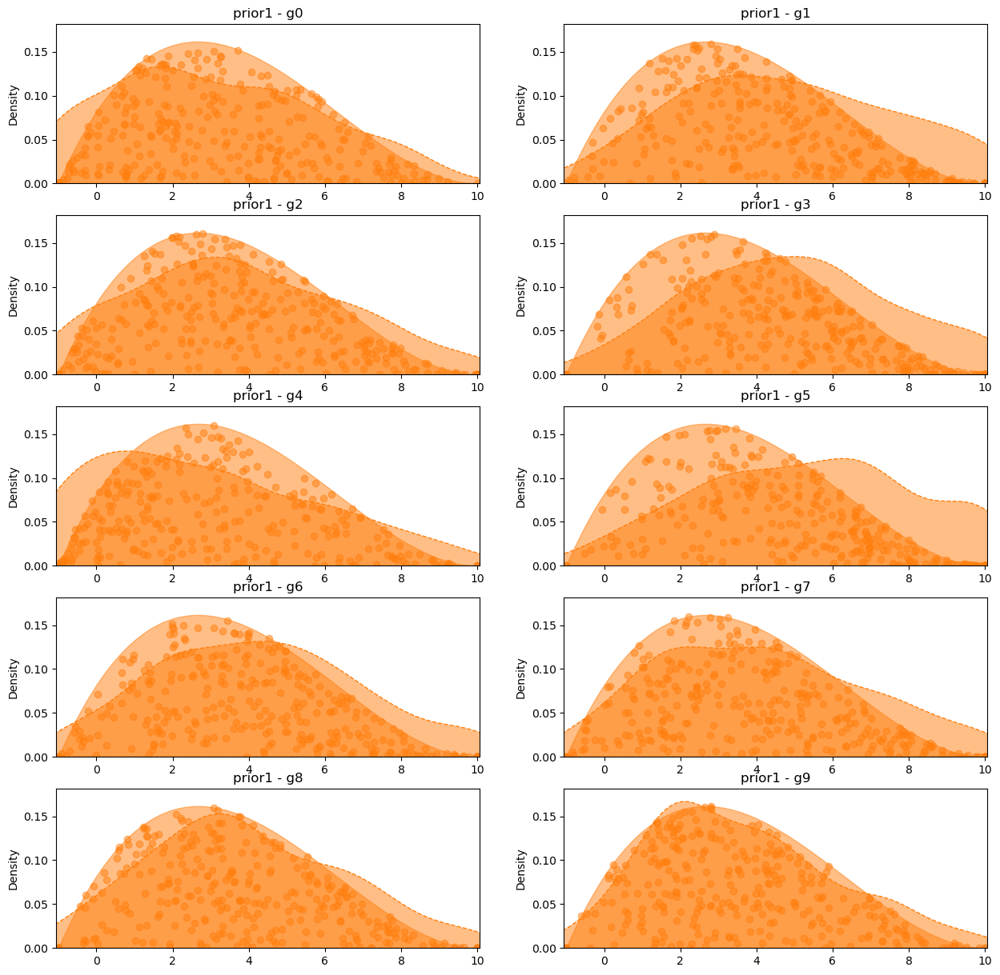

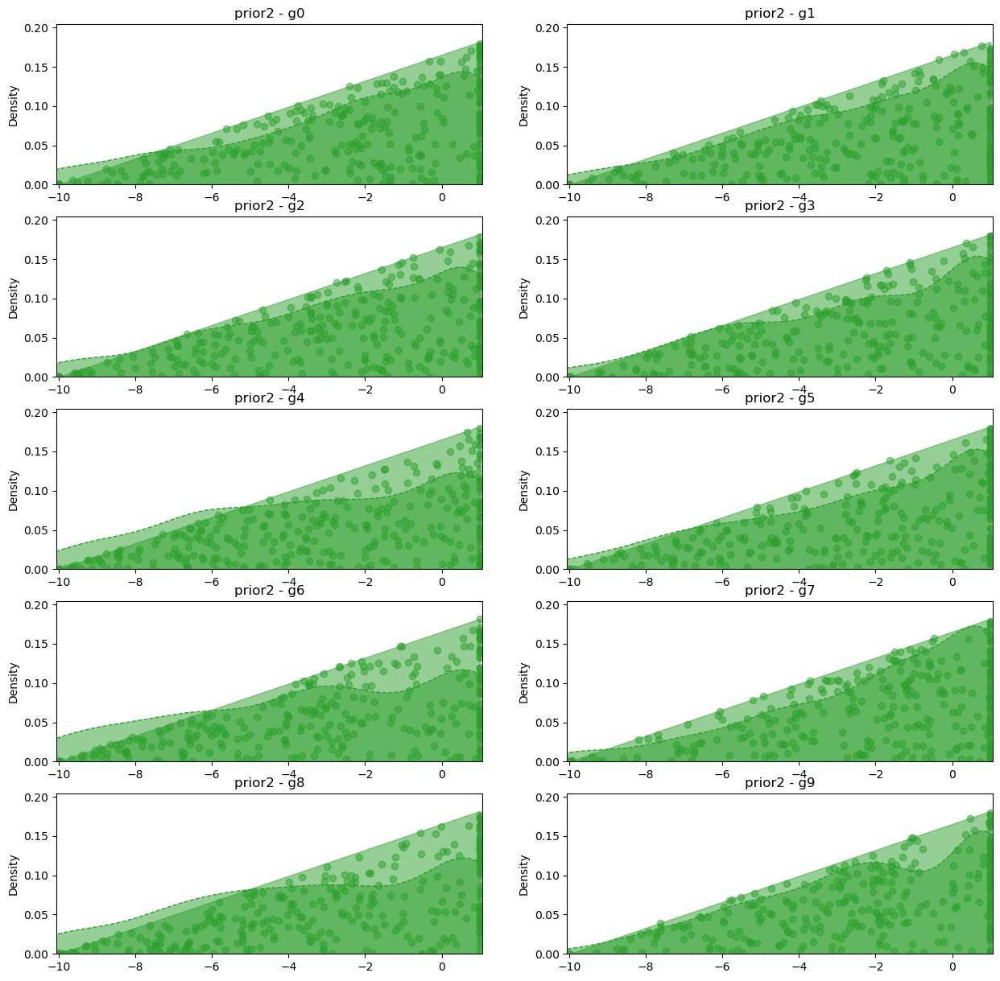

In [33]:
review_dict_SVGDMCMC = learning.review(niters=300, nreview=10, nprior=npriors, ngroup=ngroups, grad_method='stochastic') 
# hay alguna forma que salga las iteraciones totales en vez de 10 en 10 ?
tgp.plot_priors(kde=True)

# presentacion

Introduccion SVGD+MCMC(recordar)
Mostrar paso actualizacion GSVG, mencionar que se van actualizando las proyecciones(O())
Mostrar los 3 entrenamientos.
Despues lo ensambles
Jugar con la cantidad de proyecciones
Conclusion sobre el metodo


Todo en 1 metodo(Nombre por registrar)MCMM, SVGD, GSVGD, suma 

### KS Evolution

In [34]:
rprior = 0
rgroup = 0

#### SVGD

In [25]:
learning.plotKSCDF(theorical=sample_theo, review_dict=review_dict_SVGD, rprior=rprior, rgroup=rgroup, title='SVGD')

NameError: name 'review_dict_SVGD' is not defined

#### GSVGD

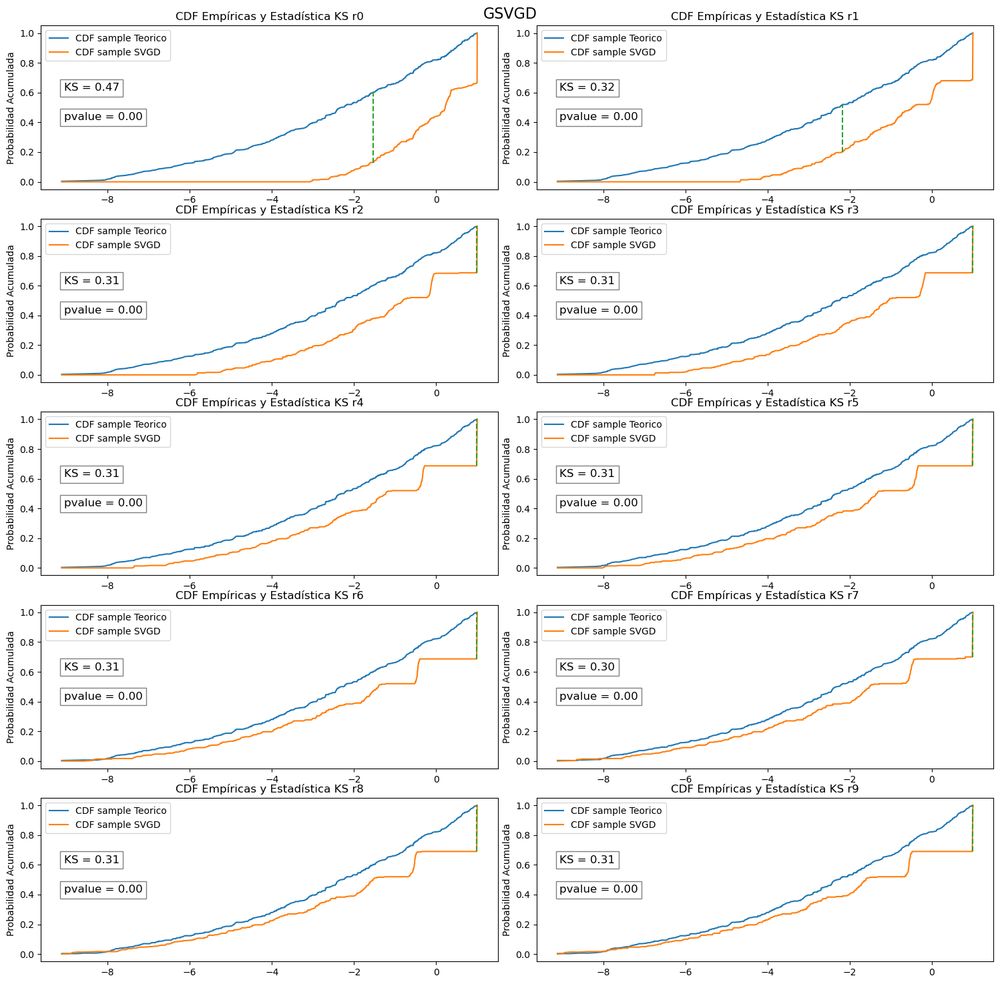

In [164]:
learning.plotKSCDF(theorical=sample_theo, review_dict=review_dict_GSVGD, rprior=rprior, rgroup=rgroup, title='GSVGD')

In [30]:
rprior = 1
rgroup = 0

#### GSVGD+MCMC

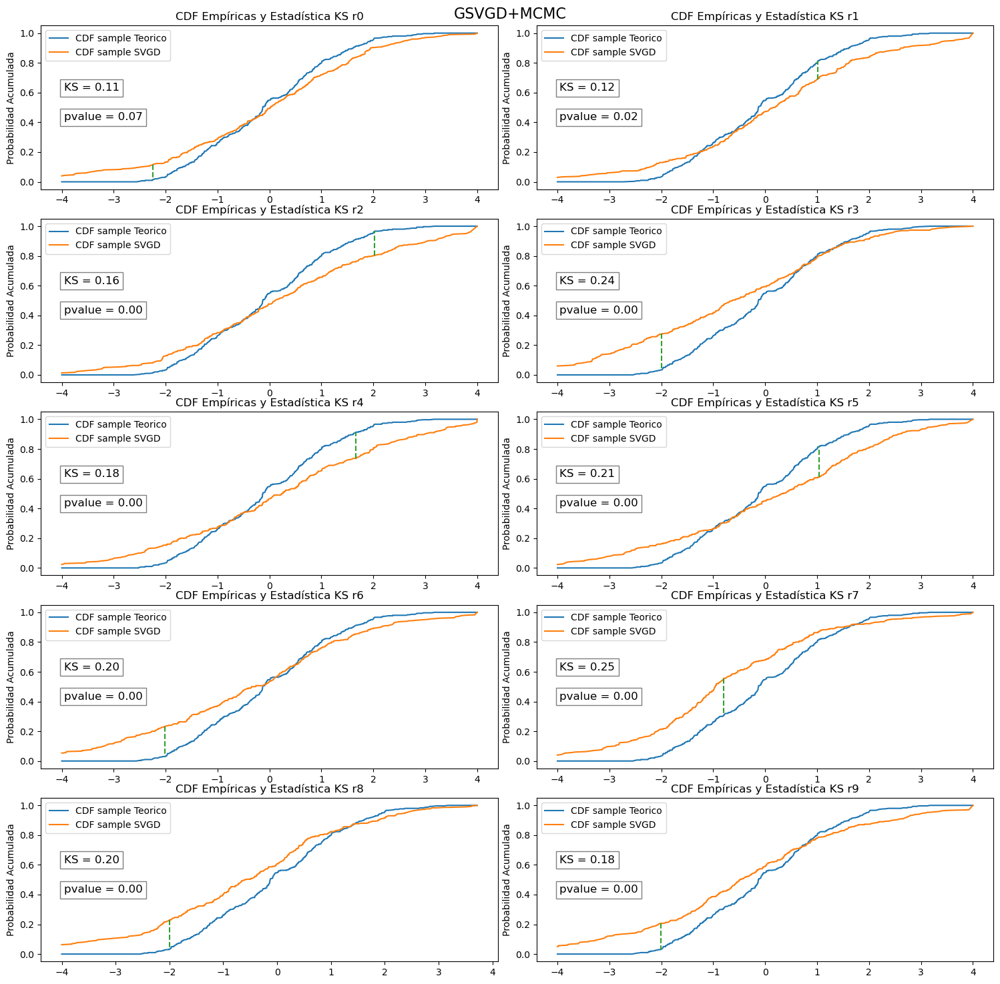

In [35]:
learning.plotKSCDF(theorical=sample_theo, review_dict=review_dict_SVGDMCMC, rprior=rprior, rgroup=rgroup, title='GSVGD+MCMC')

### Ensambles

Borramos el gibbs, el del practicante, dejamos solo con 'el mejor'
depues el execute 2 argumentos, mcmc y/o grassman 

#### Primer ensamble 

In [167]:
#SGD
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_sgd(300)
#tgp.plot_priors(kde=False)

  0%|                                                                                                         …

  0%|                                                                                                         …

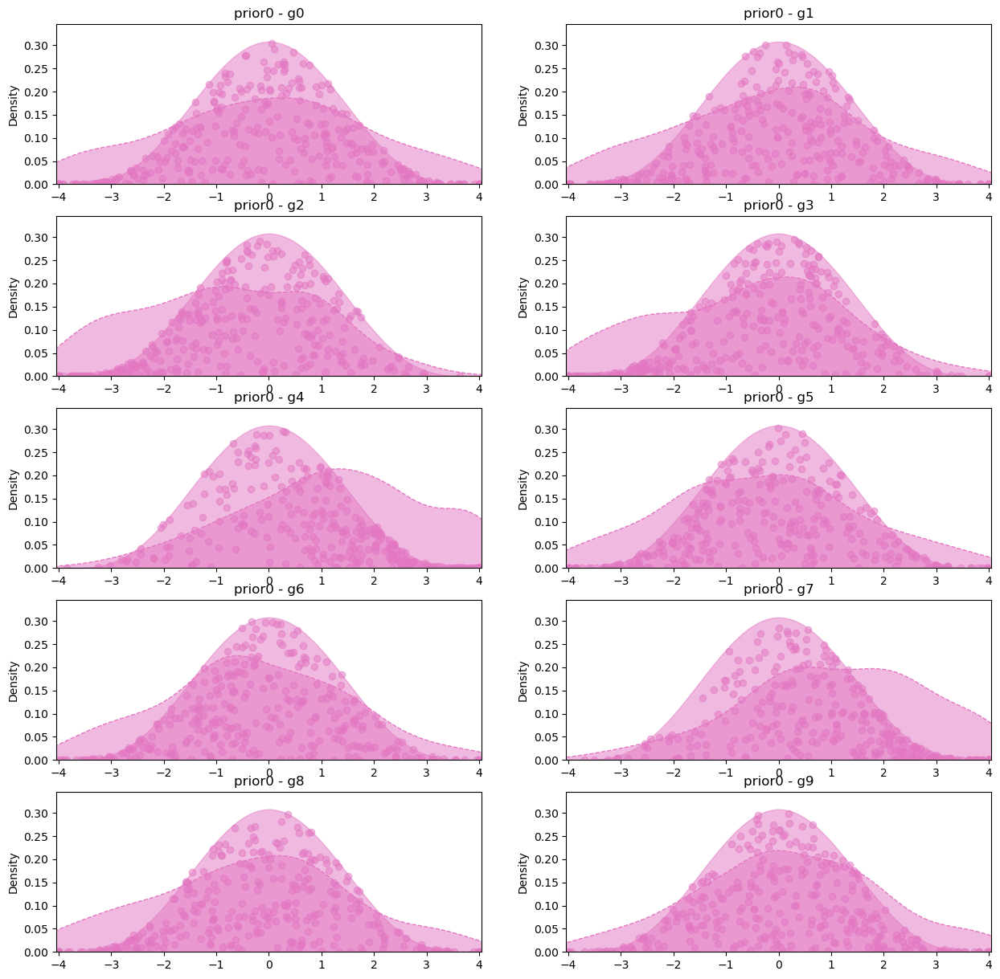

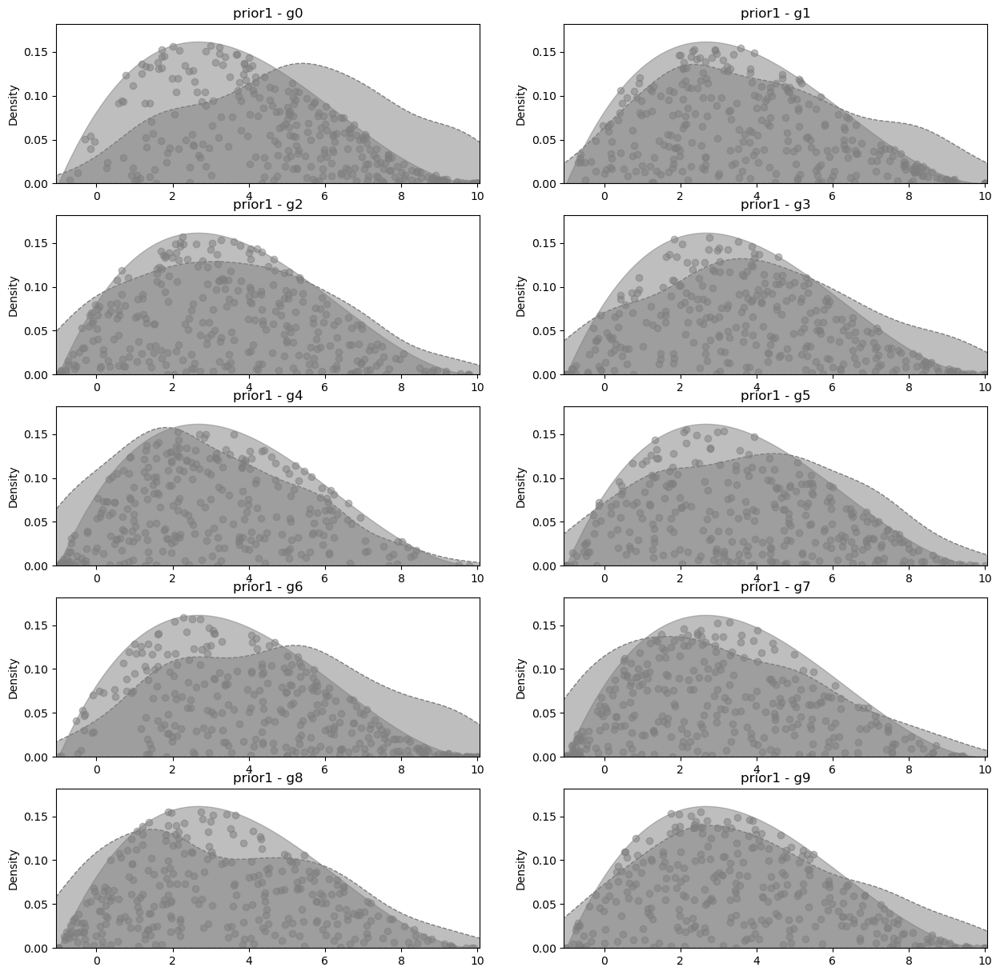

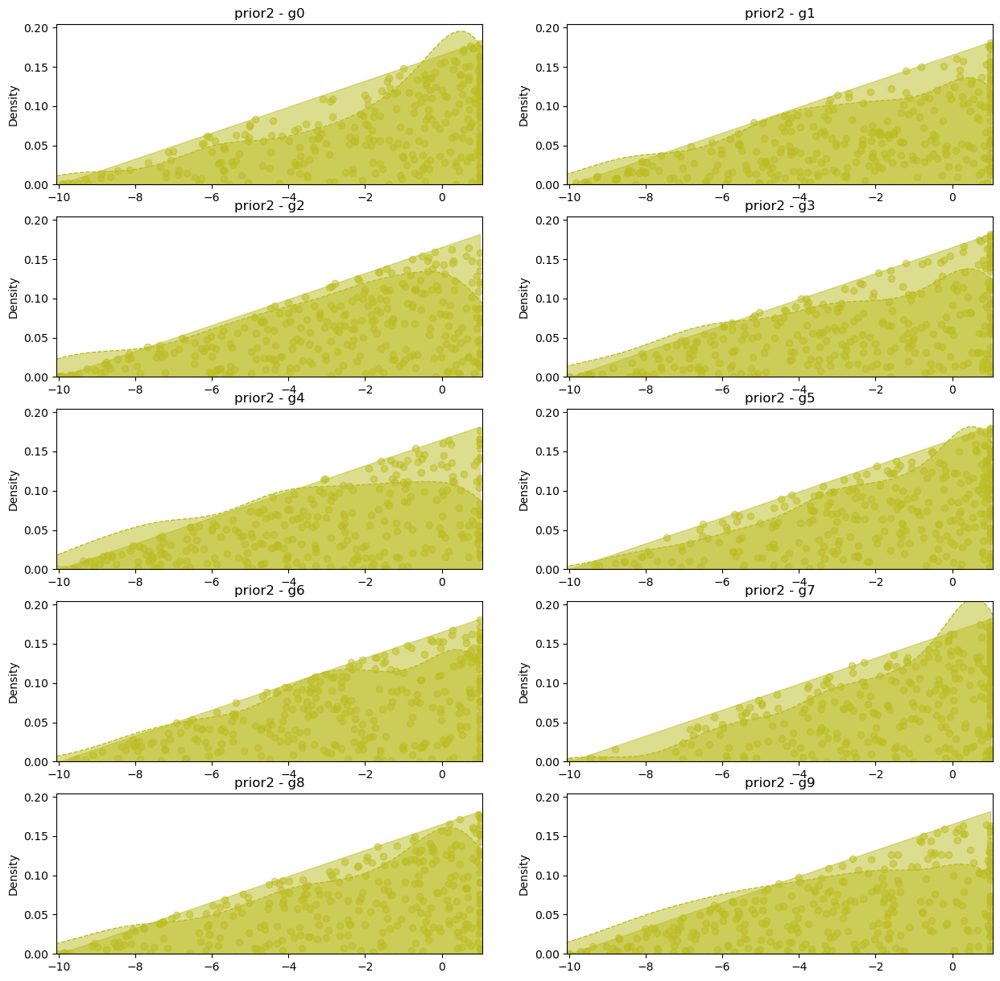

In [168]:
learning.execute_Megasvgd(niters=niters, grad_method='stochastic', gsvgd=True, mcmc=True)
tgp.plot_priors()

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

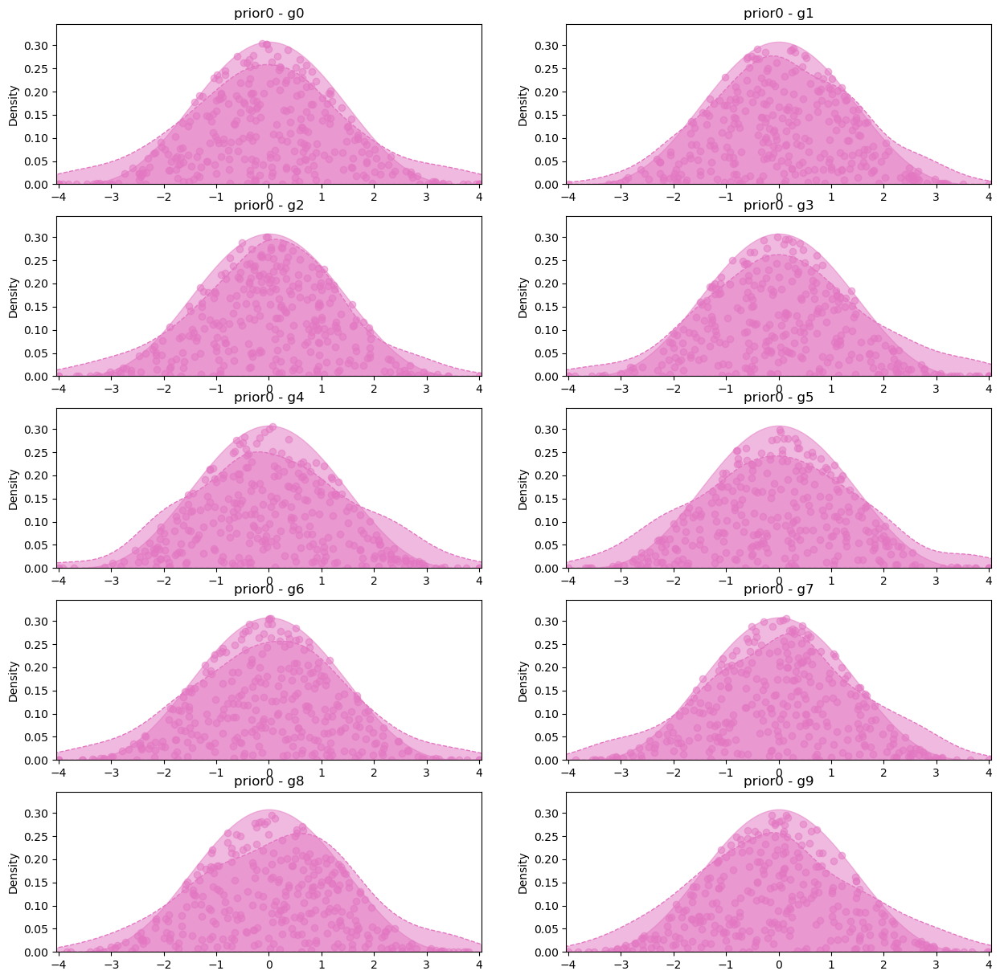

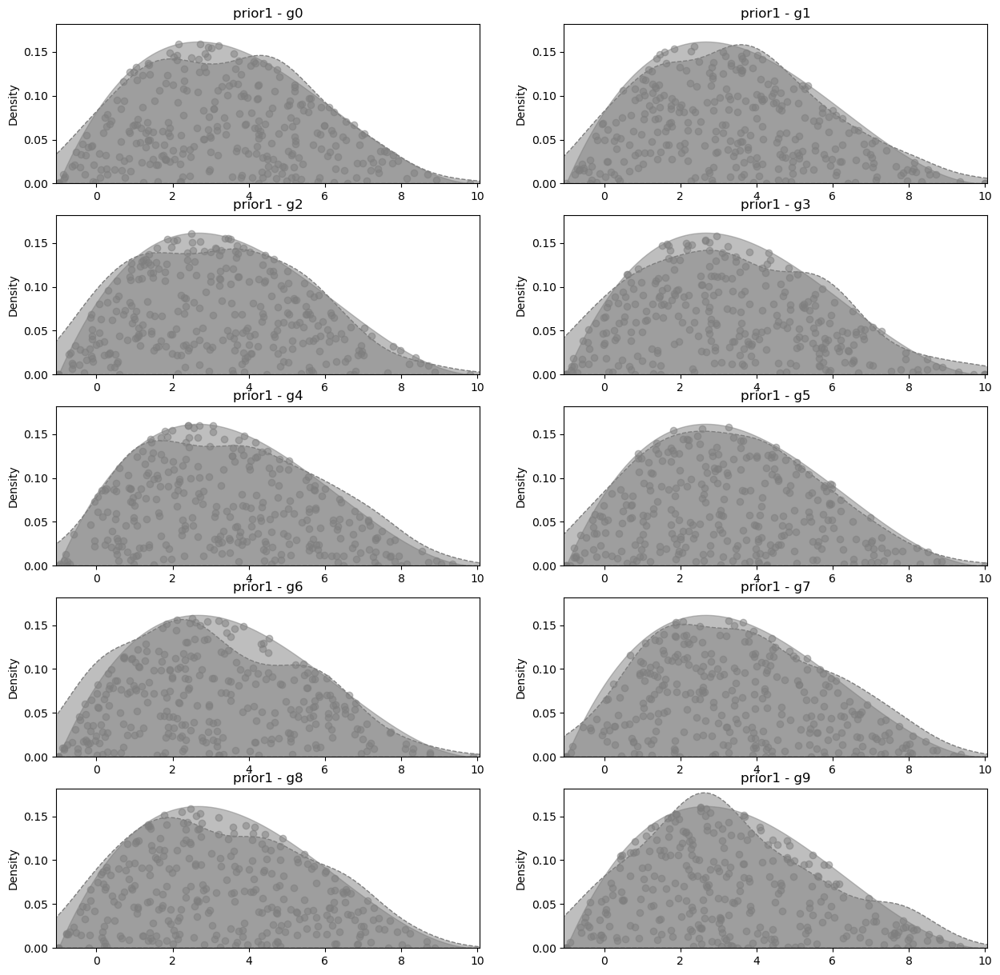

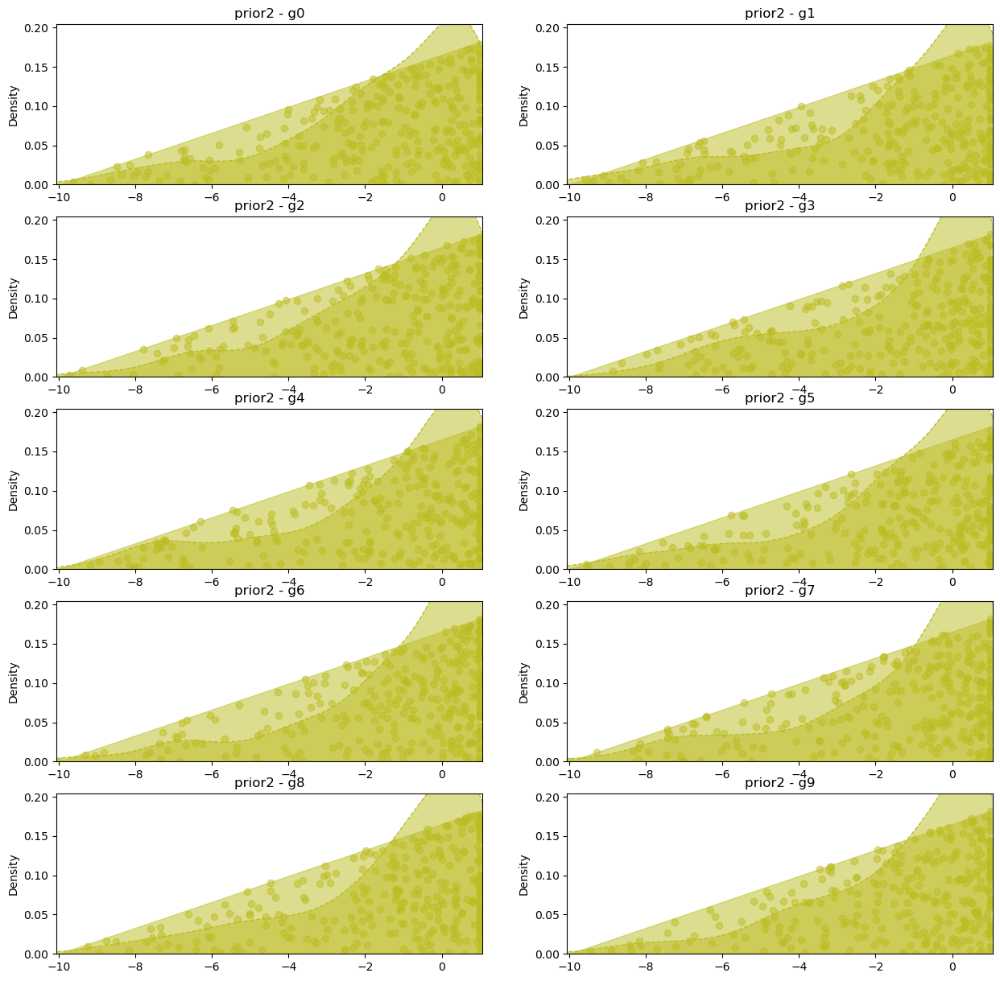

In [169]:
review_dict_proof = learning.review(niters=niters, nreview=10, nprior=npriors, ngroup=ngroups, grassman=False) 
tgp.plot_priors()

In [186]:
rprior = 0
rgroup = 0

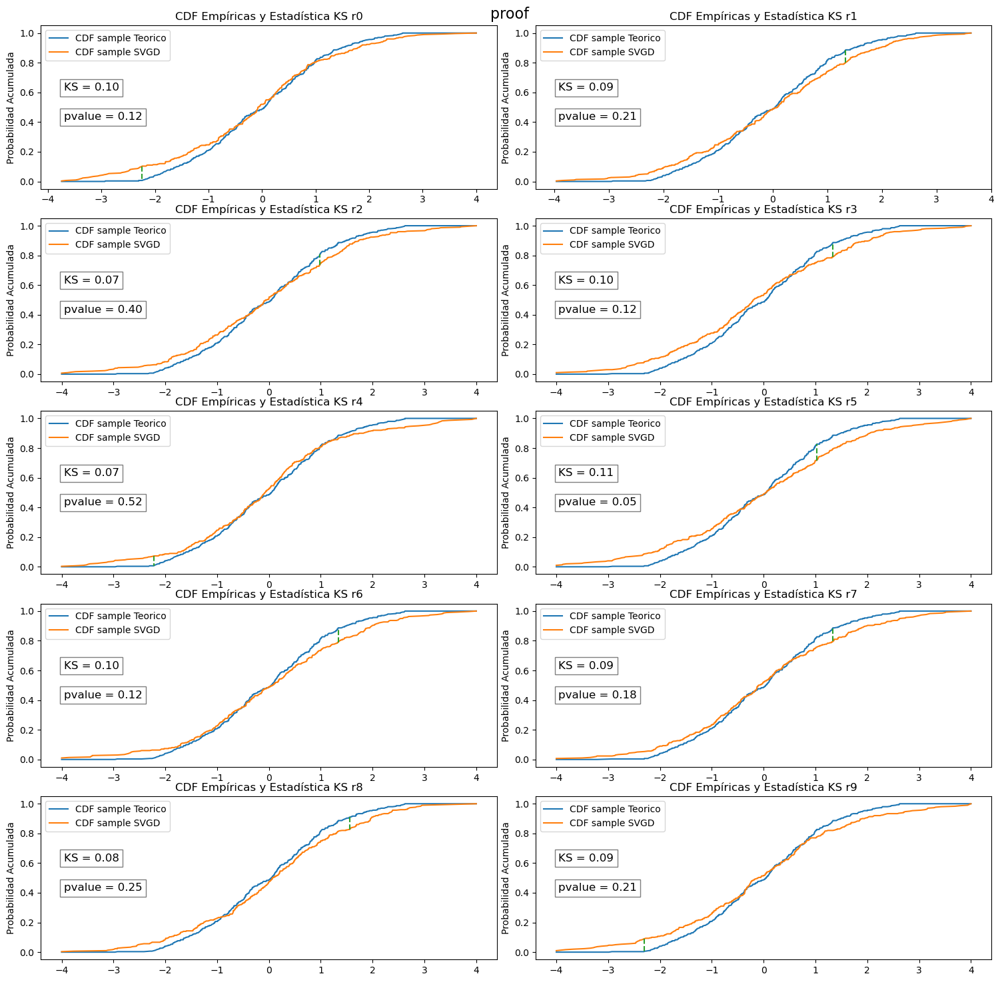

In [187]:
learning.plotKSCDF(theorical=sample_theo, review_dict=review_dict_proof, rprior=rprior, rgroup=rgroup, title='proof')

#### Segundo ensamble 

In [198]:
#SGD
learning = tg.TgLearning(tgp, lr=0.1)
learning.execute_sgd(300)
#tgp.plot_priors(kde=False)

  0%|                                                                                                         …

  0%|                                                                                                         …

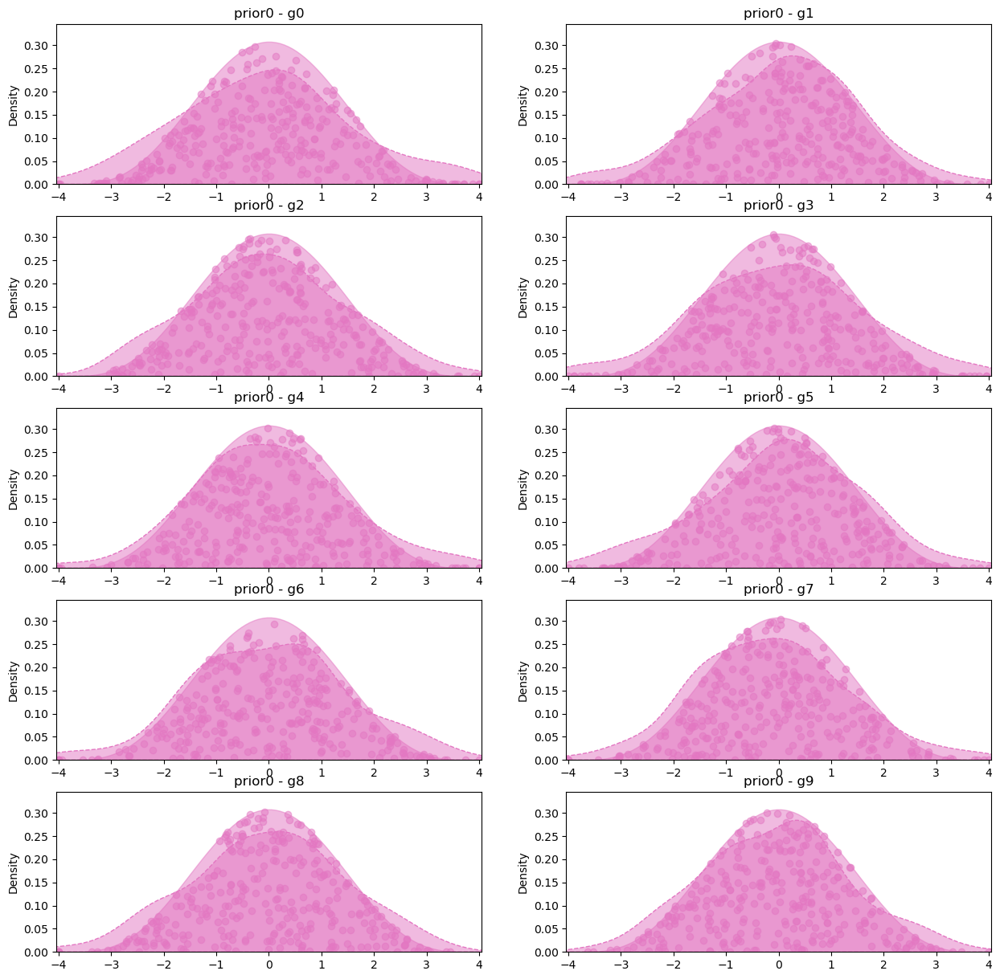

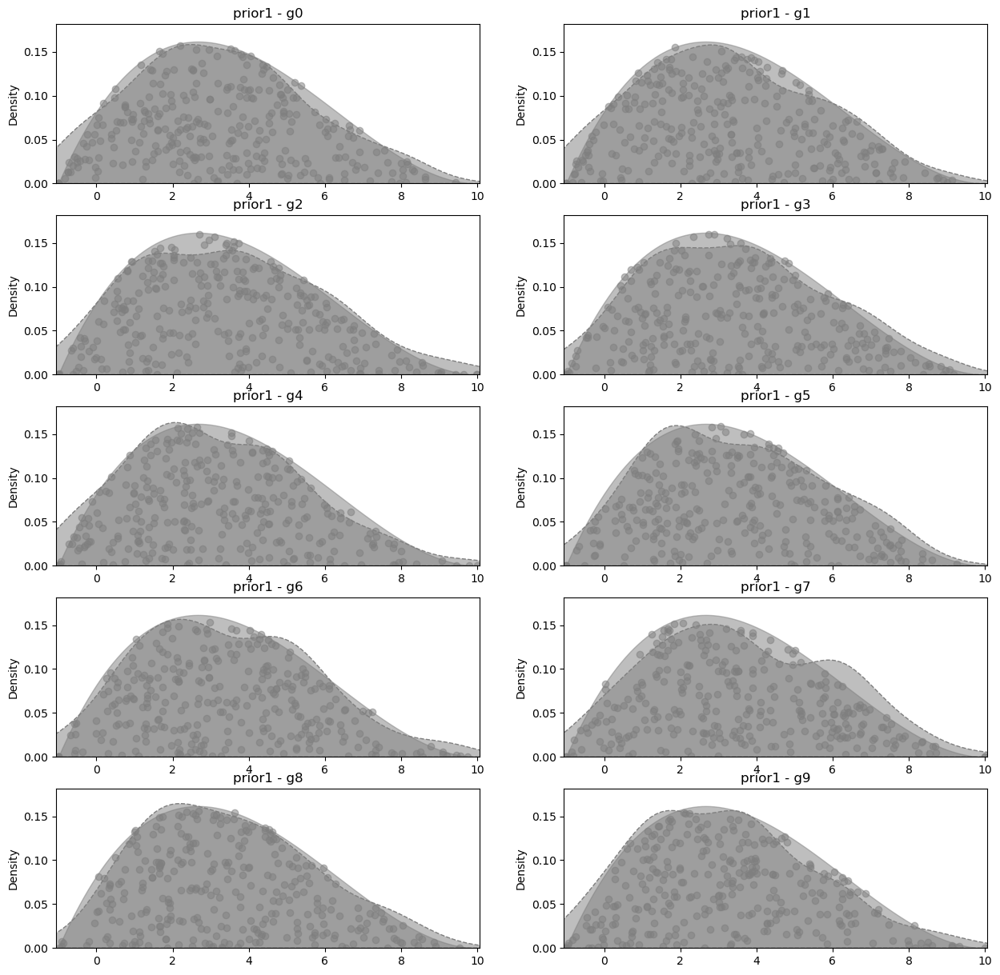

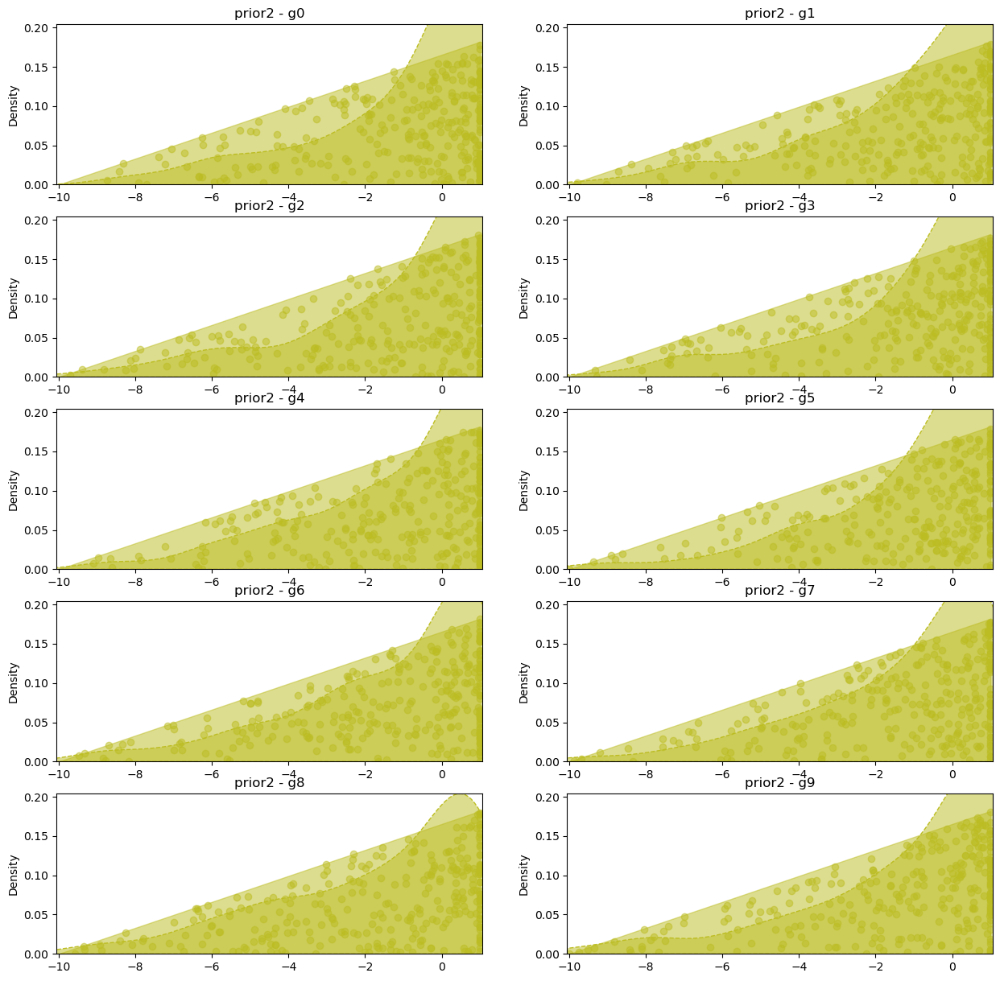

In [208]:
learning.execute_Megasvgd(300, grad_method='stochastic', gsvgd=False, mcmc=True)
tgp.plot_priors()

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

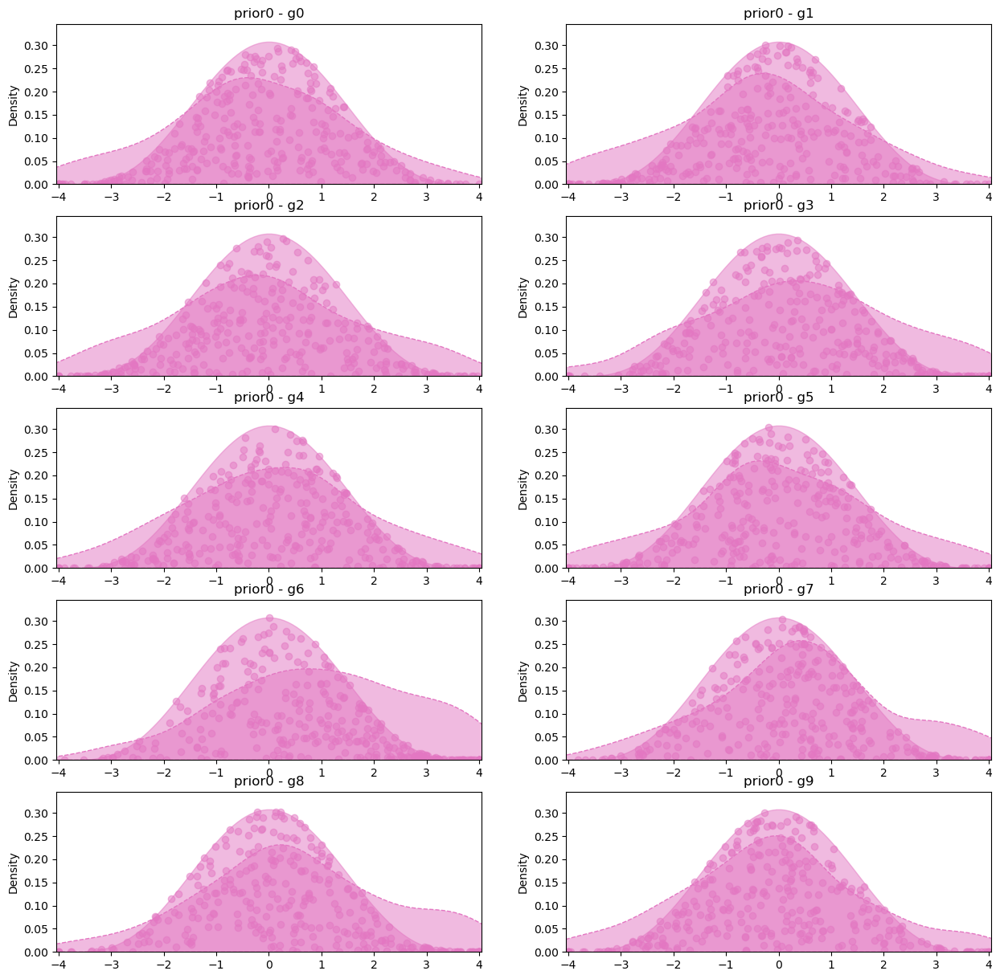

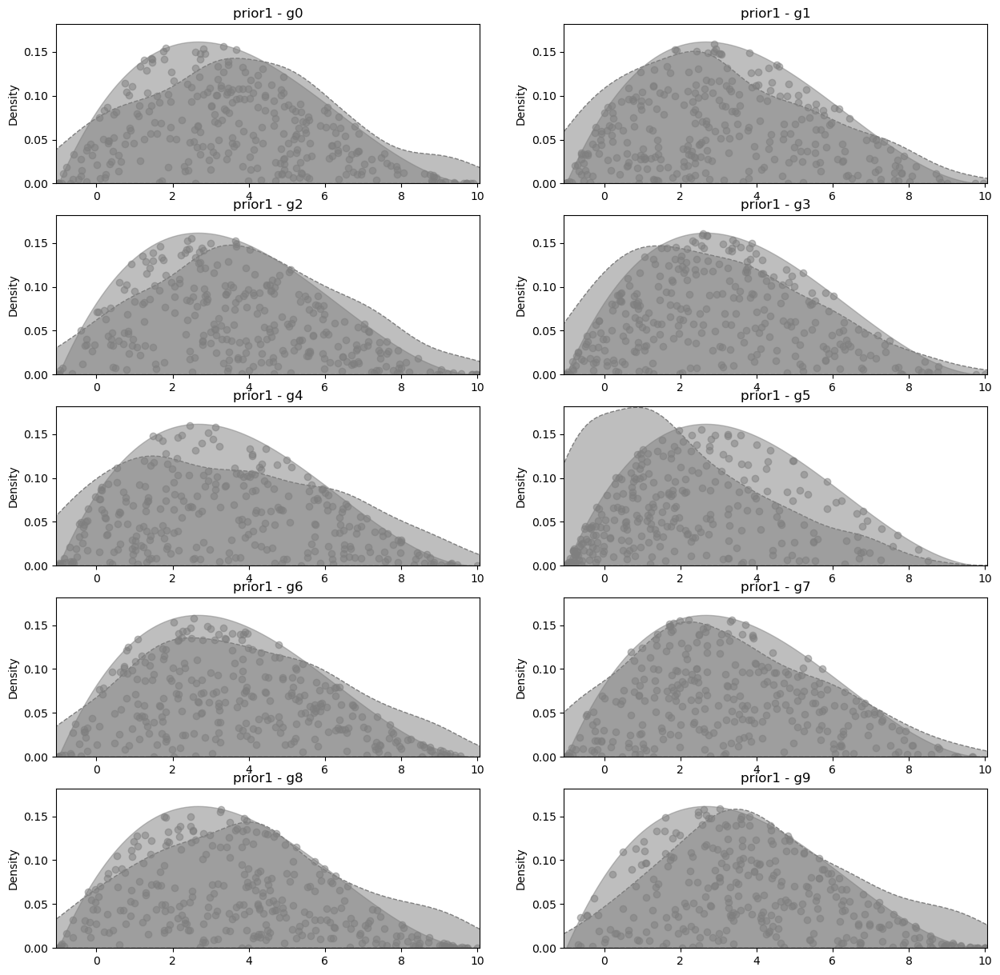

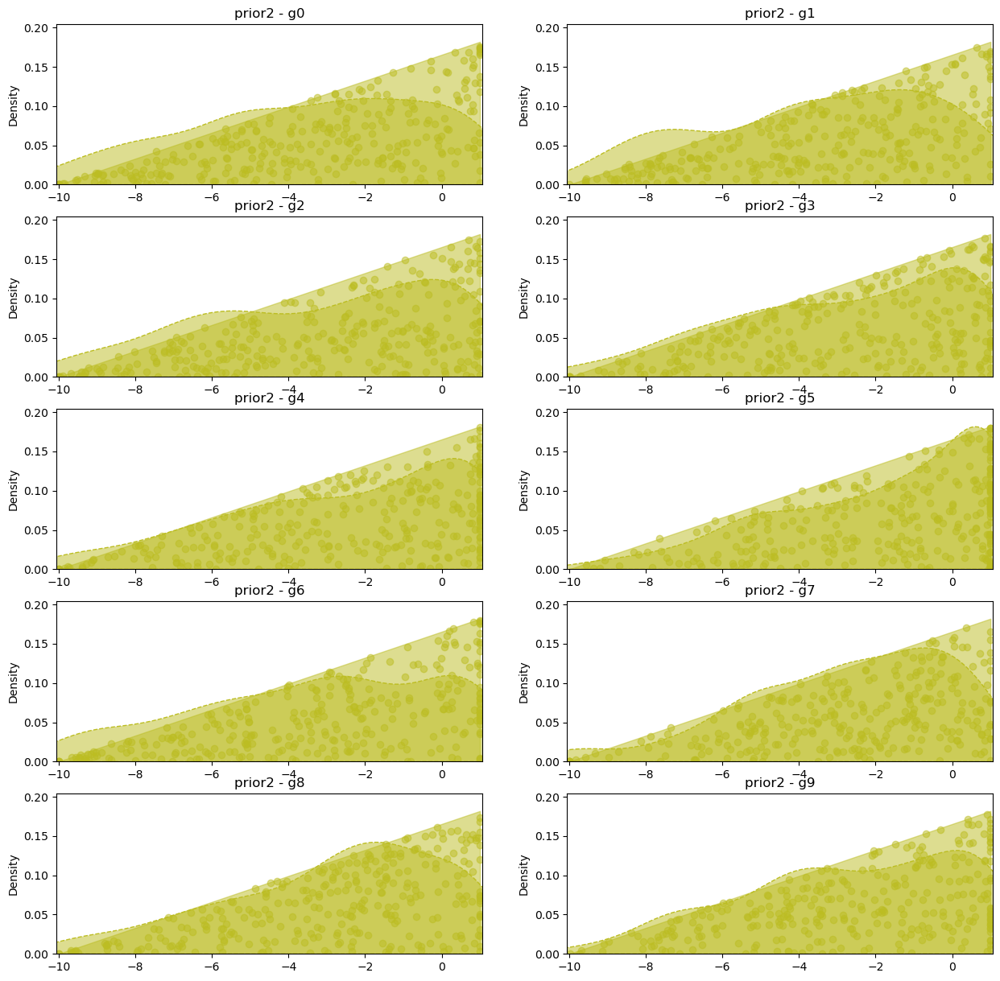

In [209]:
review_dict_proof2 = learning.review(niters=niters, nreview=20, nprior=npriors, ngroup=ngroups) 
tgp.plot_priors()

In [217]:
rprior = 0
rgroup = 0

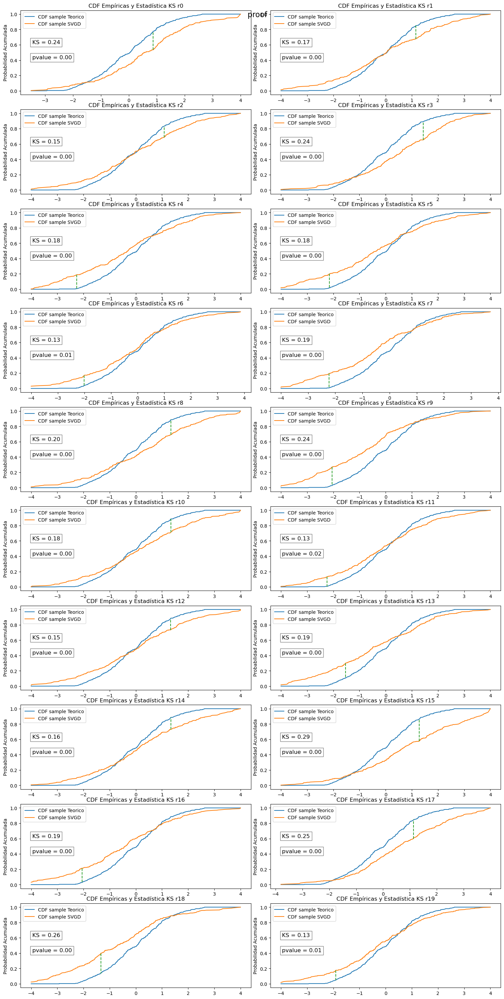

In [218]:
learning.plotKSCDF(theorical=sample_theo, review_dict=review_dict_proof2, rprior=rprior, rgroup=rgroup, title='proof')

### Pruebas de Gibbs Plot KS CDF, IGNORAR

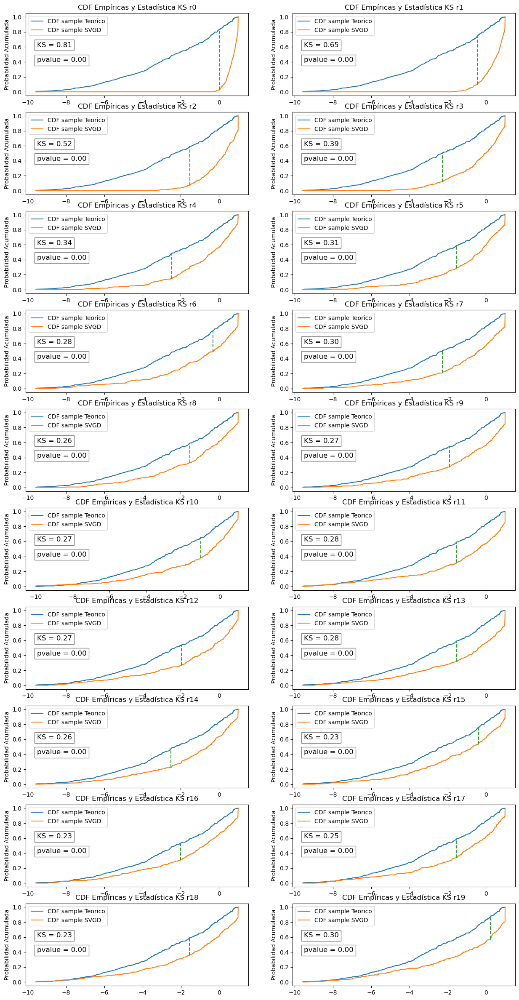

In [24]:
learning.plotKSCDF(theorical=sample_theo, review_dict=review_dict_SVGDMCMC, rprior=rprior, rgroup=rgroup)

### SVGD+Gibbs

In [9]:
#SGD
learning.execute_sgd(300)
#tgp.plot_priors(kde=False)

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

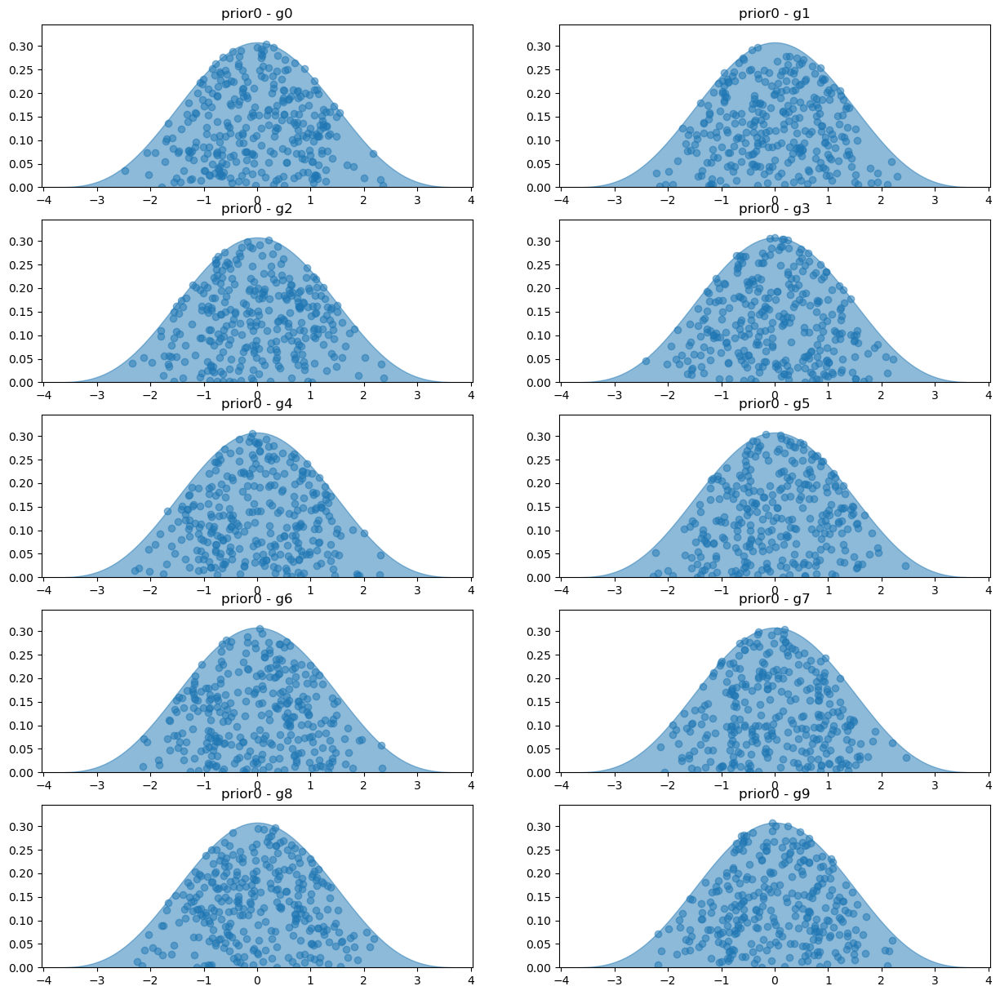

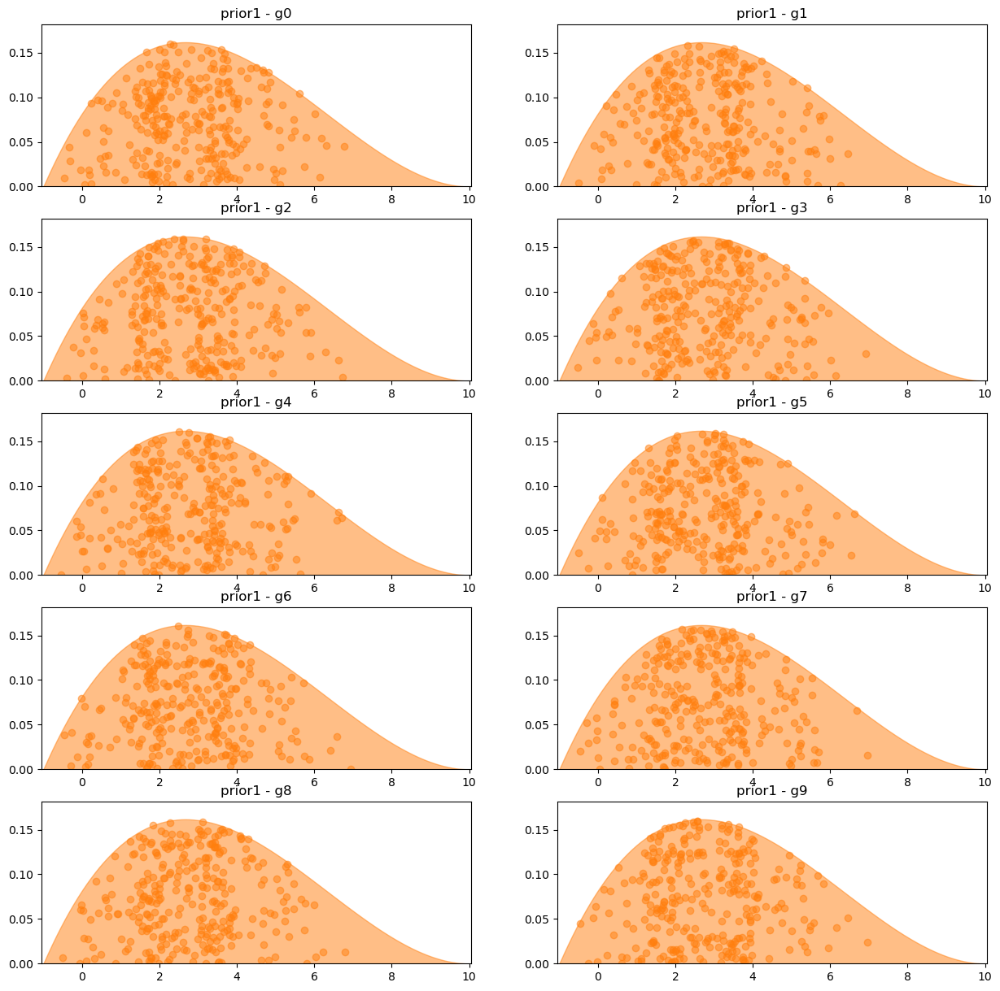

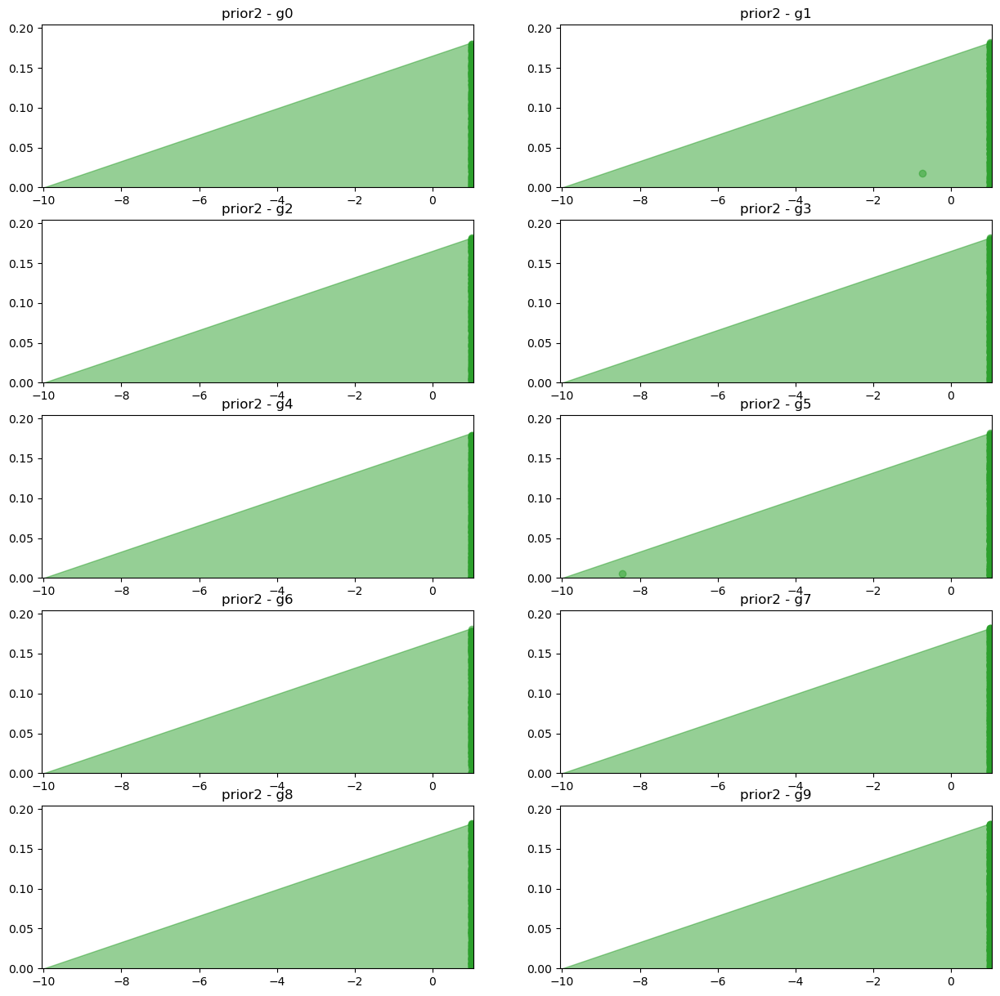

In [10]:
review_dict_SVGDGibbs = learning.review(niters=niters, nreview=nreview, nprior=npriors, ngroup=ngroups, method='gsvgd', mcmc=False) 
# hay alguna forma que salga las iteraciones totales en vez de 10 en 10 ?
tgp.plot_priors(kde=False)

#### Plot KS CDF

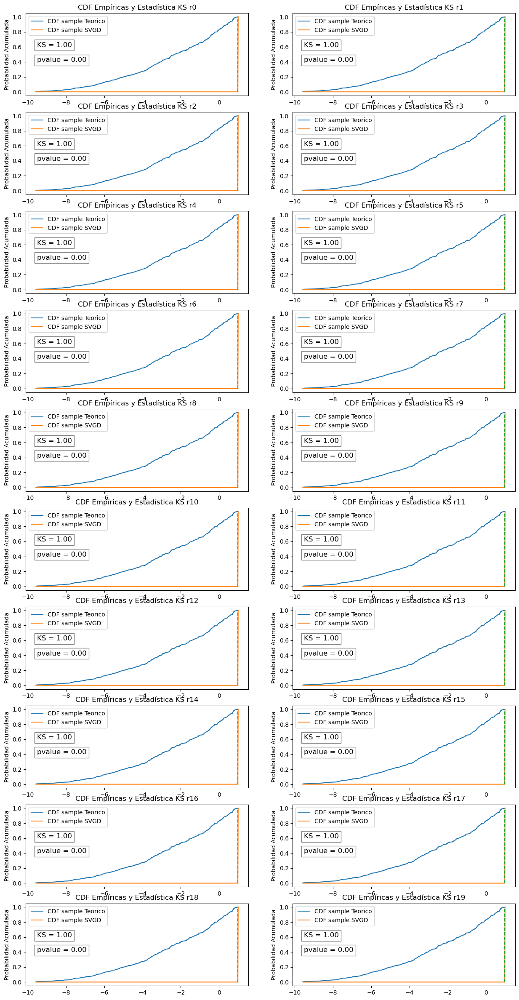

In [11]:
learning.plotKSCDF(theorical=sample_theo, review_dict=review_dict_SVGDGibbs, rprior=rprior, rgroup=rgroup)

### SVGD+MCMC+Gibbs

In [12]:
#SGD
learning.execute_sgd(300)
#tgp.plot_priors(kde=False)

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

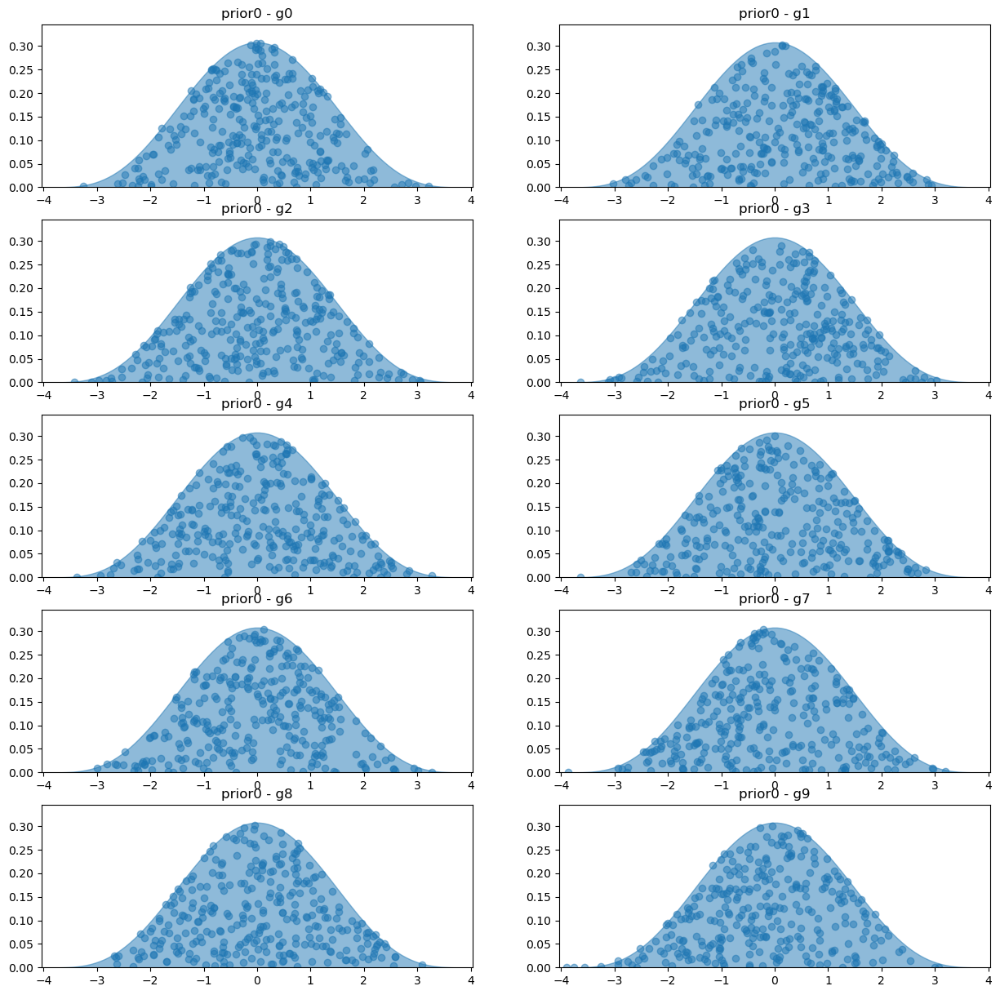

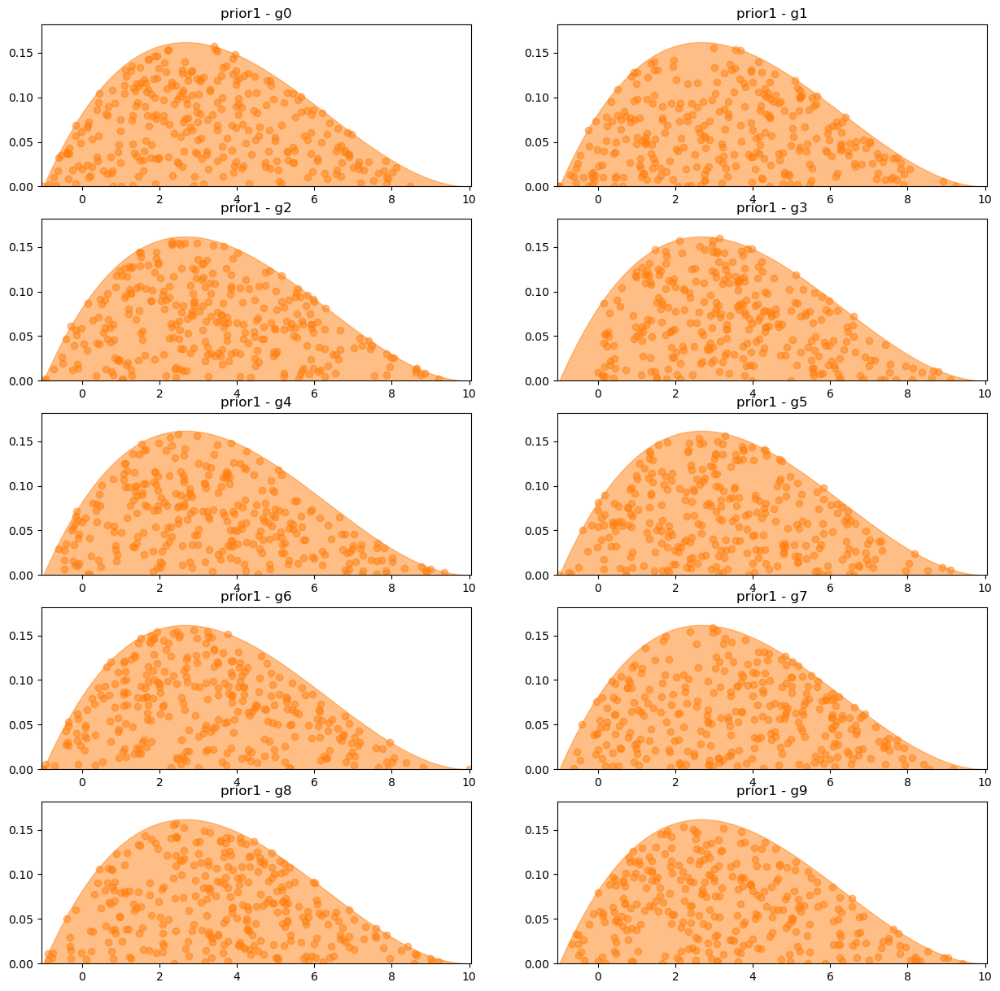

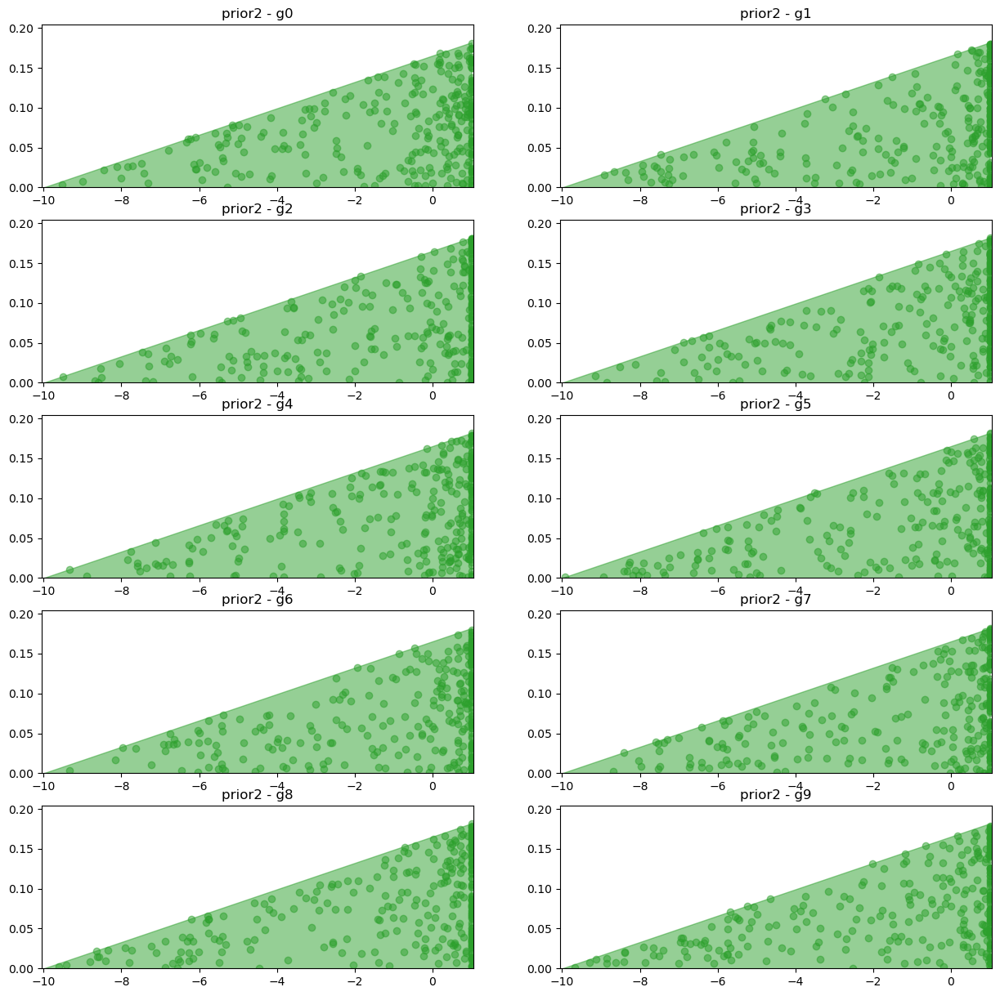

In [13]:
review_dict_SVGDMCMCGibbs = learning.review(niters=niters, nreview=nreview, nprior=npriors, ngroup=ngroups, method='gsvgd') 
# hay alguna forma que salga las iteraciones totales en vez de 10 en 10 ?
tgp.plot_priors(kde=False)

#### Plot KS CDF

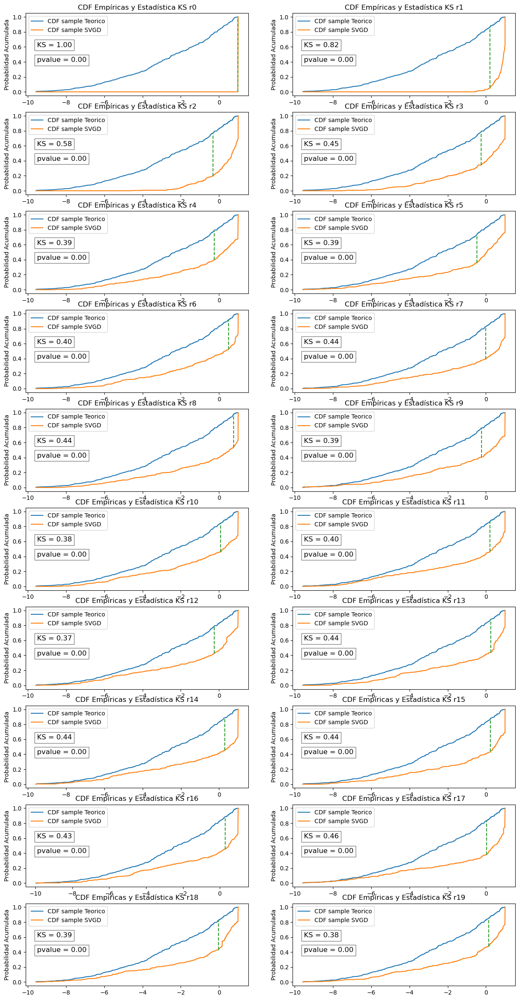

In [14]:
learning.plotKSCDF(theorical=sample_theo, review_dict=review_dict_SVGDMCMCGibbs, rprior=rprior, rgroup=rgroup)

### SVGD+MCMC => SVGD+Gibbs+MCMC

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

  0%|                                                                                                         …

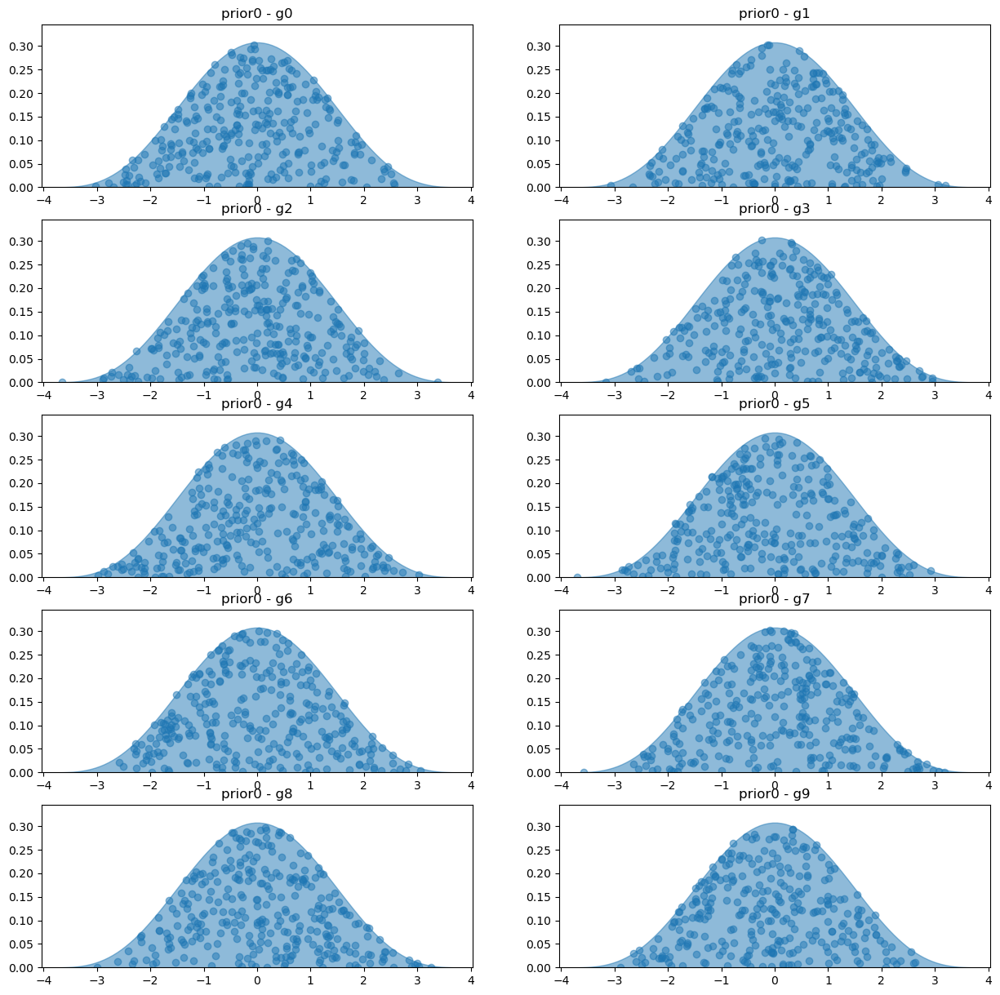

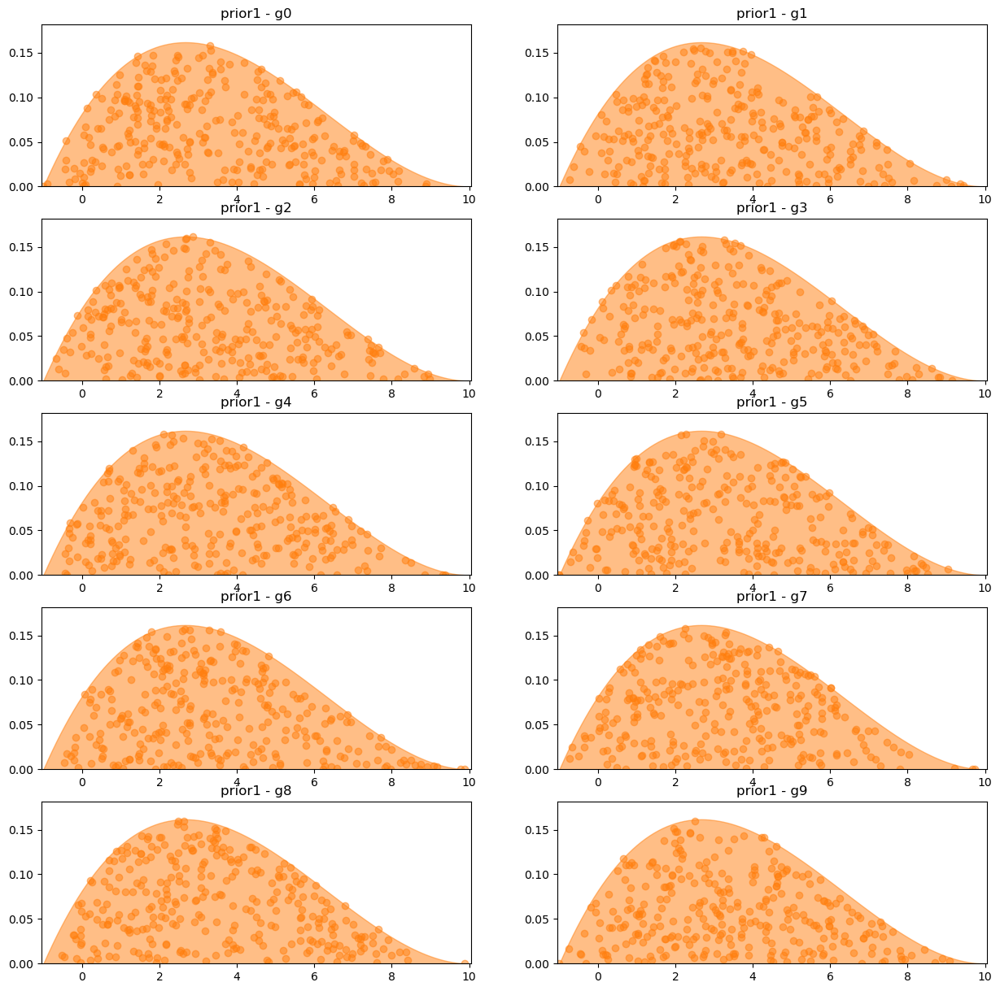

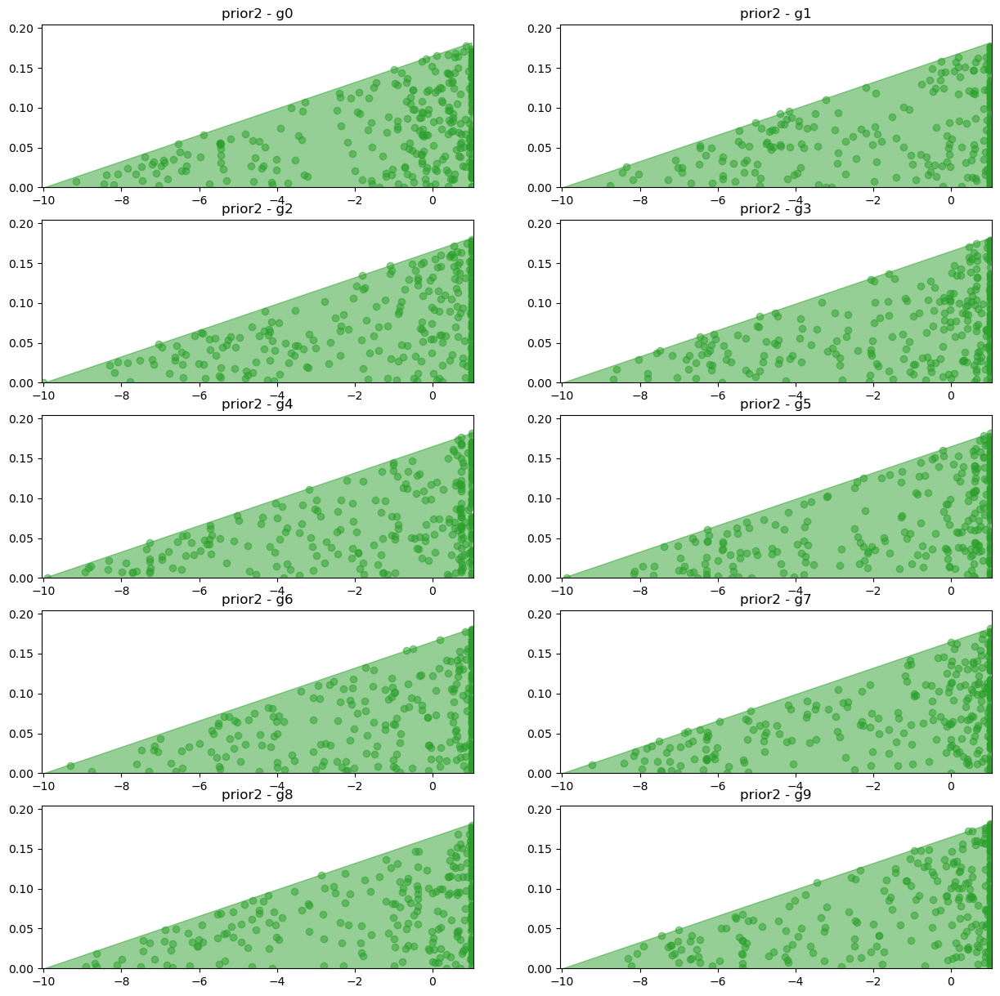

In [25]:
#SGD
learning.execute_sgd(300)
#tgp.plot_priors(kde=False)
learning.execute_gbsvgd(niters, gibbs=False)
review_dict_SVGDMCMC_SVGDGibbs = learning.review(niters=niters, nreview=nreview, nprior=npriors, ngroup=ngroups, method='gsvgd', mcmc=True) 
tgp.plot_priors(kde=False)

In [26]:
# KS = 0 
# while KS <=0.5:
#     learning = tg.TgLearning(tgp, lr=0.1)
#     learning.execute_sgd(300)
#     review_dict = learning.review(niters=niters, nreview=nreview, nprior=npriors, ngroup=ngroups, gibbs=False) 
#     KS = learning.plotKSCDF(theorical=sample_theo, review_dict=review_dict, rprior=0, rgroup=0)
# tgp.plot_priors(kde=False)


In [29]:
rprior = 2
rgroup = 0 

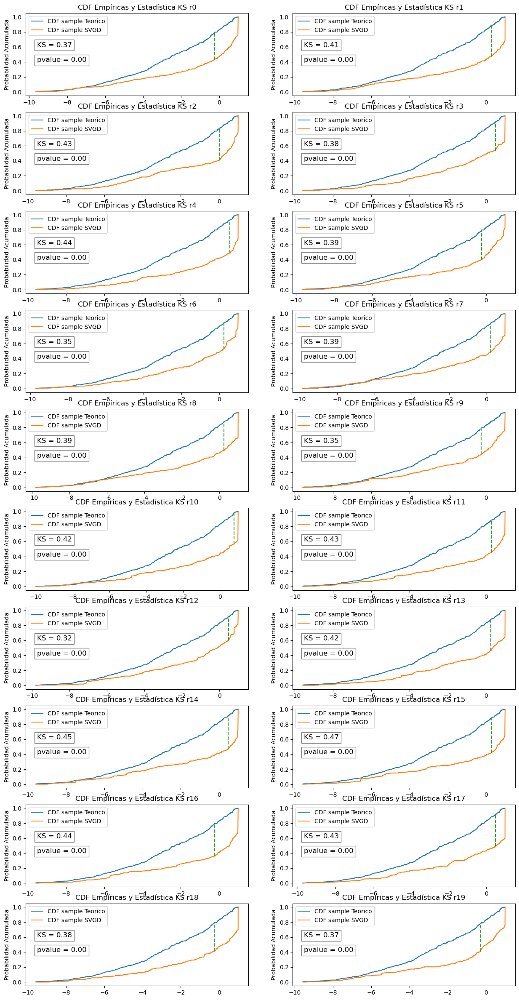

In [30]:
learning.plotKSCDF(theorical=sample_theo, review_dict=review_dict_SVGDMCMC_SVGDGibbs, rprior=rprior, rgroup=rgroup)